In [ ]:
import xarray as xr
import numpy as np
datap = xr.open_dataset('predictedCFSJanuari.nc')
data = xr.open_dataset('Data05FIXXXXX.nc')
datap = datap['__xarray_dataarray_variable__']
dataa = data['AMH'][1:31,:,:]
dataas = dataa.values
median_value= np.nanmedian(dataas)
dataas[np.isnan(dataas)] = median_value
# dataa = dataa.dataset()
predicted_shape = (len(dataa['year']), len(dataa['latitude']), len(dataa['longitude']))
full_predictions_reshaped = dataa

# Create xarray DataArray
dataaslireal = xr.DataArray(
   data=full_predictions_reshaped,
   dims=["year", "latitude", "longitude"],
   coords={
       "year": dataa['year'].values,
       "latitude": dataa['latitude'].values,
       "longitude": dataa['longitude'].values
   }
)
dataaslireal.to_netcdf('AMH_with_median.nc')

In [6]:
data =  xr.open_dataset('AMHfull.nc')
data1 =  xr.open_dataset('AMH_with_NAN.nc')
data['AMH'].shape

(43, 196, 216)

In [5]:
data1['AMH'].shape

(30, 196, 216)

In [4]:
import xarray as xr
import numpy as np
data = xr.open_dataset('Data05FIXXXXX.nc')
dataa = data['AMH'][1:31,:,:]
datap = xr.open_dataset('predictedCFSJanuari.nc')
datap = datap['__xarray_dataarray_variable__']

predicted_shape = (len(dataa['year']), len(dataa['latitude']), len(dataa['longitude']))
full_predictions_reshaped = dataa

# Create xarray DataArray
dataaslireal = xr.DataArray(
   data=full_predictions_reshaped,
   dims=["year", "latitude", "longitude"],
   coords={
       "year": dataa['year'].values,
       "latitude": dataa['latitude'].values,
       "longitude": dataa['longitude'].values
   }
)
dataasli_peta = dataaslireal.mean(dim='year')
# Create xarray DataArray
dataasli_peta = xr.DataArray(
   data=dataasli_peta,
   dims=["latitude", "longitude"],
   coords={
       "latitude": dataa['latitude'].values,
       "longitude": dataa['longitude'].values
   }
)

In [ ]:
dataaslireal.to_netcdf('AMH_with_NAN.nc')

In [53]:
import xarray as xr
import numpy as np
data = xr.open_dataset('AMH_with_NAN.nc')
data_amh1 = data['AMH']
data_amh = data_amh1.mean(dim='year')
data1997 = data_amh1 


ValueError: 'year' not found in array dimensions ('latitude', 'longitude')

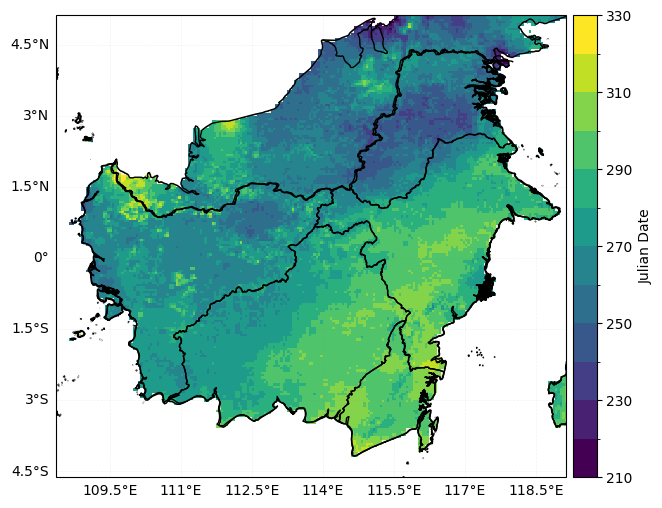

In [52]:
import geopandas as gpd
import xarray as xr
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import numpy as np
from matplotlib.colors import BoundaryNorm


# Load shapefile batas provinsi
shapefile_path = 'BATAS_PROVINSI_DESEMBER_2019_DUKCAPIL.shp'  # Ganti dengan path ke shapefile
gdf = gpd.read_file(shapefile_path)

# Proyeksikan shapefile ke Plate Carree jika belum dalam format yang sesuai
gdf = gdf.to_crs(ccrs.PlateCarree().proj4_init)

# Misal data_amh sudah dimuat sebelumnya
# Ekstrak latitude dan longitude
latitudes = data_amh.latitude
longitudes = data_amh.longitude


cmap = plt.cm.viridis
levels = np.arange(210, 340, 10)  # Batas warna per 10 unit dari -100 hingga 100
norm = BoundaryNorm(levels, ncolors=cmap.N, clip=True)

# Filter shapefile sesuai dengan batas longitude dan latitude dari dataset korelasi
lon_min, lon_max = np.min(longitudes), np.max(longitudes)
lat_min, lat_max = np.min(latitudes), np.max(latitudes)
gdf = gdf.cx[lon_min:lon_max, lat_min:lat_max]

# Buat figure dan axis menggunakan cartopy
fig = plt.figure(figsize=(10, 6))
ax = fig.add_subplot(1, 1, 1, projection=ccrs.PlateCarree())

# Set extent plot berdasarkan lon dan lat dari data korelasi
ax.set_extent([lon_min, lon_max, lat_min, lat_max], crs=ccrs.PlateCarree())

# Tambahkan fitur geografis
ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.BORDERS)
ax.add_feature(cfeature.LAND, edgecolor='black')
ax.add_feature(cfeature.OCEAN, facecolor='white')

# Plot data geospasial (misalnya data dari bulan pertama)
data_plot = data_amh  # pilih waktu pertama untuk plot

# Plot data menggunakan pcolormesh
mesh = ax.pcolormesh(longitudes, latitudes, data_plot, cmap='viridis', norm=norm, transform=ccrs.PlateCarree(), shading='auto')

# Tambahkan colorbar
cbar = plt.colorbar(mesh, orientation='vertical', pad=0.01)
cbar.set_label('Julian Date')

# Tambahkan gridlines
gl = ax.gridlines(draw_labels=True, linewidth=0.5, color='gray', alpha=0.1, linestyle='--')
gl.top_labels = False
gl.right_labels = False

# # Tambahkan garis batas sumbu manual (axes lines)
# ax.plot([longitudes.min(), longitudes.max()], [latitudes.min(), latitudes.min()], color='black', linewidth=1.5, transform=ccrs.PlateCarree())  # Garis horizontal bawah
# ax.plot([longitudes.min(), longitudes.max()], [latitudes.max(), latitudes.max()], color='black', linewidth=1.5, transform=ccrs.PlateCarree())  # Garis horizontal atas
# ax.plot([longitudes.min(), longitudes.min()], [latitudes.min(), latitudes.max()], color='black', linewidth=1.5, transform=ccrs.PlateCarree())  # Garis vertikal kiri
# ax.plot([longitudes.max(), longitudes.max()], [latitudes.min(), latitudes.max()], color='black', linewidth=1.5, transform=ccrs.PlateCarree())  # Garis vertikal kanan

# Plot batas provinsi
gdf.boundary.plot(ax=ax, linewidth=1, edgecolor='black')

# Set judul
# ax.set_title('Data AMH dengan ggplot Style', fontsize=15)

# Tampilkan plot
plt.show()


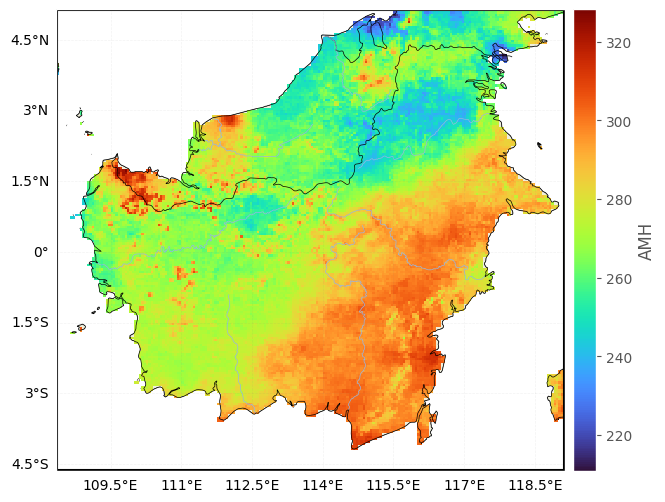

In [40]:
import xarray as xr
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature

# Gunakan style 'ggplot'
plt.style.use('ggplot')

# Ekstrak latitude dan longitude
latitudes = data_amh.latitude
longitudes = data_amh.longitude

# Buat figure dan axis menggunakan cartopy
fig = plt.figure(figsize=(10, 6))
ax = fig.add_subplot(1, 1, 1, projection=ccrs.PlateCarree())


# Tambahkan fitur geografis
ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.BORDERS)
ax.add_feature(cfeature.LAND, edgecolor='black')
ax.add_feature(cfeature.OCEAN, facecolor='white')
# ax.add_feature(cfeature.RIVERS, linewidth=0.5)



# Plot data geospasial (misalnya data dari bulan pertama)
data_plot = data_amh  # pilih waktu pertama untuk plot

# Plot data menggunakan pcolormesh
mesh = ax.pcolormesh(longitudes, latitudes, data_plot, cmap='viridis', transform=ccrs.PlateCarree(), shading='auto')

# Tambahkan colorbar
cbar = plt.colorbar(mesh, orientation='vertical', pad=0.01)
cbar.set_label('AMH')

# Tambahkan gridlines
gl = ax.gridlines(draw_labels=True, linewidth=0.5, color='gray', alpha=0.1, linestyle='--')
gl.top_labels = False
gl.right_labels = False

# Tambahkan garis batas sumbu manual (axes lines)
ax.plot([longitudes.min(), longitudes.max()], [latitudes.min(), latitudes.min()], color='black', linewidth=1.5, transform=ccrs.PlateCarree())  # Garis horizontal bawah
ax.plot([longitudes.min(), longitudes.max()], [latitudes.max(), latitudes.max()], color='black', linewidth=1.5, transform=ccrs.PlateCarree())  # Garis horizontal atas
ax.plot([longitudes.min(), longitudes.min()], [latitudes.min(), latitudes.max()], color='black', linewidth=1.5, transform=ccrs.PlateCarree())  # Garis vertikal kiri
ax.plot([longitudes.max(), longitudes.max()], [latitudes.min(), latitudes.max()], color='black', linewidth=1.5, transform=ccrs.PlateCarree())  # Garis vertikal kanan

# Set judul

# Set judul
# ax.set_title('Data AMH dengan ggplot Style', fontsize=15)

# Tampilkan plot
plt.show()


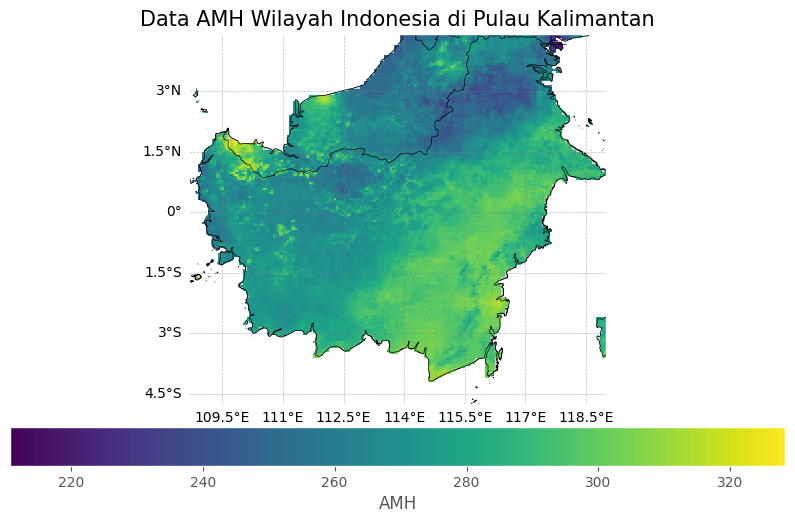

In [12]:
import geopandas as gpd
import xarray as xr
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from shapely.geometry import box

# Gunakan style 'ggplot'
plt.style.use('ggplot')



# Ekstrak latitude dan longitude
latitudes = data_amh.latitude
longitudes = data_amh.longitude

# Muat shapefile batas wilayah Indonesia
# Pastikan path file shapefile sudah benar
gdf = gpd.read_file("gadm36_IDN_1.shp")

# Filter hanya untuk Pulau Kalimantan (wilayah Indonesia)
kalimantan_indonesia = gdf[gdf['NAME_1'].str.contains('Kalimantan')]

# Buat bounding box untuk Pulau Kalimantan wilayah Indonesia
minx, miny, maxx, maxy = kalimantan_indonesia.total_bounds
bounding_box = box(minx, miny, maxx, maxy)

# Crop data AMH dengan bounding box
data_amh = data_amh.sel(longitude=slice(minx, maxx), latitude=slice(miny, maxy))

# Buat figure dan axis menggunakan cartopy
fig = plt.figure(figsize=(10, 6))
ax = fig.add_subplot(1, 1, 1, projection=ccrs.PlateCarree())

# Set extent untuk wilayah yang lebih spesifik
ax.set_extent([minx, maxx, miny, maxy], crs=ccrs.PlateCarree())

# Tambahkan fitur geografis
ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.BORDERS, linestyle='-', edgecolor='black')
ax.add_feature(cfeature.LAND, edgecolor='black', facecolor='lightgrey')
ax.add_feature(cfeature.OCEAN, facecolor='white')

# Tambahkan shapefile Indonesia
kalimantan_indonesia.plot(ax=ax, facecolor='none', edgecolor='black', linewidth=0.5)

# Plot data geospasial sebagai warna solid
data_plot = data_amh # Pilih waktu pertama untuk plot

# Plot data menggunakan pcolormesh
mesh = ax.pcolormesh(data_amh.longitude, data_amh.latitude, data_plot, cmap='viridis', transform=ccrs.PlateCarree(), shading='auto')

# Tambahkan colorbar
cbar = plt.colorbar(mesh, orientation='horizontal', pad=0.1)
cbar.set_label('AMH')

# Tambahkan gridlines
gl = ax.gridlines(draw_labels=True, linewidth=0.5, color='gray', alpha=0.5, linestyle='--')
gl.top_labels = False
gl.right_labels = False

# Set judul
ax.set_title('Data AMH Wilayah Indonesia di Pulau Kalimantan', fontsize=15)

# Tampilkan plot
plt.show()


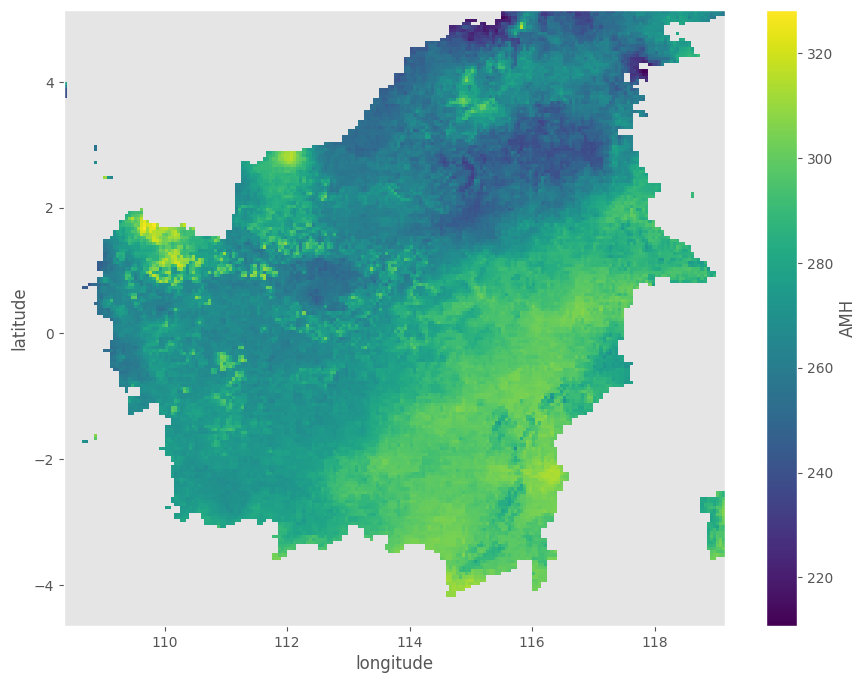

In [5]:
import matplotlib.pyplot as plt
plt.style.use('ggplot')
data_amh.plot(size=8)

In [19]:
import xarray as xr
import numpy as np
dataaslireal = xr.open_dataset('AMH_with_NAN.nc')
dataaslireal = dataaslireal['AMH']
mask_nan_var7 = np.isnan(dataaslireal)
datacfs = xr.open_dataset('predictedCFSMei.nc')
datacfs = datacfs['AMHp']
dataic3 = xr.open_dataset('predictedIC3Mei.nc')
dataic3 = dataic3['AMHp']
datacans = xr.open_dataset('predictedCansipsv2Mei.nc')
datacans = datacans['AMHp']

In [20]:
#CFS
datacfs = datacfs.values
datacfs[mask_nan_var7] = np.nan
datacfsp = xr.DataArray(
   data=datacfs,
   dims=["year", "latitude", "longitude"],
   coords={
       "year": dataaslireal['year'].values,
       "latitude": dataaslireal['latitude'].values,
       "longitude": dataaslireal['longitude'].values
   }
)
#IC3
dataic3 = dataic3.values
dataic3[mask_nan_var7] = np.nan
dataic3p = xr.DataArray(
   data=dataic3,
   dims=["year", "latitude", "longitude"],
   coords={
       "year": dataaslireal['year'].values,
       "latitude": dataaslireal['latitude'].values,
       "longitude": dataaslireal['longitude'].values
   }
)
#CanSIPSv2
datacans = datacans.values
datacans[mask_nan_var7] = np.nan
datacansp = xr.DataArray(
   data=datacans,
   dims=["year", "latitude", "longitude"],
   coords={
       "year": dataaslireal['year'].values,
       "latitude": dataaslireal['latitude'].values,
       "longitude": dataaslireal['longitude'].values
   }
)


datacfsp=datacfsp.mean(dim=['latitude', 'longitude'])
dataic3p=dataic3p.mean(dim=['latitude', 'longitude'])
datacansp=datacansp.mean(dim=['latitude', 'longitude'])
dataasli=dataaslireal.mean(dim=['latitude', 'longitude'])

datacfsp=datacfsp.values
dataic3p=dataic3p.values
datacansp=datacansp.values
dataasli=dataasli.values

datacfsp = datacfsp.reshape(-1)
dataic3p = dataic3p.reshape(-1)
datacansp = datacansp.reshape(-1)
dataas = dataasli.reshape(-1)

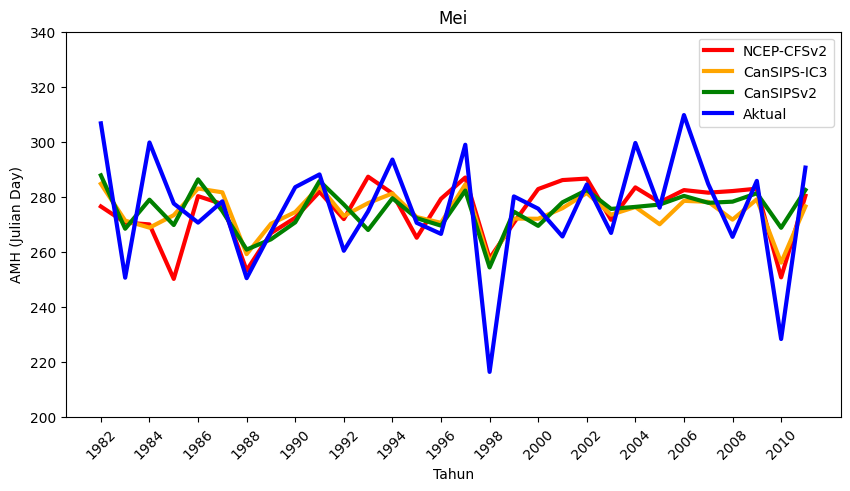

In [21]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

# Contoh data, silakan ganti dengan data Anda
tahun = np.arange(1982,2012)

# Plotting
plt.figure(figsize=(10, 5))
# plt.rcParams['figure.facecolor']= 'white'
# plt.rcParams['axes.facecolor']= 'white'
# plt.rcParams['savefig.facecolor']= 'white'
# plt.style.use['seaborn-white']
plt.plot(tahun, datacfsp, label='NCEP-CFSv2', color='red', linewidth=3)
plt.plot(tahun, dataic3p, label='CanSIPS-IC3', color='orange', linewidth=3)
plt.plot(tahun, datacansp, label='CanSIPSv2', color='green', linewidth=3)
plt.plot(tahun, dataas, label='Aktual', color='blue', linewidth=3)

# Penyesuaian tampilan
plt.xlabel('Tahun')
plt.ylabel('AMH (Julian Day)')
interval_tahun = tahun[::2] 
plt.xticks(interval_tahun, rotation=45)
plt.ylim(200,340)
plt.legend()

# Menampilkan grid
plt.grid(False)
plt.title('Mei')

# Menampilkan grafik
# plt.tight_layout()
plt.show()


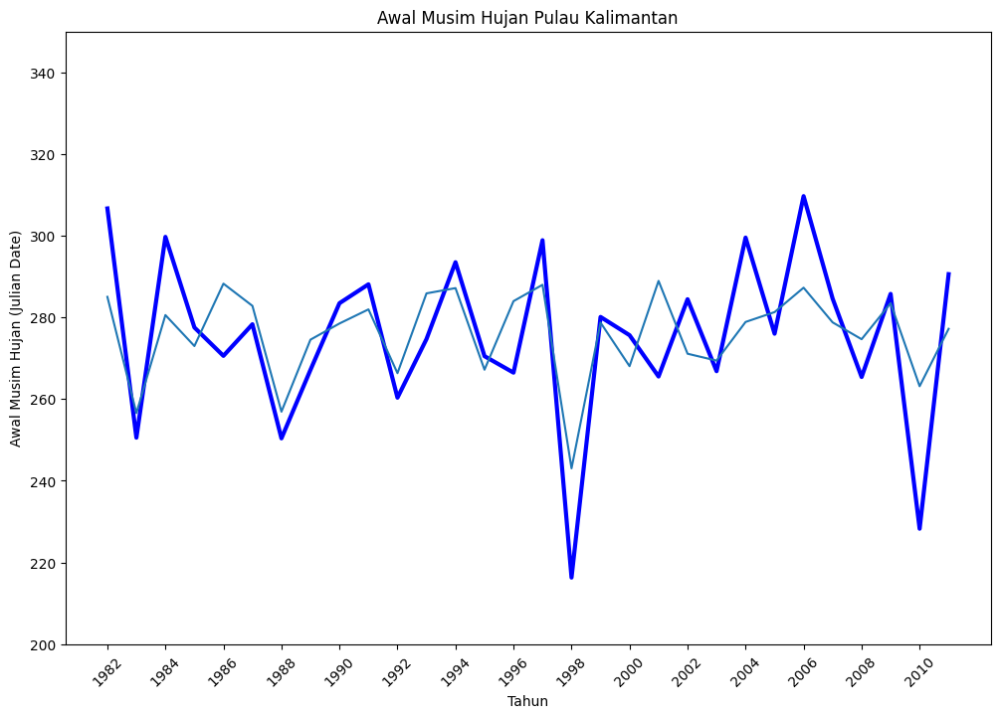

In [7]:
import matplotlib.pyplot as plt

# Contoh data, silakan ganti dengan data Anda
tahun = np.arange(1982,2012)
#See the model performance on test dataset
plt.rcParams['figure.figsize'] = (12,8)
plt.plot(tahun, dataasli, label='Awal Musim Hujan Aktual', color='blue', linewidth=3)
plt.plot(tahun, datapr, label='Prediksi Awal Musim Hujan')
# plt.legend(loc ="upper left")
plt.title('Awal Musim Hujan Pulau Kalimantan')
plt.xlabel('Tahun')
plt.ylabel('Awal Musim Hujan (Julian Date)')
interval_tahun = tahun[::2] 
plt.xticks(interval_tahun, rotation=45)
plt.ylim(200, 350)
plt.show()

In [ ]:
# Membaca file NetCDF
data = xr.open_dataset('CHIRPS_Kalimantan_1981_2023.nc')

# Menghitung rata-rata curah hujan di semua grid points
mean_precip = data['precip'][365:11322,:,:]
monthly_sum = mean_precip.groupby('time.month').sum(dim='time', skipna=True)
monthly_sum = monthly_sum.mean(dim=('latitude', 'longitude'))
monthly_sum1 = monthly_sum/30
# Plot grafik batang rata-rata bulanan
plt.figure(figsize=(10, 5))
plt.bar(monthly_sum1['month'], monthly_sum1)
plt.title('Rata-Rata Bulanan Curah Hujan Pulau Kalimantan')
plt.xlabel('Bulan')
plt.ylabel('Rata-rata Curah Hujan (mm/bulan)')
plt.grid(True)
plt.show()

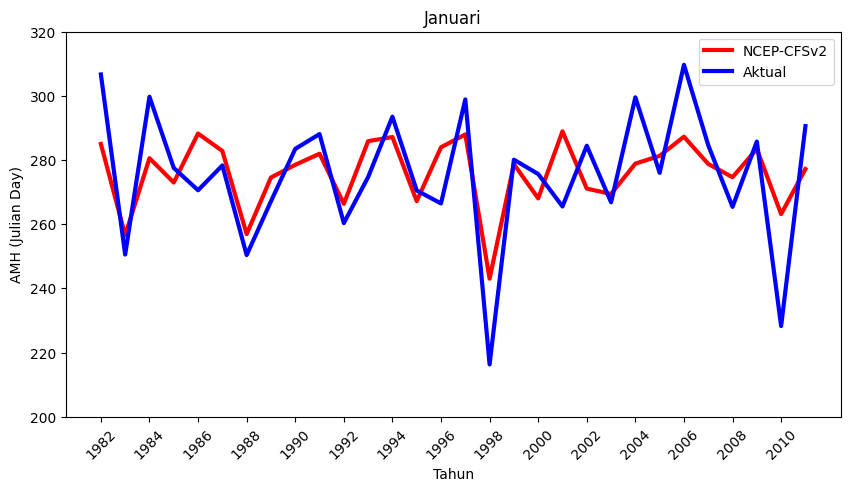

In [11]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

# Contoh data, silakan ganti dengan data Anda
tahun = np.arange(1982,2012)

# Plotting
plt.figure(figsize=(10, 5))
# plt.rcParams['figure.facecolor']= 'white'
# plt.rcParams['axes.facecolor']= 'white'
# plt.rcParams['savefig.facecolor']= 'white'
# plt.style.use['seaborn-white']
plt.plot(tahun, datapr, label='NCEP-CFSv2', color='red', linewidth=3)
plt.plot(tahun, dataas, label='Aktual', color='blue', linewidth=3)

# Penyesuaian tampilan
plt.xlabel('Tahun')
plt.ylabel('AMH (Julian Day)')
interval_tahun = tahun[::2] 
plt.xticks(interval_tahun, rotation=45)
plt.ylim(200,320)
plt.legend()

# Menampilkan grid
plt.grid(False)
plt.title('Januari')

# Menampilkan grafik
# plt.tight_layout()
plt.show()


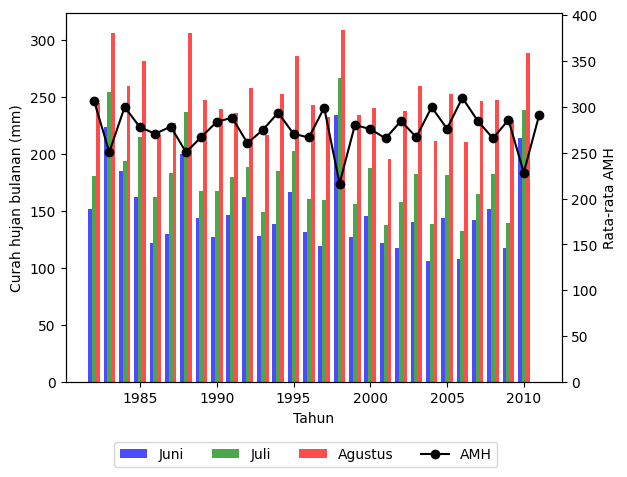

In [15]:
import xarray as xr
import numpy as np
import matplotlib.pyplot as plt

# Load data dari file NetCDF
dataCFS = xr.open_dataset('New_CFSFebruari.nc')
dataAMH = xr.open_dataset('AMH_with_NAN.nc')

# Ambil data untuk 30 hari pertama
CFSjuni = dataCFS['Agustus'][:30,:,:]
CFSjuli = dataCFS['September'][:30,:,:]
CFSagustus = dataCFS['Oktober'][:30,:,:]
dataAMH = dataAMH['AMH']
chcfs = CFSjuni+CFSjuli+CFSagustus
# x = chcfs.mean(dim=['latitude', 'longitude']).values

# Hitung rata-rata AMH
y = dataAMH.mean(dim=['latitude', 'longitude']).values

# # Ambil data untuk 30 hari pertama
# CFSjuni = dataCFS['Juni'][:30,:,:]
# CFSjuli = dataCFS['Juli'][:30,:,:]
# CFSagustus = dataCFS['Agustus'][:30,:,:]
# dataAMH = dataAMH['AMH']

# Hitung rata-rata per bulan
avg_juni = CFSjuni.mean(dim=['latitude', 'longitude']).values
avg_juli = CFSjuli.mean(dim=['latitude', 'longitude']).values
avg_agustus = CFSagustus.mean(dim=['latitude', 'longitude']).values

# # Hitung rata-rata AMH
# avg_amh = dataAMH.mean(dim=['latitude', 'longitude']).values

# Buat array untuk x-axis
tahun = np.arange(1982, 2012)

# Buat plot
fig, ax1 = plt.subplots()

# Grafik batang untuk bulan Juni, Juli, Agustus
width = 0.25  # Lebar batang
ax1.bar(tahun - width, avg_juni, width, label='Juni', color='b', alpha=0.7)
ax1.bar(tahun, avg_juli, width, label='Juli', color='g', alpha=0.7)
ax1.bar(tahun + width, avg_agustus, width, label='Agustus', color='r', alpha=0.7)

# Konfigurasi untuk sumbu y pertama
ax1.set_xlabel('Tahun')
ax1.set_ylabel('Curah hujan bulanan (mm)', color='k')
ax1.tick_params(axis='y', labelcolor='k')
# ax1.set_ylim(0, 300) 
# ax1.legend(loc='upper left')

# Sumbu y kedua untuk data AMH
ax2 = ax1.twinx()
ax2.plot(tahun, y, label='AMH', color='black', linestyle='-', marker='o')
ax2.set_ylabel('Rata-rata AMH', color='k')
ax2.tick_params(axis='y', labelcolor='k')
ax2.set_ylim(0, max(y) * 1.3) 
# ax2.legend(loc='upper right')

fig.legend(loc = 'upper center', bbox_to_anchor=(0.5,-0.00005),  ncol=4 )
# Tambahkan judul dan grid
# plt.title('')
ax1.grid(False)
ax2.grid(False)

# Tampilkan plot
plt.show()


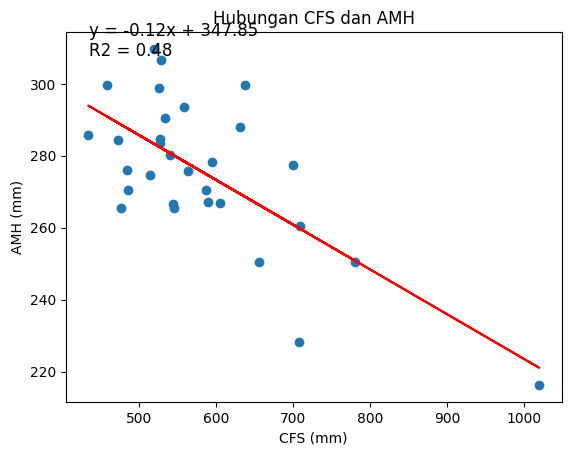

In [3]:
import xarray as xr
import numpy as np
import matplotlib.pyplot as plt


dataCFS = xr.open_dataset('New_CFSFebruari.nc')
dataAMH = xr.open_dataset('AMH_with_NAN.nc')

# Ambil data untuk 30 hari pertama
CFSjuni = dataCFS['Agustus'][:30,:,:]
CFSjuli = dataCFS['September'][:30,:,:]
CFSagustus = dataCFS['Oktober'][:30,:,:]
# Load data dari file NetCDF
dataCFSJ = xr.open_dataset('CFSFebruari.nc')
dataAMH = xr.open_dataset('AMH_with_NAN.nc')

# Ambil data untuk 30 hari pertama
# CFSjuni = dataCFS['TJuni'][:30,:,:]
CFSjuliJ = dataCFSJ['Juli'][:30,:,:]
# CFSagustus = dataCFS['TAgustus'][:30,:,:]
dataAMH = dataAMH['AMH']
chcfs = CFSjuliJ+CFSjuni+CFSjuli+CFSagustus
# x = chcfs.mean(dim='year').values
x = chcfs.mean(dim=['latitude', 'longitude']).values
# x = x.reshape(-1)

# Hitung rata-rata AMH
y = dataAMH.mean(dim='year').values
y = dataAMH.mean(dim=['latitude', 'longitude']).values
# y = y.reshape(-1)

plt.scatter(x,y)
coefficients = np.polyfit(x,y,1)
slope, intercept = coefficients
y_pred = slope*x + intercept
ss_total = np.sum((y - np.mean(y))**2)
ss_res = np.sum((y - y_pred)**2)
r2 = 1 - (ss_res / ss_total)
equation_text = f'y = {slope:.2f}x + {intercept:.2f}\nR2 = {r2:.2f}'
plt.text(min(x)+0.5,max(y)-2, equation_text,fontsize=12, color='black')
plt.plot(x, y_pred, 'r')
# plt.legend()
plt.xlabel('CFS (mm)')
plt.ylabel('AMH (mm)')
plt.title('Hubungan CFS dan AMH')
plt.show()

In [55]:
import xarray as xr
import numpy as np
import matplotlib.pyplot as plt

# Load data dari file NetCDF
rainfall_data = xr.open_dataset('CHIRPS_Kalimantan_1981_2023.nc')
data_monthly = rainfall_data.resample(time='ME').sum(dim='time')
# Ekstraksi data untuk bulan September, Oktober, dan November
rainfall_januari = data_monthly.sel(time=data_monthly['time.month'] == 1)['precip']
rainfall_februari = data_monthly.sel(time=data_monthly['time.month'] == 2)['precip']
rainfall_maret = data_monthly.sel(time=data_monthly['time.month'] == 3)['precip']
rainfall_april = data_monthly.sel(time=data_monthly['time.month'] == 4)['precip']
rainfall_mei = data_monthly.sel(time=data_monthly['time.month'] == 5)['precip']
rainfall_juni = data_monthly.sel(time=data_monthly['time.month'] == 6)['precip']
rainfall_juli = data_monthly.sel(time=data_monthly['time.month'] == 7)['precip']
rainfall_agustus = data_monthly.sel(time=data_monthly['time.month'] == 8)['precip']
rainfall_september = data_monthly.sel(time=data_monthly['time.month'] == 9)['precip']
rainfall_oktober = data_monthly.sel(time=data_monthly['time.month'] == 10)['precip']
rainfall_november = data_monthly.sel(time=data_monthly['time.month'] == 11)['precip']
rainfall_desember = data_monthly.sel(time=data_monthly['time.month'] == 12)['precip']

rainfall_januari = rainfall_januari.groupby('time.year').mean()
rainfall_februari = rainfall_februari.groupby('time.year').mean()
rainfall_maret = rainfall_maret.groupby('time.year').mean()
rainfall_april = rainfall_april.groupby('time.year').mean()
rainfall_mei = rainfall_mei.groupby('time.year').mean()
rainfall_juni=rainfall_juni.groupby('time.year').mean()
rainfall_juli=rainfall_juli.groupby('time.year').mean()
rainfall_agustus=rainfall_agustus.groupby('time.year').mean()
rainfall_september = rainfall_september.groupby('time.year').mean()
rainfall_oktober = rainfall_oktober.groupby('time.year').mean()
rainfall_november = rainfall_november.groupby('time.year').mean()
rainfall_desember = rainfall_desember.groupby('time.year').mean()

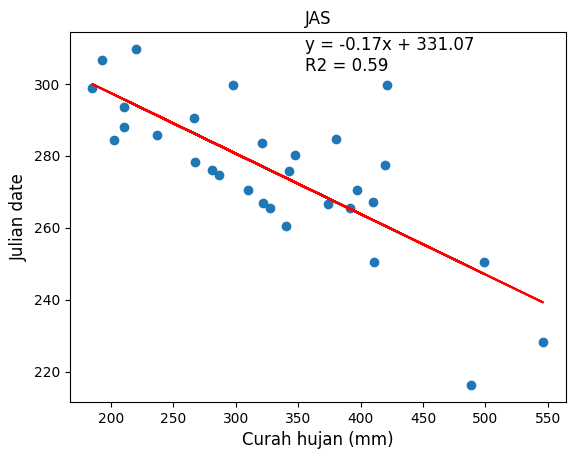

In [65]:
dataAMH = xr.open_dataset('AMH_with_NAN.nc')
dataAMH = dataAMH['AMH']
januari = rainfall_januari[1:31,:,:]
februari = rainfall_februari[1:31,:,:]
maret = rainfall_maret[1:31,:,:]
april = rainfall_april[1:31,:,:]
mei = rainfall_mei[1:31,:,:]
juni = rainfall_juni[1:31,:,:]
juli = rainfall_juli[1:31,:,:]
agustus = rainfall_agustus[1:31,:,:]
september = rainfall_september[1:31,:,:]
oktober = rainfall_oktober[1:31,:,:]
november = rainfall_november[1:31,:,:]
desember = rainfall_desember[1:31,:,:]
JJA = juli+agustus+september
x = JJA.mean(dim=['latitude', 'longitude']).values
y = dataAMH.mean(dim=['latitude', 'longitude']).values

plt.scatter(x,y)
coefficients = np.polyfit(x,y,1)
slope, intercept = coefficients
y_pred = slope*x + intercept
ss_total = np.sum((y - np.mean(y))**2)
ss_res = np.sum((y - y_pred)**2)
r2 = 1 - (ss_res / ss_total)
equation_text = f'y = {slope:.2f}x + {intercept:.2f}\nR2 = {r2:.2f}'
plt.text(min(x)+170.5,max(y)-6, equation_text,fontsize=12, color='black')
plt.plot(x, y_pred, 'r')
# plt.legend()
plt.xlabel('Curah hujan (mm)', fontsize=12)
plt.ylabel('Julian date', fontsize=12)
plt.title('JAS')
plt.show()

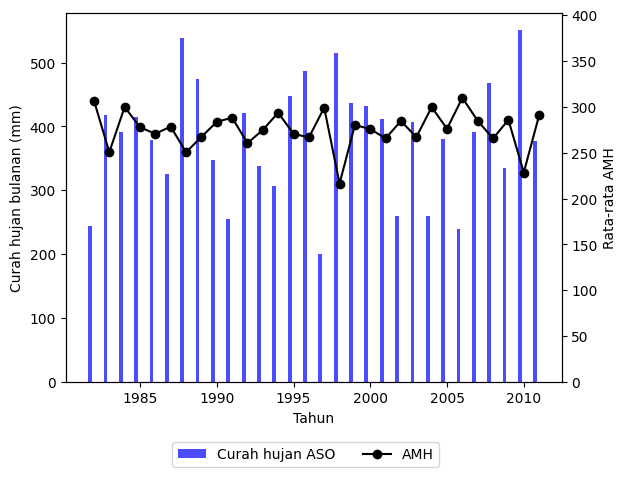

In [58]:
# Buat array untuk x-axis
tahun = np.arange(1982, 2012)

# Buat plot
fig, ax1 = plt.subplots()

# Grafik batang untuk bulan Juni, Juli, Agustus
width = 0.25  # Lebar batang
ax1.bar(tahun - width, x, width, label='Curah hujan ASO', color='b', alpha=0.7)
# ax1.bar(tahun, avg_juli, width, label='Juli', color='g', alpha=0.7)
# ax1.bar(tahun + width, avg_agustus, width, label='Agustus', color='r', alpha=0.7)

# Konfigurasi untuk sumbu y pertama
ax1.set_xlabel('Tahun')
ax1.set_ylabel('Curah hujan bulanan (mm)', color='k')
ax1.tick_params(axis='y', labelcolor='k')
# ax1.set_ylim(0, 300) 
# ax1.legend(loc='upper left')

# Sumbu y kedua untuk data AMH
ax2 = ax1.twinx()
ax2.plot(tahun, y, label='AMH', color='black', linestyle='-', marker='o')
ax2.set_ylabel('Rata-rata AMH', color='k')
ax2.tick_params(axis='y', labelcolor='k')
ax2.set_ylim(0, max(y) * 1.3) 
# ax2.legend(loc='upper right')

fig.legend(loc = 'upper center', bbox_to_anchor=(0.5,-0.00005),  ncol=4 )
# Tambahkan judul dan grid
# plt.title('')
ax1.grid(False)
ax2.grid(False)

# Tampilkan plot
plt.show()

Olah Hasil Model

In [43]:
data = xr.open_dataset('AMH_with_NAN.nc')

mask_test = data['AMH']
mask_nan = np.isnan(mask_test)

Text(0, 0.5, 'Latitude')

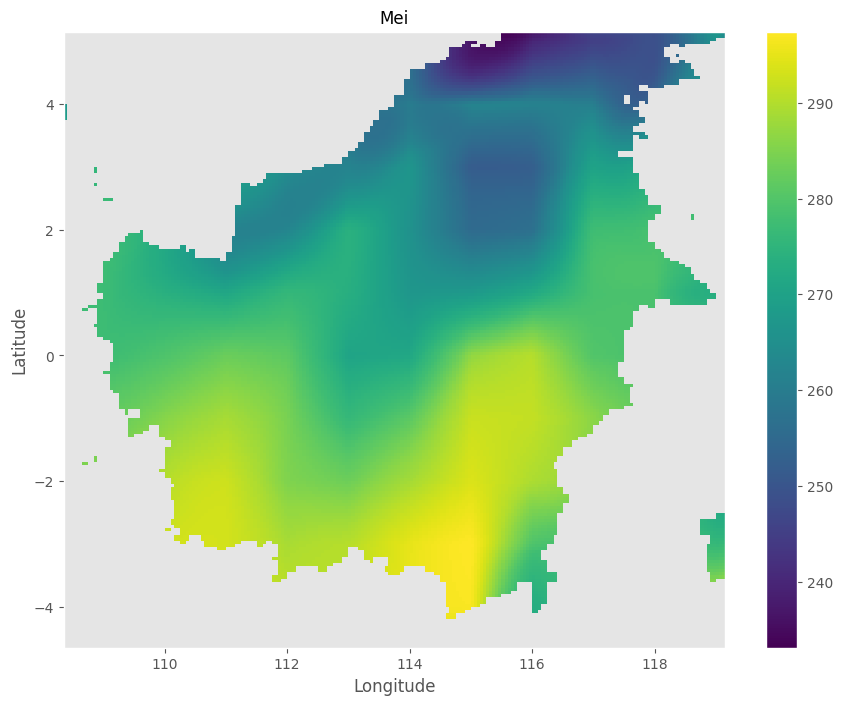

In [40]:
from sklearn.metrics import mean_squared_error, r2_score
from scipy.stats import pearsonr
import numpy as np
import xarray as xr
import pandas as pd
import matplotlib.pyplot as plt

data_predik = xr.open_dataset('predictedCFSMei.nc')
# data_predik = xr.open_dataset('predictedIC3Mei.nc')
# data_predik = xr.open_dataset('predictedCansipsv2Mei.nc')
data_predik = data_predik['AMHp'].values
data_predik[mask_nan] = np.nan
data_aktu = xr.open_dataset('AMH_with_NAN.nc')
dataprediksi = xr.DataArray(
   data=data_predik,
   dims=["year", "latitude", "longitude"],
   coords={
       "year": data_aktu['year'].values,
       "latitude": data_aktu['latitude'].values,
       "longitude": data_aktu['longitude'].values
   }
)
data_predik_peta = dataprediksi.mean(dim='year')
plt.style.use('ggplot')
data_predik_peta.plot(size=8)
plt.title('Mei', fontsize=12)
plt.xlabel('Longitude', fontsize=12)
plt.ylabel('Latitude', fontsize=12)


In [47]:
Datauji = xr.open_dataset('predictedCFSJanuariFix.nc')
Dataaktual = xr.open_dataset('AMH_with_Median.nc')
predictions_denormalized = Datauji['AMHp'].values
y_test_denormalized = Dataaktual['AMH'].values

rmse = np.sqrt(mean_squared_error(y_test_denormalized.flatten(), predictions_denormalized.flatten()))
r2 = r2_score(y_test_denormalized.flatten(), predictions_denormalized.flatten())
correlation_coefficient, _ = pearsonr(y_test_denormalized.flatten(), predictions_denormalized.flatten())

# Calculate MAPE using the filtered data
# mape = mean_absolute_percentage_error(y_test_denormalized.flatten(), predictions_denormalized.flatten())


print(f'RMSE: {rmse}')
print(f'R^2: {r2}')
print(f'Pearson Correlation Coefficient: {correlation_coefficient}')
# print(f'MAPE:{mape*100}%')

RMSE: 24.28775476451572
R^2: 0.2595410338144254
Pearson Correlation Coefficient: 0.5097810018905297


In [85]:
import xarray as xr
import numpy as np
from sklearn.metrics import mean_squared_error

from scipy.stats import pearsonr

# Muat data observasi
data_observasi = xr.open_dataset('AMH_
                                 .nc')

# Ganti dengan nama variabel yang sesuai dari dataset observasi
observasi_var = data_observasi['AMH']  # Ganti dengan nama variabel aktual

# Muat data prediksi, pastikan file dan variabel sudah benar
data_prediksi = xr.open_dataset('predictedCansipsv2April.nc')  # Ganti dengan path ke file data prediksi Anda
prediksi_var = data_prediksi['AMHp']  # Ganti dengan nama variabel prediksi

# Membuat array kosong untuk menyimpan hasil RMSE dan koefisien korelasi
rmse_grid = np.zeros((observasi_var.shape[1], observasi_var.shape[2]))
corr_grid = np.zeros((observasi_var.shape[1], observasi_var.shape[2]))

# Iterasi melalui setiap grid (latitude, longitude)
for i in range(observasi_var.shape[1]):  # Iterasi melalui latitude
    for j in range(observasi_var.shape[2]):  # Iterasi melalui longitude
        obs = observasi_var[:, i, j].values  # Mengambil data observasi sepanjang tahun untuk grid saat ini
        pred = prediksi_var[:, i, j].values  # Mengambil data prediksi sepanjang tahun untuk grid saat ini
        
        # Menghitung RMSE
        rmse = np.sqrt(mean_squared_error(obs, pred))

        # Menghitung koefisien korelasi
        if np.std(obs) == 0 or np.std(pred) == 0:
            corr = np.nan  # Menghindari pembagian dengan nol
        else:
            corr, _ = pearsonr(obs, pred)

        # Menyimpan hasil
        rmse_grid[i, j] = rmse
        corr_grid[i, j] = corr 

# Membuat dataset baru untuk menyimpan hasil
result_ds = xr.Dataset({
    'rmse': (['latitude', 'longitude'], rmse_grid),
    'correlation': (['latitude', 'longitude'], corr_grid)
}, coords={'latitude': data_observasi.latitude, 'longitude': data_observasi.longitude})

# Menyimpan hasil ke file baru
# result_ds.to_netcdf('/mnt/data/evaluation_results.nc')

# Output hasil untuk melihat sekilas



In [76]:
result_ds

<xarray.Dataset> Size: 681kB
Dimensions:      (latitude: 196, longitude: 216)
Coordinates:
  * latitude     (latitude) float64 2kB -4.625 -4.575 -4.525 ... 5.075 5.125
  * longitude    (longitude) float64 2kB 108.4 108.4 108.5 ... 119.0 119.1 119.1
Data variables:
    rmse         (latitude, longitude) float64 339kB 1.432 1.432 ... 51.2 41.5
    correlation  (latitude, longitude) float64 339kB nan nan ... 0.02797 0.1096

In [86]:
dataaslireal = xr.open_dataset('AMH_with_NAN.nc')
mask = dataaslireal['AMH'][1,:,:]
mask_nan_var7 = np.isnan(mask)
rmse = result_ds['rmse'].values
rmse[mask_nan_var7] = np.nan


Text(0, 0.5, 'Latitude')

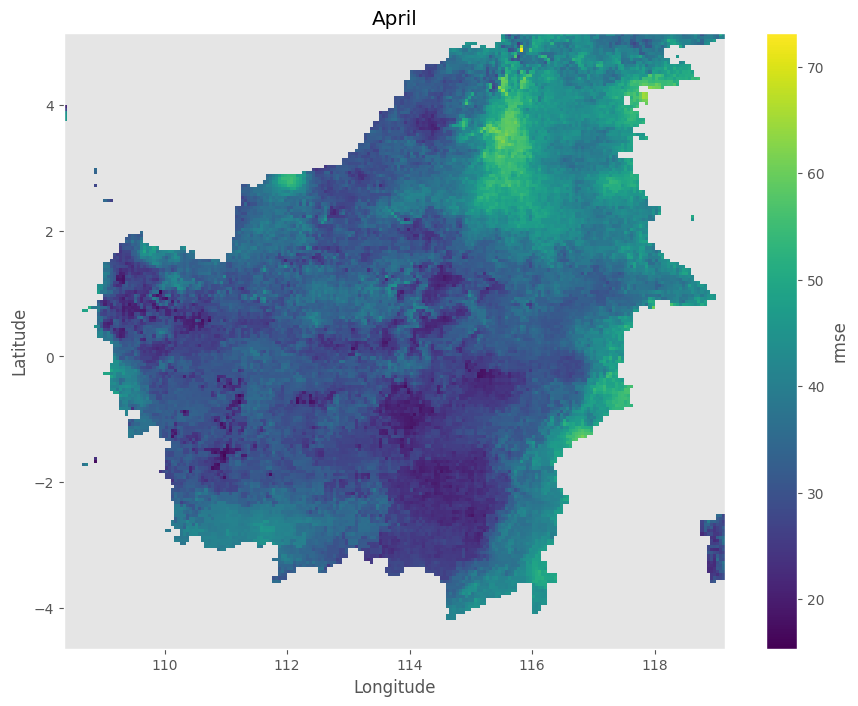

In [88]:
plt.style.use('ggplot')
result_ds['rmse'].plot(size=8)
plt.title('April')
plt.xlabel('Longitude')
plt.ylabel('Latitude')

In [ ]:
import xarray as xr

# Muat dataset observasi dan prediksi
data_observasi = xr.open_dataset('AMH_with_Median.nc')
data_prediksi1 = xr.open_dataset('predictedCFSJanuari.nc')
data_prediksi2 = xr.open_dataset('predictedCFSFebruari.nc')  # Ganti dengan file model prediksi kedua
data_prediksi3 = xr.open_dataset('predictedCFSMaret.nc')  # Ganti dengan file model prediksi ketiga
data_prediksi4 = xr.open_dataset('predictedCFSApril.nc')
data_prediksi5 = xr.open_dataset('predictedCFSMei.nc')
data_prediksi6 = xr.open_dataset('predictedIC3Januari.nc')
data_prediksi7 = xr.open_dataset('predictedIC3Februari.nc')  # Ganti dengan file model prediksi kedua
data_prediksi8 = xr.open_dataset('predictedIC3Maret.nc')  # Ganti dengan file model prediksi ketiga
data_prediksi9 = xr.open_dataset('predictedIC3April.nc')
data_prediksi10 = xr.open_dataset('predictedIC3Mei.nc')
data_prediksi11 = xr.open_dataset('predictedCansipsv2Januari.nc')
data_prediksi12 = xr.open_dataset('predictedCansipsv2Februari.nc')  # Ganti dengan file model prediksi kedua
data_prediksi13 = xr.open_dataset('predictedCansipsv2Maret.nc')  # Ganti dengan file model prediksi ketiga
data_prediksi14 = xr.open_dataset('predictedCansipsv2April.nc')
data_prediksi15 = xr.open_dataset('predictedCansipsv2Mei.nc')


# Sesuaikan dengan variabel dari dataset
obs_var = data_observasi['AMH']
pred_var1 = data_prediksi1['AMHp']
pred_var2 = data_prediksi2['AMHp']
pred_var3 = data_prediksi3['AMHp']
pred_var4 = data_prediksi4['AMHp']
pred_var5 = data_prediksi5['AMHp']
pred_var6 = data_prediksi6['AMHp']
pred_var7 = data_prediksi7['AMHp']
pred_var8 = data_prediksi8['AMHp']
pred_var9 = data_prediksi9['AMHp']
pred_var10 = data_prediksi10['AMHp']
pred_var11 = data_prediksi11['AMHp']
pred_var12 = data_prediksi12['AMHp']
pred_var13 = data_prediksi13['AMHp']
pred_var14 = data_prediksi14['AMHp']
pred_var15 = data_prediksi15['AMHp']

In [1]:
import xarray as xr

# Muat dataset observasi
data_observasi = xr.open_dataset('AMH_with_Median.nc')
obs_var = data_observasi['AMH']

# Muat dataset prediksi untuk beberapa bulan
# data_prediksi1 = xr.open_dataset('predictedCFSJanuariFix.nc')
# data_prediksi2 = xr.open_dataset('predictedCFSFebruari.nc')
# data_prediksi3 = xr.open_dataset('predictedCFSMaret.nc')
# data_prediksi4 = xr.open_dataset('predictedCFSApril.nc')
# data_prediksi5 = xr.open_dataset('predictedCFSMei.nc')
# data_prediksi6 = xr.open_dataset('predictedIC3Januari.nc')
# data_prediksi7 = xr.open_dataset('predictedIC3Februari.nc')
# data_prediksi8 = xr.open_dataset('predictedIC3Maret.nc')
# data_prediksi9 = xr.open_dataset('predictedIC3April.nc')
# data_prediksi10 = xr.open_dataset('predictedIC3Mei.nc')
# data_prediksi11 = xr.open_dataset('predictedCansipsv2Januari.nc')
# data_prediksi12 = xr.open_dataset('predictedCansipsv2Februari.nc')
# data_prediksi13 = xr.open_dataset('predictedCansipsv2Maret.nc')
# data_prediksi14 = xr.open_dataset('predictedCansipsv2April.nc')
# data_prediksi15 = xr.open_dataset('predictedCansipsv2Mei.nc')

data_prediksi1 = xr.open_dataset('PreASO_CFSJanuari.nc')
data_prediksi2 = xr.open_dataset('PreASO_CFSFebruari.nc')
data_prediksi3 = xr.open_dataset('PreASO_CFSMaret.nc')
data_prediksi4 = xr.open_dataset('PreASO_CFSApril.nc')
data_prediksi5 = xr.open_dataset('PreASO_CFSMei.nc')
data_prediksi6 = xr.open_dataset('PreASO_IC3Januari.nc')
data_prediksi7 = xr.open_dataset('PreASO_IC3Februari.nc')
data_prediksi8 = xr.open_dataset('PreASO_IC3Maret.nc')
data_prediksi9 = xr.open_dataset('PreASO_IC3April.nc')
data_prediksi10 = xr.open_dataset('PreASO_IC3Mei.nc')
data_prediksi11 = xr.open_dataset('PreASO_Cansipv2Januari.nc')
data_prediksi12 = xr.open_dataset('PreASO_Cansipv2Februari.nc')
data_prediksi13 = xr.open_dataset('PreASO_Cansipv2Maret.nc')
data_prediksi14 = xr.open_dataset('PreASO_Cansipv2April.nc')
data_prediksi15 = xr.open_dataset('PreASO_Cansipv2Mei.nc')

# Sesuaikan dengan variabel dari dataset prediksi
pred_vars = [data_prediksi1['AMHp'], data_prediksi2['AMHp'], data_prediksi3['AMHp'],
             data_prediksi4['AMHp'], data_prediksi5['AMHp'], data_prediksi6['AMHp'],
             data_prediksi7['AMHp'], data_prediksi8['AMHp'], data_prediksi9['AMHp'],
             data_prediksi10['AMHp'], data_prediksi11['AMHp'], data_prediksi12['AMHp'],
             data_prediksi13['AMHp'], data_prediksi14['AMHp'], data_prediksi15['AMHp']]


import numpy as np
from scipy.stats import pearsonr

# Fungsi untuk menghitung korelasi Pearson
def calculate_correlation(obs, pred):
    if np.any(np.isnan(obs)) or np.any(np.isnan(pred)):
        return np.nan
    else:
        return pearsonr(obs, pred)[0]

# Tentukan dimensi dan koordinat
latitudes = obs_var['latitude']
longitudes = obs_var['longitude']

# Buat array untuk menyimpan hasil korelasi
correlation_maps = [np.zeros((len(latitudes), len(longitudes))) for _ in range(15)]

# Hitung korelasi untuk setiap bulan
for idx, pred_var in enumerate(pred_vars):
    for i in range(len(latitudes)):
        for j in range(len(longitudes)):
            obs_data = obs_var[:, i, j].values
            pred_data = pred_var[:, i, j].values
            correlation_maps[idx][i, j] = calculate_correlation(obs_data, pred_data)


C:\Users\ASUS\AppData\Local\Temp\ipykernel_14464\3629586762.py:56: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  return pearsonr(obs, pred)[0]


In [2]:
import xarray as xr
import numpy as np

# Anggap data observasi dan data prediksi sudah di-load seperti sebelumnya

# Definisikan koordinat
latitudes = obs_var['latitude']
longitudes = obs_var['longitude']
months = ['Januari', 'Februari', 'Maret', 'April', 'Mei']

# Buat data array untuk korelasi, dengan bentuk [bulan, latitude, longitude]
correlation_data = np.stack(correlation_maps).reshape((15, len(latitudes), len(longitudes)))

# Buat dataset xarray
correlation_dataset = xr.Dataset(
    {
        'correlation': (['month', 'latitude', 'longitude'], correlation_data)
    },
    coords={
        'month': months * 3,  # 15 bulan karena 3 model (5 bulan per model)
        'latitude': latitudes,
        'longitude': longitudes
    }
)

# Simpan dataset ke file NetCDF
correlation_dataset.to_netcdf('correlation_results_ASO.nc')

print("Hasil korelasi telah disimpan ke 'correlation_results.nc'")


Hasil korelasi telah disimpan ke 'correlation_results.nc'


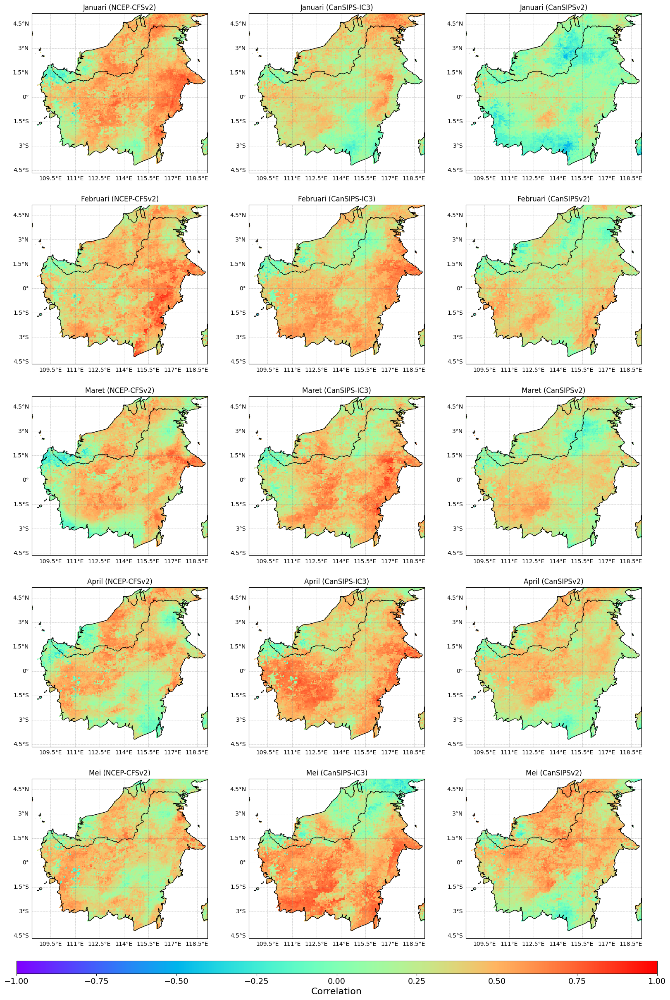

In [3]:
import xarray as xr
import numpy as np
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature

# Muat dataset hasil korelasi
correlation_dataset = xr.open_dataset('correlation_results.nc')

# Ekstrak data dari dataset
latitude = correlation_dataset.latitude.values
longitude = correlation_dataset.longitude.values
months = correlation_dataset.month.values
correlation_data = correlation_dataset.correlation.values

# Tentukan model untuk visualisasi
num_models = 3
num_months = 5
model_names = ["NCEP-CFSv2", "CanSIPS-IC3", "CanSIPSv2"]

# Buat figure dan axes untuk subplot
# fig, axes = plt.subplots(num_months, num_models, figsize=(30, 25), subplot_kw={'projection': ccrs.PlateCarree()})

# Buat figure dan axes untuk subplot dengan jarak antar subplot yang lebih kecil
fig, axes = plt.subplots(num_months, num_models, figsize=(20, 35), subplot_kw={'projection': ccrs.PlateCarree()}, 
                         gridspec_kw={'hspace': 0.2, 'wspace': 0.05})


# Atur warna dan batas warna
cmap = plt.cm.RdBu_r 
vmin, vmax = -1, 1

# Iterasi melalui setiap bulan dan model
for i, month in enumerate(months):
    row = i % num_months
    col = i // num_months
    ax = axes[row, col]

    # Plot korelasi untuk setiap model dan bulan
    correlation = correlation_data[i, :, :]  # Mengambil data untuk bulan tertentu
    
    # Menambahkan data pada peta
    mesh = ax.pcolormesh(longitude, latitude, correlation, cmap='rainbow', vmin=vmin, vmax=vmax, shading='auto', transform=ccrs.PlateCarree())
    
    # Menambahkan fitur geografis
    ax.add_feature(cfeature.COASTLINE)
    ax.add_feature(cfeature.BORDERS)
    ax.add_feature(cfeature.LAND, edgecolor='black')
    ax.add_feature(cfeature.OCEAN, facecolor='white')
    
    # Menambahkan gridline dan label
    gl = ax.gridlines(draw_labels=True, linewidth=0.5, color='gray', alpha=0.5, linestyle='--')
    gl.top_labels = False
    gl.right_labels = False
    
    # Tambahkan label bulan dan model
    ax.set_title(f'{month} ({model_names[col]})', fontsize=12)


# Sesuaikan layout subplot secara manual
plt.subplots_adjust(wspace=0.001, hspace=0.001)

# Tambahkan colorbar di bawah subplot
cbar = fig.colorbar(mesh, ax=axes.ravel().tolist(), orientation='horizontal', pad=0.02, aspect=50)
cbar.set_label('Correlation', fontsize=16)
# Perbesar teks pada colorbar
cbar.ax.tick_params(labelsize=14)

# Sesuaikan layout dan simpan gambar
# plt.tight_layout()
# plt.savefig('correlation_maps_cartopy.png', dpi=300, bbox_inches='tight')
plt.show()

# print("Visualisasi korelasi telah disimpan ke 'correlation_maps_cartopy.png'")


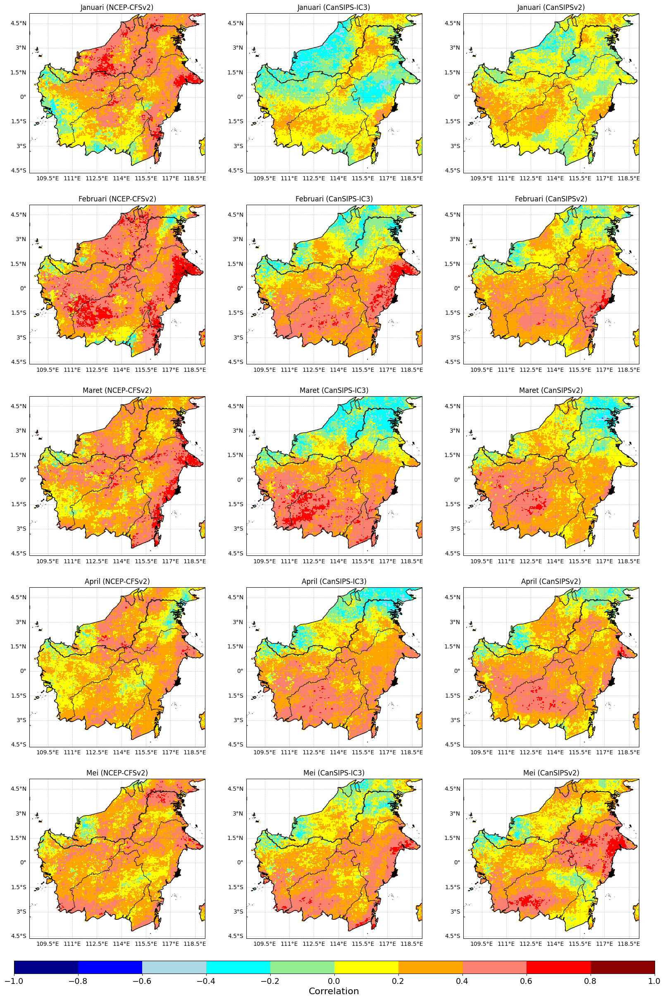

In [3]:
import xarray as xr
import numpy as np
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import geopandas as gpd
import matplotlib.colors as mcolors

# Muat dataset hasil korelasi
correlation_dataset = xr.open_dataset('correlation_results_ASO.nc')

# Ekstrak data dari dataset
latitude = correlation_dataset.latitude.values
longitude = correlation_dataset.longitude.values
months = correlation_dataset.month.values
correlation_data = correlation_dataset.correlation.values

# Tentukan model untuk visualisasi
num_models = 3
num_months = 5
model_names = ["NCEP-CFSv2", "CanSIPS-IC3", "CanSIPSv2"]

# Buat figure dan axes untuk subplot dengan bingkai yang disesuaikan
fig, axes = plt.subplots(num_months, num_models, figsize=(20, 35), subplot_kw={'projection': ccrs.PlateCarree()},
                         gridspec_kw={'hspace': 0.2, 'wspace': 0.05})

# Atur warna dan batas warna
# Buat peta warna diskret yang memberikan batas jelas antara nilai negatif dan positif
colors = ['darkblue', 'blue', 'lightblue', 'cyan', 'lightgreen', 'yellow', 'orange', 'salmon', 'red', 'darkred']
cmap = mcolors.ListedColormap(colors)
bounds = [-1, -0.8, -0.6, -0.4, -0.2, 0, 0.2, 0.4, 0.6, 0.8, 1]
norm = mcolors.BoundaryNorm(bounds, cmap.N)

# Load shapefile batas provinsi
shapefile_path = 'BATAS_PROVINSI_DESEMBER_2019_DUKCAPIL.shp'  # Ganti dengan path ke shapefile
gdf = gpd.read_file(shapefile_path)

# Filter shapefile sesuai dengan batas longitude dan latitude dari dataset korelasi
lon_min, lon_max = np.min(longitude), np.max(longitude)
lat_min, lat_max = np.min(latitude), np.max(latitude)
gdf = gdf.cx[lon_min:lon_max, lat_min:lat_max]

# Proyeksikan shapefile ke Plate Carree jika belum dalam format yang sesuai
gdf = gdf.to_crs(ccrs.PlateCarree().proj4_init)

# Iterasi melalui setiap bulan dan model
for i, month in enumerate(months):
    row = i % num_months
    col = i // num_months
    ax = axes[row, col]

    # Plot korelasi untuk setiap model dan bulan
    correlation = correlation_data[i, :, :]  # Mengambil data untuk bulan tertentu
    
    # Menambahkan data pada peta
    mesh = ax.pcolormesh(longitude, latitude, correlation, cmap=cmap, norm=norm, shading='auto', transform=ccrs.PlateCarree())
    
    # Menambahkan fitur geografis
    ax.add_feature(cfeature.COASTLINE)
    ax.add_feature(cfeature.BORDERS)
    ax.add_feature(cfeature.LAND, edgecolor='black')
    ax.add_feature(cfeature.OCEAN, facecolor='white')
    
    # Plot batas provinsi dari shapefile menggunakan GeoPandas
    gdf.plot(ax=ax, edgecolor='black', facecolor='none', linewidth=0.5, transform=ccrs.PlateCarree())
    
    # Menambahkan gridline dan label
    gl = ax.gridlines(draw_labels=True, linewidth=0.5, color='gray', alpha=0.5, linestyle='--')
    gl.top_labels = False
    gl.right_labels = False
    
    # Tambahkan label bulan dan model
    ax.set_title(f'{month} ({model_names[col]})', fontsize=12)
    
    # Set extent plot berdasarkan lon dan lat dari data korelasi
    ax.set_extent([lon_min, lon_max, lat_min, lat_max], crs=ccrs.PlateCarree())

# Sesuaikan layout subplot secara manual
plt.subplots_adjust(wspace=0.001, hspace=0.001)

# Tambahkan colorbar di bawah subplot
cbar = fig.colorbar(mesh, ax=axes.ravel().tolist(), orientation='horizontal', pad=0.02, aspect=50, boundaries=bounds, ticks=bounds)
cbar.set_label('Correlation', fontsize=16)
# Perbesar teks pada colorbar
cbar.ax.tick_params(labelsize=14)

# Tampilkan visualisasi
plt.show()


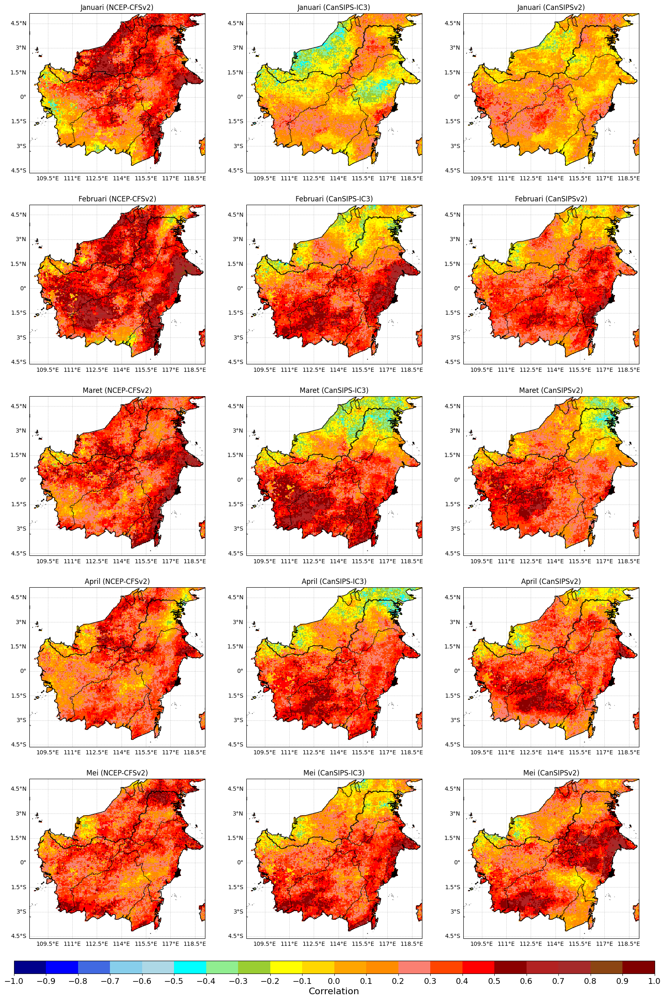

In [10]:
import xarray as xr
import numpy as np
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import geopandas as gpd
import matplotlib.colors as mcolors

# Muat dataset hasil korelasi
correlation_dataset = xr.open_dataset('correlation_results_ASO.nc')

# Ekstrak data dari dataset
latitude = correlation_dataset.latitude.values
longitude = correlation_dataset.longitude.values
months = correlation_dataset.month.values
correlation_data = correlation_dataset.correlation.values

# Tentukan model untuk visualisasi
num_models = 3
num_months = 5
model_names = ["NCEP-CFSv2", "CanSIPS-IC3", "CanSIPSv2"]

# Buat figure dan axes untuk subplot dengan bingkai yang disesuaikan
fig, axes = plt.subplots(num_months, num_models, figsize=(20, 35), subplot_kw={'projection': ccrs.PlateCarree()},
                         gridspec_kw={'hspace': 0.2, 'wspace': 0.05})

# Atur warna dan batas warna
# Buat peta warna diskret yang memberikan batas jelas antara nilai negatif dan positif
import matplotlib.colors as mcolors

# Definisikan warna yang berbeda untuk setiap rentang nilai
colors = [
    'darkblue',  # -1.0 hingga -0.9
    'blue',      # -0.9 hingga -0.8
    'royalblue', # -0.8 hingga -0.7
    'skyblue',   # -0.7 hingga -0.6
    'lightblue', # -0.6 hingga -0.5
    'cyan',      # -0.5 hingga -0.4
    'lightgreen',# -0.4 hingga -0.3
    'yellowgreen',# -0.3 hingga -0.2
    'yellow',    # -0.2 hingga -0.1
    'gold',      # -0.1 hingga  0.0
    'orange',    #  0.0 hingga  0.1
    'darkorange',#  0.1 hingga  0.2
    'salmon',    #  0.2 hingga  0.3
    'orangered', #  0.3 hingga  0.4
    'red',       #  0.4 hingga  0.5
    'darkred',   #  0.5 hingga  0.6
    'firebrick', #  0.6 hingga  0.7
    'brown',     #  0.7 hingga  0.8
    'saddlebrown', #  0.8 hingga  0.9
    'maroon'     #  0.9 hingga  1.0
]

# Buat rentang nilai dengan interval 0,1
bounds = [-1, -0.9, -0.8, -0.7, -0.6, -0.5, -0.4, -0.3, -0.2, -0.1, 0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1]

# Buat colormap dengan warna-warna yang berbeda
cmap = mcolors.ListedColormap(colors)
norm = mcolors.BoundaryNorm(bounds, cmap.N)



# Load shapefile batas provinsi
shapefile_path = 'BATAS_PROVINSI_DESEMBER_2019_DUKCAPIL.shp'  # Ganti dengan path ke shapefile
gdf = gpd.read_file(shapefile_path)

# Filter shapefile sesuai dengan batas longitude dan latitude dari dataset korelasi
lon_min, lon_max = np.min(longitude), np.max(longitude)
lat_min, lat_max = np.min(latitude), np.max(latitude)
gdf = gdf.cx[lon_min:lon_max, lat_min:lat_max]

# Proyeksikan shapefile ke Plate Carree jika belum dalam format yang sesuai
gdf = gdf.to_crs(ccrs.PlateCarree().proj4_init)

# Iterasi melalui setiap bulan dan model
for i, month in enumerate(months):
    row = i % num_months
    col = i // num_months
    ax = axes[row, col]

    # Plot korelasi untuk setiap model dan bulan
    correlation = correlation_data[i, :, :]  # Mengambil data untuk bulan tertentu
    
    # Menambahkan data pada peta
    mesh = ax.pcolormesh(longitude, latitude, correlation, cmap=cmap, norm=norm, shading='auto', transform=ccrs.PlateCarree())
    
    # Menambahkan fitur geografis
    ax.add_feature(cfeature.COASTLINE)
    ax.add_feature(cfeature.BORDERS)
    ax.add_feature(cfeature.LAND, edgecolor='black')
    ax.add_feature(cfeature.OCEAN, facecolor='white')
    
    # Plot batas provinsi dari shapefile menggunakan GeoPandas
    gdf.plot(ax=ax, edgecolor='black', facecolor='none', linewidth=0.5, transform=ccrs.PlateCarree())
    
    # Menambahkan gridline dan label
    gl = ax.gridlines(draw_labels=True, linewidth=0.5, color='gray', alpha=0.5, linestyle='--')
    gl.top_labels = False
    gl.right_labels = False
    
    # Tambahkan label bulan dan model
    ax.set_title(f'{month} ({model_names[col]})', fontsize=12)
    
    # Set extent plot berdasarkan lon dan lat dari data korelasi
    ax.set_extent([lon_min, lon_max, lat_min, lat_max], crs=ccrs.PlateCarree())

# Sesuaikan layout subplot secara manual
plt.subplots_adjust(wspace=0.001, hspace=0.001)

# Tambahkan colorbar di bawah subplot
cbar = fig.colorbar(mesh, ax=axes.ravel().tolist(), orientation='horizontal', pad=0.02, aspect=50, boundaries=bounds, ticks=bounds)
cbar.set_label('Correlation', fontsize=16)
# Perbesar teks pada colorbar
cbar.ax.tick_params(labelsize=14)

# Tampilkan visualisasi
plt.show()


In [56]:
import xarray as xr
import numpy as np
from sklearn.metrics import mean_squared_error

# Muat dataset observasi
data_observasi = xr.open_dataset('AMH_with_Median.nc')
obs_var = data_observasi['AMH']

# Muat dataset prediksi untuk beberapa bulan
data_prediksi1 = xr.open_dataset('predictedCFSJanuariFix.nc')
data_prediksi2 = xr.open_dataset('predictedCFSFebruari.nc')
data_prediksi3 = xr.open_dataset('predictedCFSMaret.nc')
data_prediksi4 = xr.open_dataset('predictedCFSApril.nc')
data_prediksi5 = xr.open_dataset('predictedCFSMei.nc')
data_prediksi6 = xr.open_dataset('predictedIC3Januari.nc')
data_prediksi7 = xr.open_dataset('predictedIC3Februari.nc')
data_prediksi8 = xr.open_dataset('predictedIC3Maret.nc')
data_prediksi9 = xr.open_dataset('predictedIC3April.nc')
data_prediksi10 = xr.open_dataset('predictedIC3Mei.nc')
data_prediksi11 = xr.open_dataset('predictedCansipsv2Januari.nc')
data_prediksi12 = xr.open_dataset('predictedCansipsv2Februari.nc')
data_prediksi13 = xr.open_dataset('predictedCansipsv2Maret.nc')
data_prediksi14 = xr.open_dataset('predictedCansipsv2April.nc')
data_prediksi15 = xr.open_dataset('predictedCansipsv2Mei.nc')

# Sesuaikan dengan variabel dari dataset prediksi
pred_vars = [data_prediksi1['AMHp'], data_prediksi2['AMHp'], data_prediksi3['AMHp'],
             data_prediksi4['AMHp'], data_prediksi5['AMHp'], data_prediksi6['AMHp'],
             data_prediksi7['AMHp'], data_prediksi8['AMHp'], data_prediksi9['AMHp'],
             data_prediksi10['AMHp'], data_prediksi11['AMHp'], data_prediksi12['AMHp'],
             data_prediksi13['AMHp'], data_prediksi14['AMHp'], data_prediksi15['AMHp']]

# Fungsi untuk menghitung RMSE (Root Mean Square Error)
def calculate_rmse(obs, pred):
    if np.any(np.isnan(obs)) or np.any(np.isnan(pred)):
        return np.nan
    else:
        return np.sqrt(mean_squared_error(obs, pred))

# Tentukan dimensi dan koordinat
latitudes = obs_var['latitude']
longitudes = obs_var['longitude']

# Buat array untuk menyimpan hasil RMSE
rmse_maps = [np.zeros((len(latitudes), len(longitudes))) for _ in range(15)]

# Hitung RMSE untuk setiap bulan
for idx, pred_var in enumerate(pred_vars):
    for i in range(len(latitudes)):
        for j in range(len(longitudes)):
            obs_data = obs_var[:, i, j].values
            pred_data = pred_var[:, i, j].values
            rmse_maps[idx][i, j] = calculate_rmse(obs_data, pred_data)

# rmse_maps sekarang berisi nilai RMSE antara data observasi dan data prediksi untuk setiap bulan


In [83]:
import xarray as xr
import numpy as np

# Anggap data observasi dan data prediksi sudah di-load seperti sebelumnya

# Definisikan koordinat
latitudes = obs_var['latitude']
longitudes = obs_var['longitude']
months = ['Januari', 'Februari', 'Maret', 'April', 'Mei']

# Buat data array untuk korelasi, dengan bentuk [bulan, latitude, longitude]
rmse_data = np.stack(rmse_maps).reshape((15, len(latitudes), len(longitudes)))

# Buat dataset xarray
rmse_dataset = xr.Dataset(
    {
        'rmse': (['month', 'latitude', 'longitude'], rmse_data)
    },
    coords={
        'month': months * 3,  # 15 bulan karena 3 model (5 bulan per model)
        'latitude': latitudes,
        'longitude': longitudes
    }
)

# Simpan dataset ke file NetCDF
# rmse_dataset.to_netcdf('rmse_results.nc')



In [84]:
dataaslireal = xr.open_dataset('AMH_with_NAN.nc')
mask = dataaslireal['AMH'][:15,:,:]
mask_nan_var7 = np.isnan(mask)
rmse_dataset = rmse_dataset['rmse'].values
rmse_dataset[mask_nan_var7] = np.nan

In [85]:
# Buat dataset xarray
rmse_dataset = xr.Dataset(
    {
        'rmse': (['month', 'latitude', 'longitude'], rmse_dataset)
    },
    coords={
        'month': months * 3,  # 15 bulan karena 3 model (5 bulan per model)
        'latitude': latitudes,
        'longitude': longitudes
    }
)
# Simpan dataset ke file NetCDF
rmse_dataset.to_netcdf('rmse_results.nc')

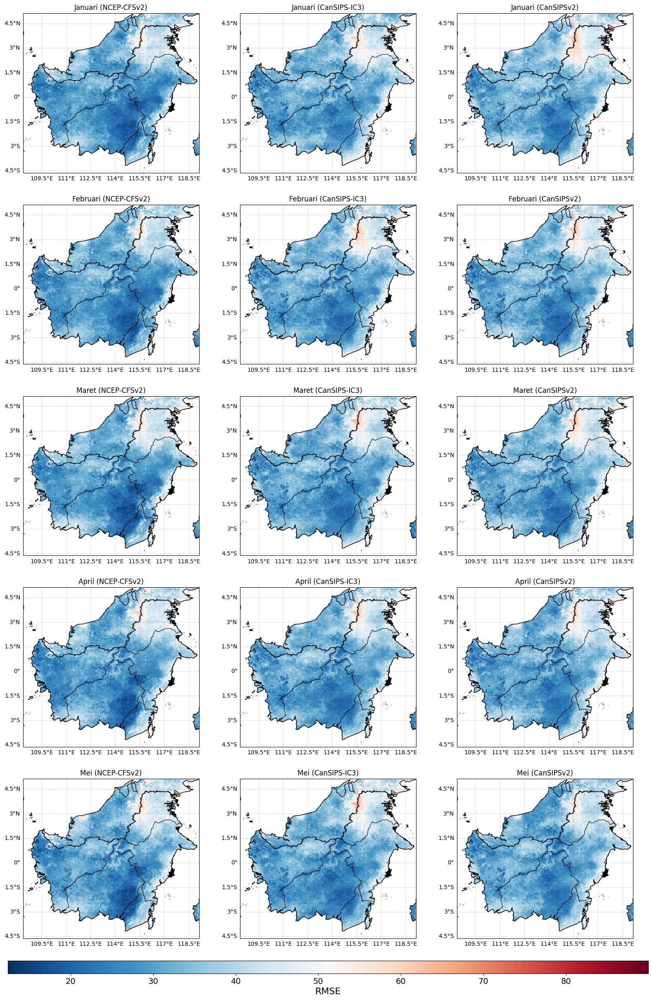

In [42]:
import xarray as xr
import numpy as np
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature

# Muat dataset hasil korelasi
correlation_dataset = xr.open_dataset('rmse_results.nc')

# Ekstrak data dari dataset
latitude = correlation_dataset.latitude.values
longitude = correlation_dataset.longitude.values
months = correlation_dataset.month.values
correlation_data = correlation_dataset.rmse.values

# Tentukan model untuk visualisasi
num_models = 3
num_months = 5
model_names = ["NCEP-CFSv2", "CanSIPS-IC3", "CanSIPSv2"]

# Buat figure dan axes untuk subplot
# fig, axes = plt.subplots(num_months, num_models, figsize=(30, 25), subplot_kw={'projection': ccrs.PlateCarree()})

# Buat figure dan axes untuk subplot dengan jarak antar subplot yang lebih kecil
fig, axes = plt.subplots(num_months, num_models, figsize=(20, 35), subplot_kw={'projection': ccrs.PlateCarree()}, 
                         gridspec_kw={'hspace': 0.2, 'wspace': 0.05})


# Atur warna dan batas warna
cmap = plt.cm.RdBu_r 
# Inisialisasi variabel untuk menyimpan nilai minimum dan maksimum RMSE
global_min_rmse = np.inf
global_max_rmse = -np.inf



# Load shapefile batas provinsi
shapefile_path = 'BATAS_PROVINSI_DESEMBER_2019_DUKCAPIL.shp'  # Ganti dengan path ke shapefile
gdf = gpd.read_file(shapefile_path)

# Filter shapefile sesuai dengan batas longitude dan latitude dari dataset korelasi
lon_min, lon_max = np.min(longitude), np.max(longitude)
lat_min, lat_max = np.min(latitude), np.max(latitude)
gdf = gdf.cx[lon_min:lon_max, lat_min:lat_max]

# Proyeksikan shapefile ke Plate Carree jika belum dalam format yang sesuai
gdf = gdf.to_crs(ccrs.PlateCarree().proj4_init)


# Iterasi melalui setiap bulan dan model
for i, month in enumerate(months):
    row = i % num_months
    col = i // num_months
    ax = axes[row, col]
    # Hitung nilai minimum dan maksimum RMSE untuk bulan ini
    local_min_rmse = np.nanmin(correlation_data)
    local_max_rmse = np.nanmax(correlation_data)

    # Update nilai minimum dan maksimum global RMSE
    global_min_rmse = min(global_min_rmse, local_min_rmse)
    global_max_rmse = max(global_max_rmse, local_max_rmse)
    # Plot korelasi untuk setiap model dan bulan
    correlation = correlation_data[i, :, :]  # Mengambil data untuk bulan tertentu
    
    # Menambahkan data pada peta
    mesh = ax.pcolormesh(longitude, latitude, correlation, cmap=cmap, vmin=global_min_rmse, vmax=global_max_rmse, shading='auto', transform=ccrs.PlateCarree())
    
    # Menambahkan fitur geografis
    ax.add_feature(cfeature.COASTLINE)
    ax.add_feature(cfeature.BORDERS)
    ax.add_feature(cfeature.LAND, edgecolor='black')
    ax.add_feature(cfeature.OCEAN, facecolor='white')
    
    # Plot batas provinsi dari shapefile menggunakan GeoPandas
    gdf.plot(ax=ax, edgecolor='black', facecolor='none', linewidth=0.5, transform=ccrs.PlateCarree())
    # Menambahkan gridline dan label
    gl = ax.gridlines(draw_labels=True, linewidth=0.5, color='gray', alpha=0.5, linestyle='--')
    gl.top_labels = False
    gl.right_labels = False
    
    # Tambahkan label bulan dan model
    ax.set_title(f'{month} ({model_names[col]})', fontsize=12)
        
    # Set extent plot berdasarkan lon dan lat dari data korelasi
    ax.set_extent([lon_min, lon_max, lat_min, lat_max], crs=ccrs.PlateCarree())


# Sesuaikan layout subplot secara manual
plt.subplots_adjust(wspace=0.001, hspace=0.001)

# Tambahkan colorbar di bawah subplot
cbar = fig.colorbar(mesh, ax=axes.ravel().tolist(), orientation='horizontal', pad=0.02, aspect=50)
cbar.set_label('RMSE', fontsize=16)
# Perbesar teks pada colorbar
cbar.ax.tick_params(labelsize=14)

# Sesuaikan layout dan simpan gambar
# plt.tight_layout()
# plt.savefig('correlation_maps_cartopy.png', dpi=300, bbox_inches='tight')
plt.show()

# print("Visualisasi korelasi telah disimpan ke 'correlation_maps_cartopy.png'")


In [2]:
import xarray as xr
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import pearsonr
import math

# Muat dataset observasi dan prediksi
data_observasi = xr.open_dataset('AMH_with_Median.nc')
data_prediksi1 = xr.open_dataset('predictedCFSJanuariFix.nc')
data_prediksi2 = xr.open_dataset('predictedCFSFebruari.nc')
data_prediksi3 = xr.open_dataset('predictedCFSMaret.nc')
data_prediksi4 = xr.open_dataset('predictedCFSApril.nc')
data_prediksi5 = xr.open_dataset('predictedCFSMei.nc')
data_prediksi6 = xr.open_dataset('predictedIC3Januari.nc')
data_prediksi7 = xr.open_dataset('predictedIC3Februari.nc')
data_prediksi8 = xr.open_dataset('predictedIC3Maret.nc')
data_prediksi9 = xr.open_dataset('predictedIC3April.nc')
data_prediksi10 = xr.open_dataset('predictedIC3Mei.nc')
data_prediksi11 = xr.open_dataset('predictedCansipsv2Januari.nc')
data_prediksi12 = xr.open_dataset('predictedCansipsv2Februari.nc')
data_prediksi13 = xr.open_dataset('predictedCansipsv2Maret.nc')
data_prediksi14 = xr.open_dataset('predictedCansipsv2April.nc')
data_prediksi15 = xr.open_dataset('predictedCansipsv2Mei.nc')

# Ambil variabel yang sesuai
obs_var = data_observasi['AMH']
pred_vars = [
    data_prediksi1['AMHp'], data_prediksi2['AMHp'], data_prediksi3['AMHp'],
    data_prediksi4['AMHp'], data_prediksi5['AMHp'], data_prediksi6['AMHp'],
    data_prediksi7['AMHp'], data_prediksi8['AMHp'], data_prediksi9['AMHp'],
    data_prediksi10['AMHp'], data_prediksi11['AMHp'], data_prediksi12['AMHp'],
    data_prediksi13['AMHp'], data_prediksi14['AMHp'], data_prediksi15['AMHp']
]
# Rata-rata spasial
obs_mean = obs_var.mean(dim=('latitude', 'longitude'))
pred_means = [p.mean(dim=('latitude', 'longitude')) for p in pred_vars]

def calculate_rmse(observed, predicted):
    return np.sqrt(((predicted - observed) ** 2).mean())


def taylor_diagram(ref, data, labels, title='Taylor Diagram'):
    # Hitung statistik
    ref_std = np.std(ref)
    corrs = [pearsonr(ref, d)[0] for d in data]
    std_devs = [np.std(d) for d in data]
    rmses = [calculate_rmse(ref, d) for d in data]

    # Buat plot
    fig = plt.figure(figsize=(10, 8))
    ax = fig.add_subplot(111, polar=True)

    # Plot data
    for i, (std, corr, rmse) in enumerate(zip(std_devs, corrs, rmses)):
        theta = np.arccos(corr)
        ax.plot(theta, std, 'o', label=f'{labels[i]} (RMSE: {rmse:.2f})')

    # Plot referensi
    ax.plot(0, ref_std, 'ko', label='Observasi')

    # Tambahkan grid dan label
    ax.grid(True)
    ax.set_ylim(0, max(std_devs + [ref_std]) * 1.1)
    ax.set_yticks(np.linspace(0, max(std_devs + [ref_std]), 5))
    ax.set_yticklabels(['{:.2f}'.format(y) for y in np.linspace(0, max(std_devs + [ref_std]), 5)])
    ax.set_ylabel('Standar Deviasi')

    ax.set_xticks(np.arccos(np.linspace(0, 1, 7)))
    ax.set_xticklabels(['{:.2f}'.format(x) for x in np.linspace(0, 1, 7)])
    ax.set_xlabel('Korelasi')

    plt.title(title)
    plt.legend()
    plt.show()



In [3]:
# Konversi ke array numpy
obs_array = obs_mean.values
pred_arrays = [p.values for p in pred_means]

# Label prediksi
labels = [
    'CFS Januari', 'CFS Februari', 'CFS Maret',
    'CFS April', 'CFS Mei', 'IC3 Januari',
    'IC3 Februari', 'IC3 Maret', 'IC3 April',
    'IC3 Mei', 'Cansipsv2 Januari', 'Cansipsv2 Februari',
    'Cansipsv2 Maret', 'Cansipsv2 April', 'Cansipsv2 Mei'
]

# Panggil fungsi untuk membuat diagram Taylor
# taylor_diagram(obs_array, pred_arrays, labels)



In [18]:
import xarray as xr
import numpy as np

# Muat dataset observasi
data_observasi = xr.open_dataset('AMH_with_Median.nc')
obs_var = data_observasi['AMH']

# Muat dataset prediksi untuk beberapa bulan
data_prediksi1 = xr.open_dataset('predictedCFSJanuariFix.nc')
data_prediksi2 = xr.open_dataset('predictedCFSFebruari.nc')
data_prediksi3 = xr.open_dataset('predictedCFSMaret.nc')
data_prediksi4 = xr.open_dataset('predictedCFSApril.nc')
data_prediksi5 = xr.open_dataset('predictedCFSMei.nc')
data_prediksi6 = xr.open_dataset('predictedIC3Januari.nc')
data_prediksi7 = xr.open_dataset('predictedIC3Februari.nc')
data_prediksi8 = xr.open_dataset('predictedIC3Maret.nc')
data_prediksi9 = xr.open_dataset('predictedIC3April.nc')
data_prediksi10 = xr.open_dataset('predictedIC3Mei.nc')
data_prediksi11 = xr.open_dataset('predictedCansipsv2Januari.nc')
data_prediksi12 = xr.open_dataset('predictedCansipsv2Februari.nc')
data_prediksi13 = xr.open_dataset('predictedCansipsv2Maret.nc')
data_prediksi14 = xr.open_dataset('predictedCansipsv2April.nc')
data_prediksi15 = xr.open_dataset('predictedCansipsv2Mei.nc')

# Sesuaikan dengan variabel dari dataset prediksi
pred_vars = [data_prediksi1['AMHp'], data_prediksi2['AMHp'], data_prediksi3['AMHp'],
             data_prediksi4['AMHp'], data_prediksi5['AMHp'], data_prediksi6['AMHp'],
             data_prediksi7['AMHp'], data_prediksi8['AMHp'], data_prediksi9['AMHp'],
             data_prediksi10['AMHp'], data_prediksi11['AMHp'], data_prediksi12['AMHp'],
             data_prediksi13['AMHp'], data_prediksi14['AMHp'], data_prediksi15['AMHp']]

# Tentukan dimensi dan koordinat
latitudes = obs_var['latitude']
longitudes = obs_var['longitude']

# Buat array untuk menyimpan hasil standar deviasi yang dinormalisasi
normalized_std_maps = [np.zeros((len(latitudes), len(longitudes))) for _ in range(15)]

# Hitung standar deviasi yang dinormalisasi untuk setiap bulan
for idx, pred_var in enumerate(pred_vars):
    for i in range(len(latitudes)):
        for j in range(len(longitudes)):
            obs_data = obs_var[:, i, j].values
            pred_data = pred_var[:, i, j].values
            
            # Hitung standar deviasi
            std_obs = np.std(obs_data)
            std_pred = np.std(pred_data)
            
            # Hindari pembagian dengan nol dan NaN
            if std_obs == 0 or np.isnan(std_obs):
                normalized_std_maps[idx][i, j] = np.nan
            else:
                normalized_std_maps[idx][i, j] = std_pred / std_obs

# normalized_std_maps sekarang berisi nilai standar deviasi yang dinormalisasi antara data observasi dan data prediksi untuk setiap bulan


In [25]:
import xarray as xr
import numpy as np

# Anggap data observasi dan data prediksi sudah di-load seperti sebelumnya

# Definisikan koordinat
latitudes = obs_var['latitude']
longitudes = obs_var['longitude']
months = ['Januari', 'Februari', 'Maret', 'April', 'Mei']

# Buat data array untuk korelasi, dengan bentuk [bulan, latitude, longitude]
stdev_data = np.stack(normalized_std_maps).reshape((15, len(latitudes), len(longitudes)))

# Buat dataset xarray
stdev_dataset = xr.Dataset(
    {
        'stdev': (['month', 'latitude', 'longitude'], stdev_data)
    },
    coords={
        'month': months * 3,  # 15 bulan karena 3 model (5 bulan per model)
        'latitude': latitudes,
        'longitude': longitudes
    }
)

# Simpan dataset ke file NetCDF
stdev_dataset.to_netcdf('stdev_results.nc')

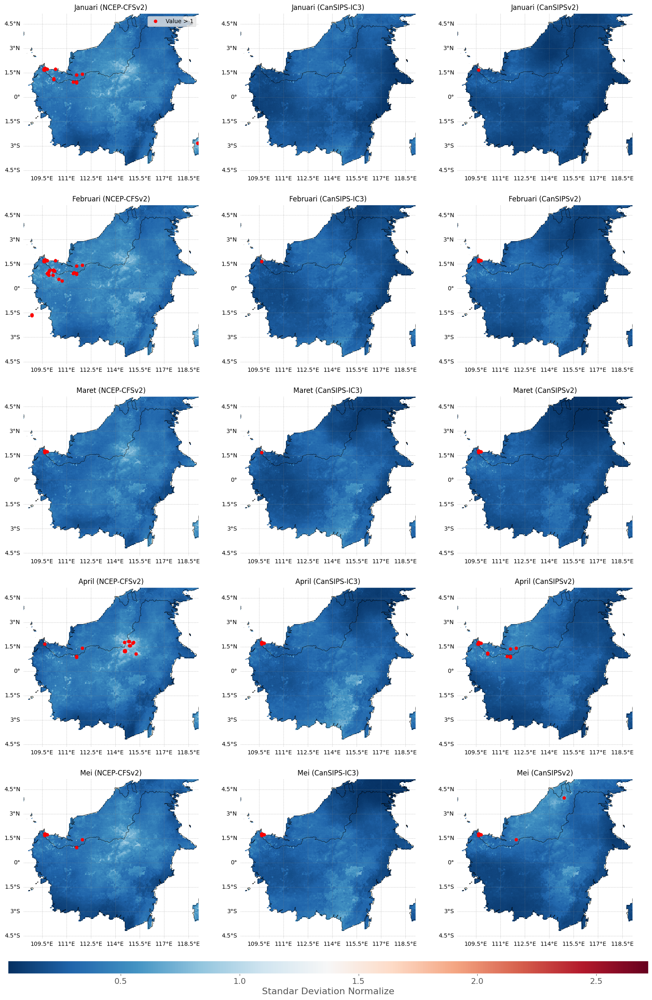

In [38]:
import xarray as xr
import numpy as np
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature

# Muat dataset hasil korelasi
correlation_dataset = xr.open_dataset('stdev_results.nc')

# Ekstrak data dari dataset
latitude = correlation_dataset.latitude.values
longitude = correlation_dataset.longitude.values
months = correlation_dataset.month.values
correlation_data = correlation_dataset.stdev.values

# Tentukan model untuk visualisasi
num_models = 3
num_months = 5
model_names = ["NCEP-CFSv2", "CanSIPS-IC3", "CanSIPSv2"]

# Buat figure dan axes untuk subplot
fig, axes = plt.subplots(num_months, num_models, figsize=(20, 35), subplot_kw={'projection': ccrs.PlateCarree()}, 
                         gridspec_kw={'hspace': 0.2, 'wspace': 0.05})

# Atur warna dan batas warna
cmap = plt.cm.RdBu_r
global_min_rmse = np.inf
global_max_rmse = -np.inf

# Nilai batas untuk penanda
threshold_value = 1

# Iterasi melalui setiap bulan dan model
for i, month in enumerate(months):
    row = i % num_months
    col = i // num_months
    ax = axes[row, col]
    
    # Cari nilai minimum dan maksimum RMSE
    local_min_rmse = np.nanmin(correlation_data)
    local_max_rmse = np.nanmax(correlation_data)
    global_min_rmse = min(global_min_rmse, local_min_rmse)
    global_max_rmse = max(global_max_rmse, local_max_rmse)
    
    # Ambil data untuk bulan tertentu
    correlation = correlation_data[i, :, :]
    
    # Plot data pada peta
    mesh = ax.pcolormesh(longitude, latitude, correlation, cmap=cmap, vmin=global_min_rmse, vmax=global_max_rmse, shading='auto', transform=ccrs.PlateCarree())
    
    # Tambahkan fitur geografis
    ax.add_feature(cfeature.COASTLINE)
    ax.add_feature(cfeature.BORDERS)
    ax.add_feature(cfeature.LAND, edgecolor='black')
    ax.add_feature(cfeature.OCEAN, facecolor='white')
    
    # Tambahkan gridline dan label
    gl = ax.gridlines(draw_labels=True, linewidth=0.5, color='gray', alpha=0.5, linestyle='--')
    gl.top_labels = False
    gl.right_labels = False
    
    # Tambahkan label bulan dan model
    ax.set_title(f'{month} ({model_names[col]})', fontsize=12)
    
    # Temukan koordinat nilai yang lebih dari 1
    lat_idxs, lon_idxs = np.where(correlation > threshold_value)
    for lat_idx, lon_idx in zip(lat_idxs, lon_idxs):
        max_lat = latitude[lat_idx]
        max_lon = longitude[lon_idx]
        ax.plot(max_lon, max_lat, 'ro', markersize=5, transform=ccrs.PlateCarree(), label='Value > 1' if (lat_idx, lon_idx) == (lat_idxs[0], lon_idxs[0]) else "")
    
    # Hanya tambahkan legend untuk satu subplot
    if i == 0:
        ax.legend(loc='upper right', fontsize=10)

# Sesuaikan layout subplot secara manual
plt.subplots_adjust(wspace=0.001, hspace=0.001)

# Tambahkan colorbar di bawah subplot
cbar = fig.colorbar(mesh, ax=axes.ravel().tolist(), orientation='horizontal', pad=0.02, aspect=50)
cbar.set_label('Standar Deviation Normalize', fontsize=16)
cbar.ax.tick_params(labelsize=14)

# Tampilkan hasil
plt.show()


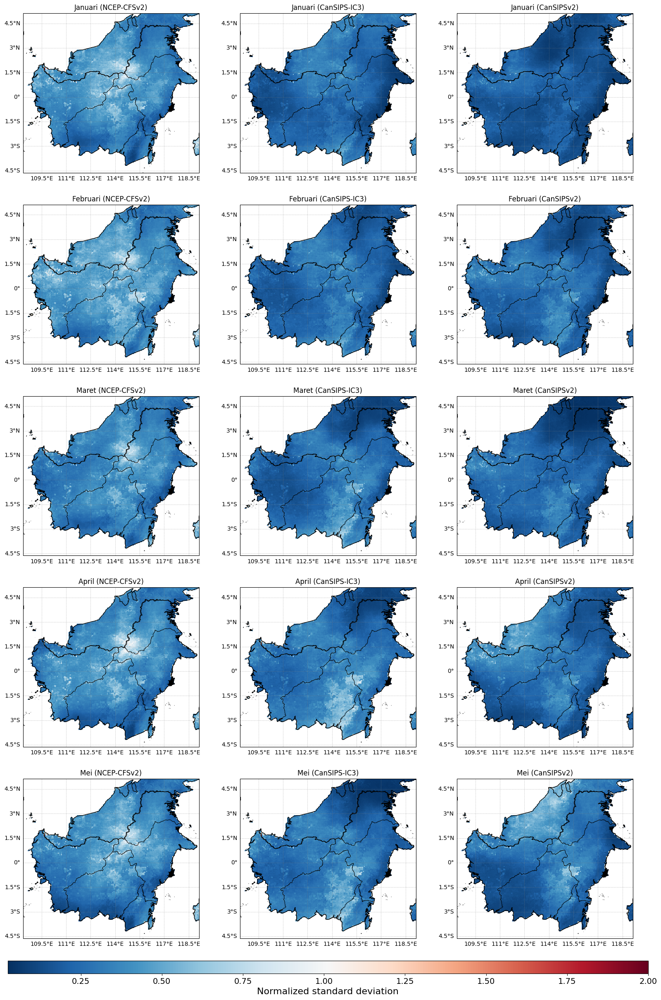

In [6]:
import xarray as xr
import numpy as np
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import geopandas as gpd
import matplotlib.colors as mcolors


# Muat dataset hasil korelasi
correlation_dataset = xr.open_dataset('stdev_results.nc')

# Ekstrak data dari dataset
latitude = correlation_dataset.latitude.values
longitude = correlation_dataset.longitude.values
months = correlation_dataset.month.values
correlation_data = correlation_dataset.stdev.values

# Tentukan model untuk visualisasi
num_models = 3
num_months = 5
model_names = ["NCEP-CFSv2", "CanSIPS-IC3", "CanSIPSv2"]

# Buat figure dan axes untuk subplot
# fig, axes = plt.subplots(num_months, num_models, figsize=(30, 25), subplot_kw={'projection': ccrs.PlateCarree()})

# Buat figure dan axes untuk subplot dengan jarak antar subplot yang lebih kecil
fig, axes = plt.subplots(num_months, num_models, figsize=(20, 35), subplot_kw={'projection': ccrs.PlateCarree()}, 
                         gridspec_kw={'hspace': 0.2, 'wspace': 0.05})


# Load shapefile batas provinsi
shapefile_path = 'BATAS_PROVINSI_DESEMBER_2019_DUKCAPIL.shp'  # Ganti dengan path ke shapefile
gdf = gpd.read_file(shapefile_path)

# Filter shapefile sesuai dengan batas longitude dan latitude dari dataset korelasi
lon_min, lon_max = np.min(longitude), np.max(longitude)
lat_min, lat_max = np.min(latitude), np.max(latitude)
gdf = gdf.cx[lon_min:lon_max, lat_min:lat_max]

# Proyeksikan shapefile ke Plate Carree jika belum dalam format yang sesuai
gdf = gdf.to_crs(ccrs.PlateCarree().proj4_init)

# Atur warna dan batas warna
cmap = plt.cm.RdBu_r
# bounds = [0, 0.2, 0.4, 0.6, 0.8, 1, 1.2, 1.4]
# norm = mcolors.BoundaryNorm(bounds, cmap.N)
# Inisialisasi variabel untuk menyimpan nilai minimum dan maksimum RMSE
global_min_rmse = np.inf
global_max_rmse = -np.inf

# Iterasi melalui setiap bulan dan model
for i, month in enumerate(months):
    row = i % num_months
    col = i // num_months
    ax = axes[row, col]
    # Hitung nilai minimum dan maksimum RMSE untuk bulan ini
    local_min_rmse = np.nanmin(correlation_data)
    local_max_rmse = 2

    # Update nilai minimum dan maksimum global RMSE
    # global_min_rmse = min(global_min_rmse, local_min_rmse)
    # global_max_rmse = max(global_max_rmse, local_max_rmse)
    # Plot korelasi untuk setiap model dan bulan
    correlation = correlation_data[i, :, :]  # Mengambil data untuk bulan tertentu
    
    # Menambahkan data pada peta
    mesh = ax.pcolormesh(longitude, latitude, correlation, cmap=cmap, vmin=local_min_rmse, vmax=local_max_rmse, shading='auto', transform=ccrs.PlateCarree())
    
    # Menambahkan fitur geografis
    ax.add_feature(cfeature.COASTLINE)
    ax.add_feature(cfeature.BORDERS)
    ax.add_feature(cfeature.LAND, edgecolor='black')
    ax.add_feature(cfeature.OCEAN, facecolor='white')
    
    # Plot batas provinsi dari shapefile menggunakan GeoPandas
    gdf.plot(ax=ax, edgecolor='black', facecolor='none', linewidth=0.5, transform=ccrs.PlateCarree())
    # Menambahkan gridline dan label
    gl = ax.gridlines(draw_labels=True, linewidth=0.5, color='gray', alpha=0.5, linestyle='--')
    gl.top_labels = False
    gl.right_labels = False
    
    # Tambahkan label bulan dan model
    ax.set_title(f'{month} ({model_names[col]})', fontsize=12)
        
    # Set extent plot berdasarkan lon dan lat dari data korelasi
    ax.set_extent([lon_min, lon_max, lat_min, lat_max], crs=ccrs.PlateCarree())


# Sesuaikan layout subplot secara manual
plt.subplots_adjust(wspace=0.001, hspace=0.001)

# Tambahkan colorbar di bawah subplot
cbar = fig.colorbar(mesh, ax=axes.ravel().tolist(), orientation='horizontal', pad=0.02, aspect=50)
cbar.set_label('Normalized standard deviation', fontsize=16)
# Perbesar teks pada colorbar
cbar.ax.tick_params(labelsize=14)

# Sesuaikan layout dan simpan gambar
# plt.tight_layout()
# plt.savefig('correlation_maps_cartopy.png', dpi=300, bbox_inches='tight')
plt.show()

# print("Visualisasi korelasi telah disimpan ke 'correlation_maps_cartopy.png'")


In [105]:
import xarray as xr
import numpy as np
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature

data = xr.open_dataset('AMH_with_NAN.nc')
mask_test = data['AMH']
mask_nan = np.isnan(mask_test)

# data_prediksi1 = xr.open_dataset('predictedCFSJanuariFix.nc')
# data_prediksi2 = xr.open_dataset('predictedCFSFebruari.nc')  # Ganti dengan file model prediksi kedua
# data_prediksi3 = xr.open_dataset('predictedCFSMaret.nc')  # Ganti dengan file model prediksi ketiga
# data_prediksi4 = xr.open_dataset('predictedCFSApril.nc')
# data_prediksi5 = xr.open_dataset('predictedCFSMei.nc')
# data_prediksi6 = xr.open_dataset('predictedIC3Januari.nc')
# data_prediksi7 = xr.open_dataset('predictedIC3Februari.nc')  # Ganti dengan file model prediksi kedua
# data_prediksi8 = xr.open_dataset('predictedIC3Maret.nc')  # Ganti dengan file model prediksi ketiga
# data_prediksi9 = xr.open_dataset('predictedIC3April.nc')
# data_prediksi10 = xr.open_dataset('predictedIC3Mei.nc')
# data_prediksi11 = xr.open_dataset('predictedCansipsv2Januari.nc')
# data_prediksi12 = xr.open_dataset('predictedCansipsv2Februari.nc')  # Ganti dengan file model prediksi kedua
# data_prediksi13 = xr.open_dataset('predictedCansipsv2Maret.nc')  # Ganti dengan file model prediksi ketiga
# data_prediksi14 = xr.open_dataset('predictedCansipsv2April.nc')
# data_prediksi15 = xr.open_dataset('predictedCansipsv2Mei.nc')

data_prediksi1 = xr.open_dataset('PreASO_CFSJanuari.nc')
data_prediksi2 = xr.open_dataset('PreASO_CFSFebruari.nc')
data_prediksi3 = xr.open_dataset('PreASO_CFSMaret.nc')
data_prediksi4 = xr.open_dataset('PreASO_CFSApril.nc')
data_prediksi5 = xr.open_dataset('PreASO_CFSMei.nc')
data_prediksi6 = xr.open_dataset('PreASO_IC3Januari.nc')
data_prediksi7 = xr.open_dataset('PreASO_IC3Februari.nc')
data_prediksi8 = xr.open_dataset('PreASO_IC3Maret.nc')
data_prediksi9 = xr.open_dataset('PreASO_IC3April.nc')
data_prediksi10 = xr.open_dataset('PreASO_IC3Mei.nc')
data_prediksi11 = xr.open_dataset('PreASO_Cansipv2Januari.nc')
data_prediksi12 = xr.open_dataset('PreASO_Cansipv2Februari.nc')
data_prediksi13 = xr.open_dataset('PreASO_Cansipv2Maret.nc')
data_prediksi14 = xr.open_dataset('PreASO_Cansipv2April.nc')
data_prediksi15 = xr.open_dataset('PreASO_Cansipv2Mei.nc')



# Sesuaikan dengan variabel dari dataset
pred_var1 = data_prediksi1['AMHp'].values
pred_var2 = data_prediksi2['AMHp'].values
pred_var3 = data_prediksi3['AMHp'].values
pred_var4 = data_prediksi4['AMHp'].values
pred_var5 = data_prediksi5['AMHp'].values
pred_var6 = data_prediksi6['AMHp'].values
pred_var7 = data_prediksi7['AMHp'].values
pred_var8 = data_prediksi8['AMHp'].values
pred_var9 = data_prediksi9['AMHp'].values
pred_var10 = data_prediksi10['AMHp'].values
pred_var11 = data_prediksi11['AMHp'].values
pred_var12 = data_prediksi12['AMHp'].values
pred_var13 = data_prediksi13['AMHp'].values
pred_var14 = data_prediksi14['AMHp'].values
pred_var15 = data_prediksi15['AMHp'].values


pred_var1[mask_nan] = np.nan
pred_var2[mask_nan] = np.nan
pred_var3[mask_nan] = np.nan
pred_var4[mask_nan] = np.nan
pred_var5[mask_nan] = np.nan
pred_var6[mask_nan] = np.nan
pred_var7[mask_nan] = np.nan
pred_var8[mask_nan] = np.nan
pred_var9[mask_nan] = np.nan
pred_var10[mask_nan] = np.nan
pred_var11[mask_nan] = np.nan
pred_var12[mask_nan] = np.nan
pred_var13[mask_nan] = np.nan
pred_var14[mask_nan] = np.nan
pred_var15[mask_nan] = np.nan

In [106]:
pred_var1 = xr.DataArray(
   data=pred_var1,
   dims=["year", "latitude", "longitude"],
   coords={
       "year": data['year'].values,
       "latitude": data['latitude'].values,
       "longitude": data['longitude'].values
   }
)
pred_var2 = xr.DataArray(
   data=pred_var2,
   dims=["year", "latitude", "longitude"],
   coords={
       "year": data['year'].values,
       "latitude": data['latitude'].values,
       "longitude": data['longitude'].values
   }
)
pred_var3 = xr.DataArray(
   data=pred_var3,
   dims=["year", "latitude", "longitude"],
   coords={
       "year": data['year'].values,
       "latitude": data['latitude'].values,
       "longitude": data['longitude'].values
   }
)
pred_var4 = xr.DataArray(
   data=pred_var4,
   dims=["year", "latitude", "longitude"],
   coords={
       "year": data['year'].values,
       "latitude": data['latitude'].values,
       "longitude": data['longitude'].values
   }
)
pred_var5 = xr.DataArray(
   data=pred_var5,
   dims=["year", "latitude", "longitude"],
   coords={
       "year": data['year'].values,
       "latitude": data['latitude'].values,
       "longitude": data['longitude'].values
   }
)
pred_var6 = xr.DataArray(
   data=pred_var6,
   dims=["year", "latitude", "longitude"],
   coords={
       "year": data['year'].values,
       "latitude": data['latitude'].values,
       "longitude": data['longitude'].values
   }
)
pred_var7 = xr.DataArray(
   data=pred_var7,
   dims=["year", "latitude", "longitude"],
   coords={
       "year": data['year'].values,
       "latitude": data['latitude'].values,
       "longitude": data['longitude'].values
   }
)
pred_var8 = xr.DataArray(
   data=pred_var8,
   dims=["year", "latitude", "longitude"],
   coords={
       "year": data['year'].values,
       "latitude": data['latitude'].values,
       "longitude": data['longitude'].values
   }
)
pred_var9 = xr.DataArray(
   data=pred_var9,
   dims=["year", "latitude", "longitude"],
   coords={
       "year": data['year'].values,
       "latitude": data['latitude'].values,
       "longitude": data['longitude'].values
   }
)
pred_var9 = xr.DataArray(
   data=pred_var9,
   dims=["year", "latitude", "longitude"],
   coords={
       "year": data['year'].values,
       "latitude": data['latitude'].values,
       "longitude": data['longitude'].values
   }
)
pred_var10 = xr.DataArray(
   data=pred_var10,
   dims=["year", "latitude", "longitude"],
   coords={
       "year": data['year'].values,
       "latitude": data['latitude'].values,
       "longitude": data['longitude'].values
   }
)
pred_var11 = xr.DataArray(
   data=pred_var11,
   dims=["year", "latitude", "longitude"],
   coords={
       "year": data['year'].values,
       "latitude": data['latitude'].values,
       "longitude": data['longitude'].values
   }
)
pred_var12 = xr.DataArray(
   data=pred_var12,
   dims=["year", "latitude", "longitude"],
   coords={
       "year": data['year'].values,
       "latitude": data['latitude'].values,
       "longitude": data['longitude'].values
   }
)
pred_var13 = xr.DataArray(
   data=pred_var13,
   dims=["year", "latitude", "longitude"],
   coords={
       "year": data['year'].values,
       "latitude": data['latitude'].values,
       "longitude": data['longitude'].values
   }
)
pred_var14 = xr.DataArray(
   data=pred_var14,
   dims=["year", "latitude", "longitude"],
   coords={
       "year": data['year'].values,
       "latitude": data['latitude'].values,
       "longitude": data['longitude'].values
   }
)
pred_var15 = xr.DataArray(
   data=pred_var15,
   dims=["year", "latitude", "longitude"],
   coords={
       "year": data['year'].values,
       "latitude": data['latitude'].values,
       "longitude": data['longitude'].values
   }
)

In [107]:
epred_var1 = pred_var1.sel(year=1998)
epred_var2 = pred_var2.sel(year=1998)
epred_var3 = pred_var3.sel(year=1998)
epred_var4 = pred_var4.sel(year=1998)
epred_var5 = pred_var5.sel(year=1998)
epred_var6 = pred_var6.sel(year=1998)
epred_var7 = pred_var7.sel(year=1998)
epred_var8 = pred_var8.sel(year=1998)
epred_var9 = pred_var9.sel(year=1998)
epred_var10 = pred_var10.sel(year=1998)
epred_var11 = pred_var11.sel(year=1998)
epred_var12 = pred_var12.sel(year=1998)
epred_var13 = pred_var13.sel(year=1998)
epred_var14 = pred_var14.sel(year=1998)
epred_var15 = pred_var15.sel(year=1998)


In [110]:
pred_var1 = pred_var1.mean(dim='year')
pred_var2 = pred_var2.mean(dim='year')
pred_var3 = pred_var3.mean(dim='year')
pred_var4 = pred_var4.mean(dim='year')
pred_var5 = pred_var5.mean(dim='year')
pred_var6 = pred_var6.mean(dim='year')
pred_var7 = pred_var7.mean(dim='year')
pred_var8 = pred_var8.mean(dim='year')
pred_var9 = pred_var9.mean(dim='year')
pred_var10 = pred_var10.mean(dim='year')
pred_var11 = pred_var11.mean(dim='year')
pred_var12 = pred_var12.mean(dim='year')
pred_var13 = pred_var13.mean(dim='year')
pred_var14 = pred_var14.mean(dim='year')
pred_var15 = pred_var15.mean(dim='year')

In [111]:
diff_epred_var1 = epred_var1 - pred_var1
diff_epred_var2 = epred_var2 - pred_var2
diff_epred_var3 = epred_var3 - pred_var3
diff_epred_var4 = epred_var4 - pred_var4
diff_epred_var5 = epred_var5 - pred_var5
diff_epred_var6 = epred_var6 - pred_var6
diff_epred_var7 = epred_var7 - pred_var7
diff_epred_var8 = epred_var8 - pred_var8
diff_epred_var9 = epred_var9 - pred_var9
diff_epred_var10 = epred_var10 - pred_var10
diff_epred_var11 = epred_var11 - pred_var11
diff_epred_var12 = epred_var12 - pred_var12
diff_epred_var13 = epred_var13 - pred_var13
diff_epred_var14 = epred_var14 - pred_var14
diff_epred_var15 = epred_var15 - pred_var15

In [112]:
actual_mean  = mask_test.mean(dim='year')
eaktual = mask_test.sel(year=1998)
diff_actual_var  = eaktual- actual_mean 

In [113]:
# Langkah 3: Bandingkan selisih prediksi dengan selisih data aktual tunggal
sensitivity_var1 = diff_epred_var1 - diff_actual_var
sensitivity_var2 = diff_epred_var2 - diff_actual_var
sensitivity_var3 = diff_epred_var3 - diff_actual_var
sensitivity_var4 = diff_epred_var4 - diff_actual_var
sensitivity_var5 = diff_epred_var5 - diff_actual_var
sensitivity_var6 = diff_epred_var6 - diff_actual_var
sensitivity_var7 = diff_epred_var7 - diff_actual_var
sensitivity_var8 = diff_epred_var8 - diff_actual_var
sensitivity_var9 = diff_epred_var9 - diff_actual_var
sensitivity_var10 = diff_epred_var10 - diff_actual_var
sensitivity_var11 = diff_epred_var11 - diff_actual_var
sensitivity_var12 = diff_epred_var12 - diff_actual_var
sensitivity_var13 = diff_epred_var13 - diff_actual_var
sensitivity_var14 = diff_epred_var14 - diff_actual_var
sensitivity_var15 = diff_epred_var15 - diff_actual_var

In [114]:
import xarray as xr

# Sensitivitas yang telah dihitung
sensitivity_vars = [sensitivity_var1, sensitivity_var2, sensitivity_var3, sensitivity_var4, sensitivity_var5,
                    sensitivity_var6, sensitivity_var7, sensitivity_var8, sensitivity_var9, sensitivity_var10,
                    sensitivity_var11, sensitivity_var12, sensitivity_var13, sensitivity_var14, sensitivity_var15]

# Definisikan koordinat
latitudes = sensitivity_vars[0]['latitude']
longitudes = sensitivity_vars[0]['longitude']
months = ['Januari', 'Februari', 'Maret', 'April', 'Mei']

# Buat DataArray dengan sensitivitas
sensitivity_dataarray = xr.DataArray(
    data=[sv.values for sv in sensitivity_vars],  # Menggunakan nilai array dari masing-masing sensitivitas
    dims=['month', 'latitude', 'longitude'],  # Menentukan nama dimensi
    coords={
        'month': months * 3,  # 15 bulan karena 3 model (5 bulan per model)
        'latitude': latitudes,
        'longitude': longitudes
    },
    name='sensitivity_1998'  # Nama variabelnya adalah 'sensitivity_1997'
)

# Simpan ke dalam file NetCDF
sensitivity_dataarray.to_netcdf('sensitivity_1998.nc')


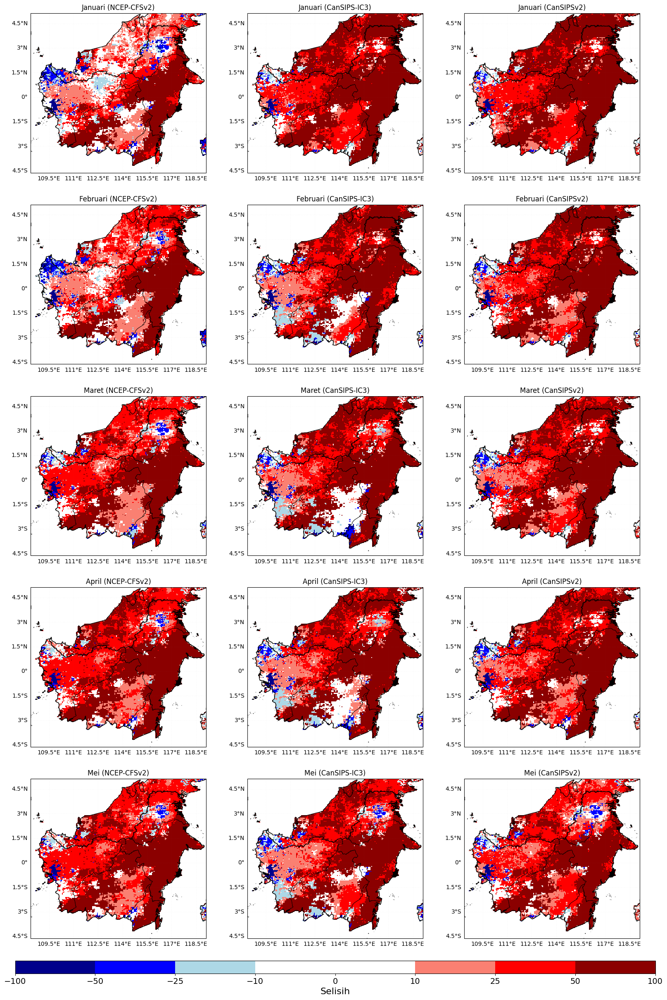

In [117]:
##### LA NINA

import xarray as xr
import numpy as np
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import geopandas as gpd
import cartopy.feature as cfeature

# Muat dataset hasil korelasi
correlation_dataset = xr.open_dataset('sensitivity_1998.nc')
# Ekstrak data dari dataset
latitude = correlation_dataset.latitude.values
longitude = correlation_dataset.longitude.values
months = correlation_dataset.month.values
correlation_data = correlation_dataset.sensitivity_1998.values

# Tentukan model untuk visualisasi
num_models = 3
num_months = 5
model_names = ["NCEP-CFSv2", "CanSIPS-IC3", "CanSIPSv2"]

# Buat figure dan axes untuk subplot
# fig, axes = plt.subplots(num_months, num_models, figsize=(30, 25), subplot_kw={'projection': ccrs.PlateCarree()})

# Buat figure dan axes untuk subplot dengan jarak antar subplot yang lebih kecil
fig, axes = plt.subplots(num_months, num_models, figsize=(20, 35), subplot_kw={'projection': ccrs.PlateCarree()}, 
                         gridspec_kw={'hspace': 0.2, 'wspace': 0.05})


# Load shapefile batas provinsi
shapefile_path = 'BATAS_PROVINSI_DESEMBER_2019_DUKCAPIL.shp'  # Ganti dengan path ke shapefile
gdf = gpd.read_file(shapefile_path)

# Filter shapefile sesuai dengan batas longitude dan latitude dari dataset korelasi
lon_min, lon_max = np.min(longitude), np.max(longitude)
lat_min, lat_max = np.min(latitude), np.max(latitude)
gdf = gdf.cx[lon_min:lon_max, lat_min:lat_max]

# Proyeksikan shapefile ke Plate Carree jika belum dalam format yang sesuai
gdf = gdf.to_crs(ccrs.PlateCarree().proj4_init)

import matplotlib.colors as mcolors

import matplotlib.colors as mcolors

# Buat colormap diskret dengan warna yang jelas dan tanpa gradasi
cmap_colors = ['darkblue', 'blue', 'lightblue', 'white', 'white', 'salmon', 'red', 'darkred']
cmap = mcolors.ListedColormap(cmap_colors)

# Tentukan batas-batas warna sesuai dengan interval yang diinginkan, misal setiap 25 unit
bounds = [-100, -50, -25, -10, 0, 10, 25, 50, 100]
norm = mcolors.BoundaryNorm(bounds, cmap.N)

# Plot dengan cmap dan norm yang telah disesuaikan
for i, month in enumerate(months):
    row = i % num_months
    col = i // num_months
    ax = axes[row, col]
    correlation = correlation_data[i, :, :]

    # Gunakan cmap dan norm yang telah disesuaikan
    mesh = ax.pcolormesh(longitude, latitude, correlation, cmap=cmap, norm=norm, shading='auto', transform=ccrs.PlateCarree())

    # Tambahkan fitur geografis
    ax.add_feature(cfeature.COASTLINE)
    ax.add_feature(cfeature.BORDERS)
    ax.add_feature(cfeature.LAND, edgecolor='black')
    ax.add_feature(cfeature.OCEAN, facecolor='white')

    # Plot batas provinsi dari shapefile menggunakan GeoPandas
    gdf.plot(ax=ax, edgecolor='black', facecolor='none', linewidth=0.5, transform=ccrs.PlateCarree())

    # Menambahkan gridline dan label
    gl = ax.gridlines(draw_labels=True, linewidth=0.5, color='gray', alpha=0.05, linestyle='--')
    gl.top_labels = False
    gl.right_labels = False

    ax.set_title(f'{month} ({model_names[col]})', fontsize=12)
    ax.set_extent([lon_min, lon_max, lat_min, lat_max], crs=ccrs.PlateCarree())

# Tambahkan colorbar dan atur layout
cbar = fig.colorbar(mesh, ax=axes.ravel().tolist(), orientation='horizontal', pad=0.02, aspect=50)
cbar.set_label('Selisih', fontsize=16)
cbar.ax.tick_params(labelsize=14)

plt.show()


In [94]:
global_min_rmse

-124.3363016764323

In [87]:
import xarray as xr

# Data prediksi rata-rata per tahun
pred_vars = [epred_var1, epred_var2, epred_var3, epred_var4, epred_var5,
             epred_var6, epred_var7, epred_var8, epred_var9, epred_var10,
             epred_var11, epred_var12, epred_var13, epred_var14, epred_var15]

# Definisikan koordinat
latitudes = data['latitude']
longitudes = data['longitude']
months = ['Januari', 'Februari', 'Maret', 'April', 'Mei']

# Membuat DataArray dengan dimensi yang diinginkan
dataarray = xr.DataArray(
    data=[pv.values for pv in pred_vars],  # Menggunakan nilai array dari masing-masing prediksi
    dims=['month', 'latitude', 'longitude'],   # Menentukan nama dimensi
   coords={
        'month': months * 3,  # 15 bulan karena 3 model (5 bulan per model)
        'latitude': latitudes,
        'longitude': longitudes
    },
    name='amh1998'  # Nama variabelnya adalah 'amhpr'
)
# Menampilkan informasi tentang DataArray
# print(dataarray)
# Simpan dataset ke file NetCDF
dataarray.to_netcdf('AMH1998_lanina_ASO.nc')


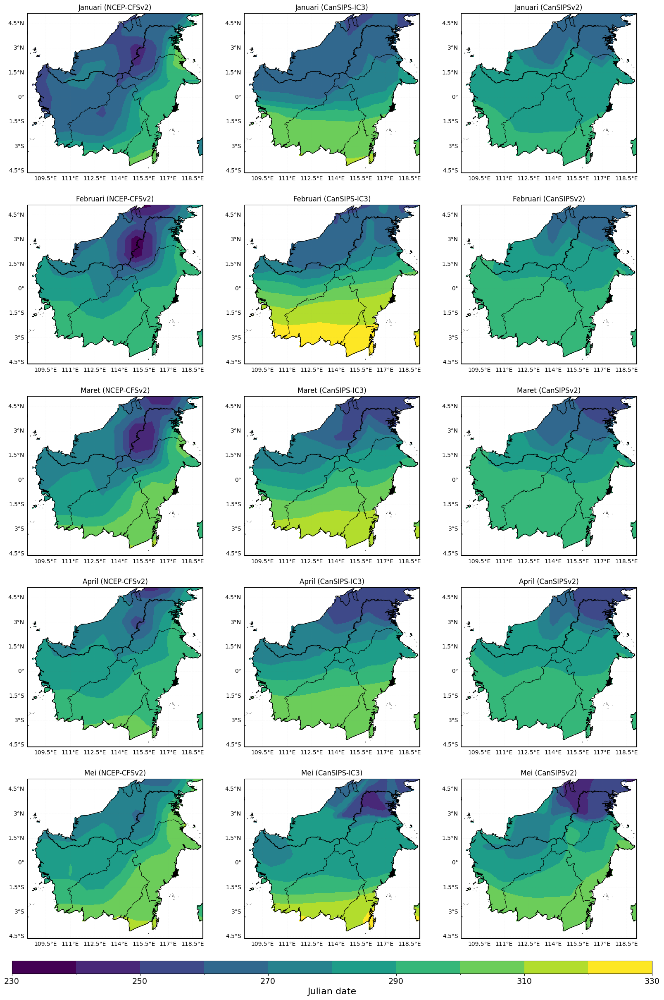

In [33]:
##### EL NINA

import xarray as xr
import numpy as np
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import geopandas as gpd
import cartopy.feature as cfeature
from matplotlib.colors import BoundaryNorm

# Muat dataset hasil korelasi
correlation_dataset = xr.open_dataset('AMH1997_elnina_ASO.nc')
# Ekstrak data dari dataset
latitude = correlation_dataset.latitude.values
longitude = correlation_dataset.longitude.values
months = correlation_dataset.month.values
correlation_data = correlation_dataset.amh1997.values

# Tentukan model untuk visualisasi
num_models = 3
num_months = 5
model_names = ["NCEP-CFSv2", "CanSIPS-IC3", "CanSIPSv2"]

# Buat figure dan axes untuk subplot
# fig, axes = plt.subplots(num_months, num_models, figsize=(30, 25), subplot_kw={'projection': ccrs.PlateCarree()})

# Buat figure dan axes untuk subplot dengan jarak antar subplot yang lebih kecil
fig, axes = plt.subplots(num_months, num_models, figsize=(20, 35), subplot_kw={'projection': ccrs.PlateCarree()}, 
                         gridspec_kw={'hspace': 0.2, 'wspace': 0.05})


# Load shapefile batas provinsi
shapefile_path = 'BATAS_PROVINSI_DESEMBER_2019_DUKCAPIL.shp'  # Ganti dengan path ke shapefile
gdf = gpd.read_file(shapefile_path)

# Filter shapefile sesuai dengan batas longitude dan latitude dari dataset korelasi
lon_min, lon_max = np.min(longitude), np.max(longitude)
lat_min, lat_max = np.min(latitude), np.max(latitude)
gdf = gdf.cx[lon_min:lon_max, lat_min:lat_max]

# Proyeksikan shapefile ke Plate Carree jika belum dalam format yang sesuai
gdf = gdf.to_crs(ccrs.PlateCarree().proj4_init)

# Atur warna dan batas warna
cmap = plt.cm.viridis
levels = np.arange(230, 340, 10)  # Batas warna per 10 unit dari -100 hingga 100
norm = BoundaryNorm(levels, ncolors=cmap.N, clip=True)
global_min_rmse = np.inf
global_max_rmse = -np.inf

# Iterasi melalui setiap bulan dan model
for i, month in enumerate(months):
    row = i % num_months
    col = i // num_months
    ax = axes[row, col]
    # Hitung nilai minimum dan maksimum RMSE untuk bulan ini
    local_min_rmse = np.nanmin(correlation_data)
    local_max_rmse = np.nanmax(correlation_data)

    # Update nilai minimum dan maksimum global RMSE
    global_min_rmse = min(global_min_rmse, local_min_rmse)
    global_max_rmse = max(global_max_rmse, local_max_rmse)
    # Plot korelasi untuk setiap model dan bulan
    correlation = correlation_data[i, :, :]  # Mengambil data untuk bulan tertentu
    
    # Menambahkan data pada peta
    mesh = ax.pcolormesh(longitude, latitude, correlation, cmap=cmap, norm=norm, shading='auto', transform=ccrs.PlateCarree())
    
    # Menambahkan fitur geografis
    ax.add_feature(cfeature.COASTLINE)
    ax.add_feature(cfeature.BORDERS)
    ax.add_feature(cfeature.LAND, edgecolor='black')
    ax.add_feature(cfeature.OCEAN, facecolor='white')
    
    # Plot batas provinsi dari shapefile menggunakan GeoPandas
    gdf.plot(ax=ax, edgecolor='black', facecolor='none', linewidth=0.5, transform=ccrs.PlateCarree())

    # # Menambahkan gridline dan label
    gl = ax.gridlines(draw_labels=True, linewidth=0.5, color='gray', alpha=0.05, linestyle='--')
    gl.top_labels = False
    gl.right_labels = False
    # Tambahkan garis batas sumbu manual (axes lines)
    ax.plot([longitudes.min(), longitudes.max()], [latitudes.min(), latitudes.min()], color='black', linewidth=1.5, transform=ccrs.PlateCarree())  # Garis horizontal bawah
    ax.plot([longitudes.min(), longitudes.max()], [latitudes.max(), latitudes.max()], color='black', linewidth=1.5, transform=ccrs.PlateCarree())  # Garis horizontal atas
    ax.plot([longitudes.min(), longitudes.min()], [latitudes.min(), latitudes.max()], color='black', linewidth=1.5, transform=ccrs.PlateCarree())  # Garis vertikal kiri
    ax.plot([longitudes.max(), longitudes.max()], [latitudes.min(), latitudes.max()], color='black', linewidth=1.5, transform=ccrs.PlateCarree())  # Garis vertikal kanan
    # Tambahkan label bulan dan model
    ax.set_title(f'{month} ({model_names[col]})', fontsize=12)
    # Tambahkan label latitude dan longitude tanpa garis grid
        
    # Set extent plot berdasarkan lon dan lat dari data korelasi
    ax.set_extent([lon_min, lon_max, lat_min, lat_max], crs=ccrs.PlateCarree())
    


# Sesuaikan layout subplot secara manual
plt.subplots_adjust(wspace=0.001, hspace=0.001)

# Tambahkan colorbar di bawah subplot
cbar = fig.colorbar(mesh, ax=axes.ravel().tolist(), orientation='horizontal', pad=0.02, aspect=50)
cbar.set_label('Julian date', fontsize=16)
# Perbesar teks pada colorbar
cbar.ax.tick_params(labelsize=14)



# Sesuaikan layout dan simpan gambar
# plt.tight_layout()
# plt.savefig('correlation_maps_cartopy.png', dpi=300, bbox_inches='tight')
plt.show()

# print("Visualisasi korelasi telah disimpan ke 'correlation_maps_cartopy.png'")


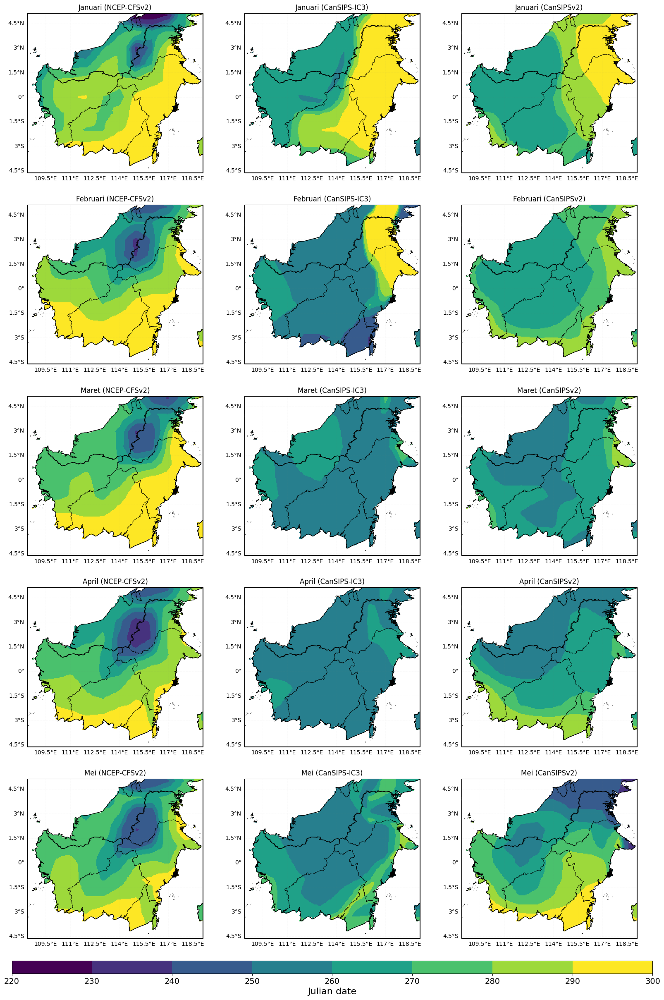

In [80]:
##### LA NINA

import xarray as xr
import numpy as np
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import geopandas as gpd
import cartopy.feature as cfeature

# Muat dataset hasil korelasi
correlation_dataset = xr.open_dataset('AMH1998_lanina_ASO.nc')
# Ekstrak data dari dataset
latitude = correlation_dataset.latitude.values
longitude = correlation_dataset.longitude.values
months = correlation_dataset.month.values
correlation_data = correlation_dataset.amh1998.values

# Tentukan model untuk visualisasi
num_models = 3
num_months = 5
model_names = ["NCEP-CFSv2", "CanSIPS-IC3", "CanSIPSv2"]

# Buat figure dan axes untuk subplot
# fig, axes = plt.subplots(num_months, num_models, figsize=(30, 25), subplot_kw={'projection': ccrs.PlateCarree()})

# Buat figure dan axes untuk subplot dengan jarak antar subplot yang lebih kecil
fig, axes = plt.subplots(num_months, num_models, figsize=(20, 35), subplot_kw={'projection': ccrs.PlateCarree()}, 
                         gridspec_kw={'hspace': 0.2, 'wspace': 0.05})


# Load shapefile batas provinsi
shapefile_path = 'BATAS_PROVINSI_DESEMBER_2019_DUKCAPIL.shp'  # Ganti dengan path ke shapefile
gdf = gpd.read_file(shapefile_path)

# Filter shapefile sesuai dengan batas longitude dan latitude dari dataset korelasi
lon_min, lon_max = np.min(longitude), np.max(longitude)
lat_min, lat_max = np.min(latitude), np.max(latitude)
gdf = gdf.cx[lon_min:lon_max, lat_min:lat_max]

# Proyeksikan shapefile ke Plate Carree jika belum dalam format yang sesuai
gdf = gdf.to_crs(ccrs.PlateCarree().proj4_init)

# Atur warna dan batas warna
# Atur warna dan batas warna
cmap = plt.cm.viridis
levels = np.arange(220, 310, 10)  # Batas warna per 10 unit dari -100 hingga 100
norm = BoundaryNorm(levels, ncolors=cmap.N, clip=True)
# cmap = plt.cm.RdBu_r 
# Inisialisasi variabel untuk menyimpan nilai minimum dan maksimum RMSE
global_min_rmse = np.inf
global_max_rmse = -np.inf

# Iterasi melalui setiap bulan dan model
for i, month in enumerate(months):
    row = i % num_months
    col = i // num_months
    ax = axes[row, col]
    # Hitung nilai minimum dan maksimum RMSE untuk bulan ini
    local_min_rmse = np.nanmin(correlation_data)
    local_max_rmse = np.nanmax(correlation_data)

    # Update nilai minimum dan maksimum global RMSE
    global_min_rmse = min(global_min_rmse, local_min_rmse)
    global_max_rmse = max(global_max_rmse, local_max_rmse)
    # Plot korelasi untuk setiap model dan bulan
    correlation = correlation_data[i, :, :]  # Mengambil data untuk bulan tertentu
    
    # Menambahkan data pada peta
    mesh = ax.pcolormesh(longitude, latitude, correlation, cmap="viridis", norm=norm, shading='auto', transform=ccrs.PlateCarree())
    
    # Menambahkan fitur geografis
    ax.add_feature(cfeature.COASTLINE)
    ax.add_feature(cfeature.BORDERS)
    ax.add_feature(cfeature.LAND, edgecolor='black')
    ax.add_feature(cfeature.OCEAN, facecolor='white')
    
    # Plot batas provinsi dari shapefile menggunakan GeoPandas
    gdf.plot(ax=ax, edgecolor='black', facecolor='none', linewidth=0.5, transform=ccrs.PlateCarree())

    # # Menambahkan gridline dan label
    gl = ax.gridlines(draw_labels=True, linewidth=0.5, color='gray', alpha=0.05, linestyle='--')
    gl.top_labels = False
    gl.right_labels = False
    # Tambahkan garis batas sumbu manual (axes lines)
    ax.plot([longitudes.min(), longitudes.max()], [latitudes.min(), latitudes.min()], color='black', linewidth=1.5, transform=ccrs.PlateCarree())  # Garis horizontal bawah
    ax.plot([longitudes.min(), longitudes.max()], [latitudes.max(), latitudes.max()], color='black', linewidth=1.5, transform=ccrs.PlateCarree())  # Garis horizontal atas
    ax.plot([longitudes.min(), longitudes.min()], [latitudes.min(), latitudes.max()], color='black', linewidth=1.5, transform=ccrs.PlateCarree())  # Garis vertikal kiri
    ax.plot([longitudes.max(), longitudes.max()], [latitudes.min(), latitudes.max()], color='black', linewidth=1.5, transform=ccrs.PlateCarree())  # Garis vertikal kanan
    # Tambahkan label bulan dan model
    ax.set_title(f'{month} ({model_names[col]})', fontsize=12)
    # Tambahkan label latitude dan longitude tanpa garis grid
        
    # Set extent plot berdasarkan lon dan lat dari data korelasi
    ax.set_extent([lon_min, lon_max, lat_min, lat_max], crs=ccrs.PlateCarree())
    


# Sesuaikan layout subplot secara manual
plt.subplots_adjust(wspace=0.001, hspace=0.001)

# Tambahkan colorbar di bawah subplot
cbar = fig.colorbar(mesh, ax=axes.ravel().tolist(), orientation='horizontal', pad=0.02, aspect=50)
cbar.set_label('Julian date', fontsize=16)
# Perbesar teks pada colorbar
cbar.ax.tick_params(labelsize=14)



# Sesuaikan layout dan simpan gambar
# plt.tight_layout()
# plt.savefig('correlation_maps_cartopy.png', dpi=300, bbox_inches='tight')
plt.show()

# print("Visualisasi korelasi telah disimpan ke 'correlation_maps_cartopy.png'")


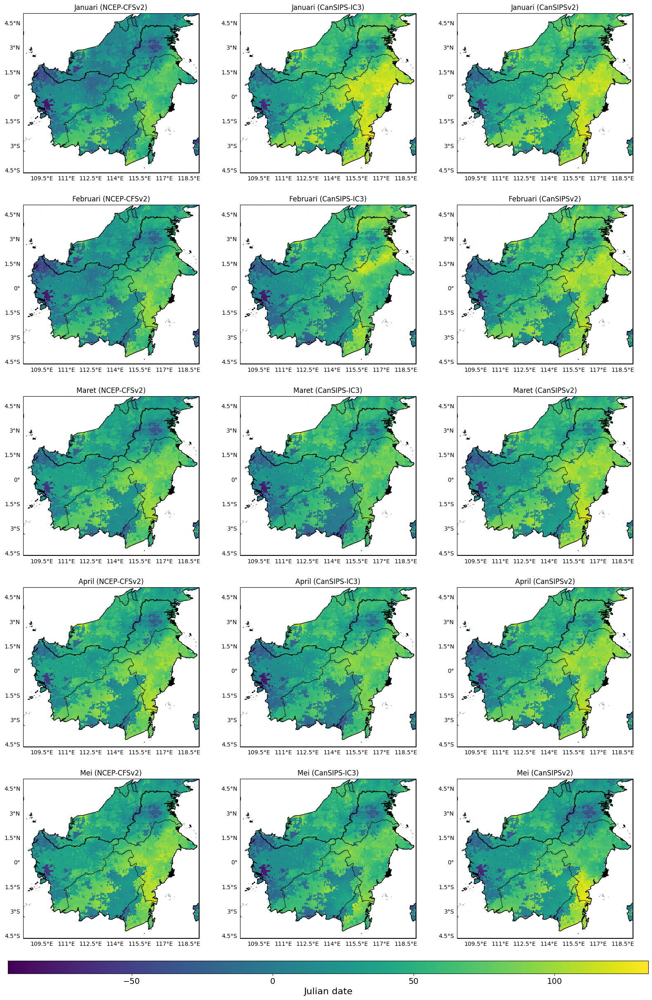

In [116]:
import xarray as xr
import numpy as np
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature

# Muat dataset hasil korelasi
correlation_dataset = xr.open_dataset('sensitivity_1998.nc')
# Ekstrak data dari dataset
latitude = correlation_dataset.latitude.values
longitude = correlation_dataset.longitude.values
months = correlation_dataset.month.values
correlation_data = correlation_dataset.sensitivity_1998.values

# Tentukan model untuk visualisasi
num_models = 3
num_months = 5
model_names = ["NCEP-CFSv2", "CanSIPS-IC3", "CanSIPSv2"]

# Buat figure dan axes untuk subplot
# fig, axes = plt.subplots(num_months, num_models, figsize=(30, 25), subplot_kw={'projection': ccrs.PlateCarree()})

# Buat figure dan axes untuk subplot dengan jarak antar subplot yang lebih kecil
fig, axes = plt.subplots(num_months, num_models, figsize=(20, 35), subplot_kw={'projection': ccrs.PlateCarree()}, 
                         gridspec_kw={'hspace': 0.2, 'wspace': 0.05})


# Load shapefile batas provinsi
shapefile_path = 'BATAS_PROVINSI_DESEMBER_2019_DUKCAPIL.shp'  # Ganti dengan path ke shapefile
gdf = gpd.read_file(shapefile_path)

# Filter shapefile sesuai dengan batas longitude dan latitude dari dataset korelasi
lon_min, lon_max = np.min(longitude), np.max(longitude)
lat_min, lat_max = np.min(latitude), np.max(latitude)
gdf = gdf.cx[lon_min:lon_max, lat_min:lat_max]

# Proyeksikan shapefile ke Plate Carree jika belum dalam format yang sesuai
gdf = gdf.to_crs(ccrs.PlateCarree().proj4_init)

# Atur warna dan batas warna
# cmap = plt.cm.RdBu_r 
# Inisialisasi variabel untuk menyimpan nilai minimum dan maksimum RMSE
global_min_rmse = np.inf
global_max_rmse = -np.inf

# Iterasi melalui setiap bulan dan model
for i, month in enumerate(months):
    row = i % num_months
    col = i // num_months
    ax = axes[row, col]
    # Hitung nilai minimum dan maksimum RMSE untuk bulan ini
    local_min_rmse = np.nanmin(correlation_data)
    local_max_rmse = np.nanmax(correlation_data)

    # Update nilai minimum dan maksimum global RMSE
    global_min_rmse = min(global_min_rmse, local_min_rmse)
    global_max_rmse = max(global_max_rmse, local_max_rmse)
    # Plot korelasi untuk setiap model dan bulan
    correlation = correlation_data[i, :, :]  # Mengambil data untuk bulan tertentu
    
    # Menambahkan data pada peta
    mesh = ax.pcolormesh(longitude, latitude, correlation, cmap="viridis", vmin=global_min_rmse, vmax=global_max_rmse, shading='auto', transform=ccrs.PlateCarree())
    
    # Menambahkan fitur geografis
    ax.add_feature(cfeature.COASTLINE)
    ax.add_feature(cfeature.BORDERS)
    ax.add_feature(cfeature.LAND, edgecolor='black')
    ax.add_feature(cfeature.OCEAN, facecolor='white')
    
    # Plot batas provinsi dari shapefile menggunakan GeoPandas
    gdf.plot(ax=ax, edgecolor='black', facecolor='none', linewidth=0.5, transform=ccrs.PlateCarree())

    # # Menambahkan gridline dan label
    gl = ax.gridlines(draw_labels=True, linewidth=0.5, color='gray', alpha=0.05, linestyle='--')
    gl.top_labels = False
    gl.right_labels = False
    # Tambahkan garis batas sumbu manual (axes lines)
    ax.plot([longitudes.min(), longitudes.max()], [latitudes.min(), latitudes.min()], color='black', linewidth=1.5, transform=ccrs.PlateCarree())  # Garis horizontal bawah
    ax.plot([longitudes.min(), longitudes.max()], [latitudes.max(), latitudes.max()], color='black', linewidth=1.5, transform=ccrs.PlateCarree())  # Garis horizontal atas
    ax.plot([longitudes.min(), longitudes.min()], [latitudes.min(), latitudes.max()], color='black', linewidth=1.5, transform=ccrs.PlateCarree())  # Garis vertikal kiri
    ax.plot([longitudes.max(), longitudes.max()], [latitudes.min(), latitudes.max()], color='black', linewidth=1.5, transform=ccrs.PlateCarree())  # Garis vertikal kanan
    # Tambahkan label bulan dan model
    ax.set_title(f'{month} ({model_names[col]})', fontsize=12)
    # Tambahkan label latitude dan longitude tanpa garis grid
        
    # Set extent plot berdasarkan lon dan lat dari data korelasi
    ax.set_extent([lon_min, lon_max, lat_min, lat_max], crs=ccrs.PlateCarree())
    


# Sesuaikan layout subplot secara manual
plt.subplots_adjust(wspace=0.001, hspace=0.001)

# Tambahkan colorbar di bawah subplot
cbar = fig.colorbar(mesh, ax=axes.ravel().tolist(), orientation='horizontal', pad=0.02, aspect=50)
cbar.set_label('Julian date', fontsize=16)
# Perbesar teks pada colorbar
cbar.ax.tick_params(labelsize=14)



# Sesuaikan layout dan simpan gambar
# plt.tight_layout()
# plt.savefig('correlation_maps_cartopy.png', dpi=300, bbox_inches='tight')
plt.show()

# print("Visualisasi korelasi telah disimpan ke 'correlation_maps_cartopy.png'")


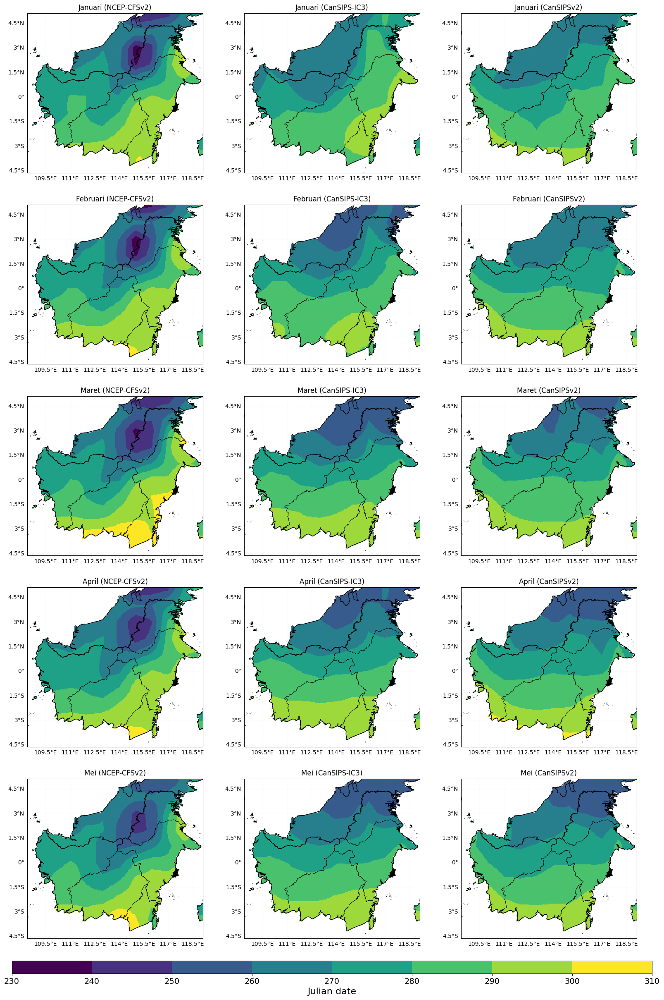

In [20]:
import xarray as xr
import numpy as np
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import geopandas as gpd
from matplotlib.colors import BoundaryNorm

# Muat dataset hasil korelasi
correlation_dataset = xr.open_dataset('AMHRata_ASO.nc')
# Ekstrak data dari dataset
latitude = correlation_dataset.latitude.values
longitude = correlation_dataset.longitude.values
months = correlation_dataset.month.values
correlation_data = correlation_dataset.amhpr.values

# Tentukan model untuk visualisasi
num_models = 3
num_months = 5
model_names = ["NCEP-CFSv2", "CanSIPS-IC3", "CanSIPSv2"]

# Buat figure dan axes untuk subplot dengan jarak antar subplot yang lebih kecil
fig, axes = plt.subplots(num_months, num_models, figsize=(20, 35), subplot_kw={'projection': ccrs.PlateCarree()}, 
                         gridspec_kw={'hspace': 0.2, 'wspace': 0.05})

# Load shapefile batas provinsi
shapefile_path = 'BATAS_PROVINSI_DESEMBER_2019_DUKCAPIL.shp'  # Ganti dengan path ke shapefile
gdf = gpd.read_file(shapefile_path)

# Filter shapefile sesuai dengan batas longitude dan latitude dari dataset korelasi
lon_min, lon_max = np.min(longitude), np.max(longitude)
lat_min, lat_max = np.min(latitude), np.max(latitude)
gdf = gdf.cx[lon_min:lon_max, lat_min:lat_max]

# Proyeksikan shapefile ke Plate Carree jika belum dalam format yang sesuai
gdf = gdf.to_crs(ccrs.PlateCarree().proj4_init)

# Atur warna dan batas warna
cmap = plt.cm.viridis
levels = np.arange(230, 320, 10)  # Batas warna per 10 unit dari -100 hingga 100
norm = BoundaryNorm(levels, ncolors=cmap.N, clip=True)

# Iterasi melalui setiap bulan dan model
for i, month in enumerate(months):
    row = i % num_months
    col = i // num_months
    ax = axes[row, col]
    
    # Plot korelasi untuk setiap model dan bulan
    correlation = correlation_data[i, :, :]  # Mengambil data untuk bulan tertentu
    
    # Menambahkan data pada peta
    mesh = ax.pcolormesh(longitude, latitude, correlation, cmap=cmap, norm=norm, shading='auto', transform=ccrs.PlateCarree())
    
    # Menambahkan fitur geografis
    ax.add_feature(cfeature.COASTLINE)
    ax.add_feature(cfeature.BORDERS)
    ax.add_feature(cfeature.LAND, edgecolor='black')
    ax.add_feature(cfeature.OCEAN, facecolor='white')
    
    # Plot batas provinsi dari shapefile menggunakan GeoPandas
    gdf.plot(ax=ax, edgecolor='black', facecolor='none', linewidth=0.5, transform=ccrs.PlateCarree())

    # Tambahkan gridline dan label
    gl = ax.gridlines(draw_labels=True, linewidth=0.5, color='gray', alpha=0.05, linestyle='--')
    gl.top_labels = False
    gl.right_labels = False
    
    # Tambahkan label bulan dan model
    ax.set_title(f'{month} ({model_names[col]})', fontsize=12)
        
    # Set extent plot berdasarkan lon dan lat dari data korelasi
    ax.set_extent([lon_min, lon_max, lat_min, lat_max], crs=ccrs.PlateCarree())
    
# Sesuaikan layout subplot secara manual
plt.subplots_adjust(wspace=0.001, hspace=0.001)

# Tambahkan colorbar di bawah subplot
cbar = fig.colorbar(mesh, ax=axes.ravel().tolist(), orientation='horizontal', pad=0.02, aspect=50)
cbar.set_label('Julian date', fontsize=16)
# Perbesar teks pada colorbar
cbar.ax.tick_params(labelsize=14)

# Tampilkan peta
plt.show()


In [16]:
import xarray as xr
import numpy as np
from scipy.stats import pearsonr

# Fungsi untuk menghitung RMSE
def calculate_rmse(prediction, observation):
    return np.sqrt(np.mean((prediction - observation) ** 2))

# Memuat dataset observasi
data_observasi = xr.open_dataset('AMH_with_Median.nc')
obs_var = data_observasi['AMH']

# Memuat dataset prediksi
datasets = [
    'predictedCFSJanuariFix.nc',
    'predictedCFSFebruari.nc',
    'predictedCFSMaret.nc',
    'predictedCFSApril.nc',
    'predictedCFSMei.nc',
    'predictedIC3Januari.nc',
    'predictedIC3Februari.nc',
    'predictedIC3Maret.nc',
    'predictedIC3April.nc',
    'predictedIC3Mei.nc',
    'predictedCansipsv2Januari.nc',
    'predictedCansipsv2Februari.nc',
    'predictedCansipsv2Maret.nc',
    'predictedCansipsv2April.nc',
    'predictedCansipsv2Mei.nc'
]

std_devs = []
correlations = []
rmses = []

for ds in datasets:
    data_prediksi = xr.open_dataset(ds)
    pred_var = data_prediksi['AMHp']

    obs_flat = obs_var.values.flatten()
    pred_flat = pred_var.values.flatten()

    std_pred = np.std(pred_flat)
    correlation = pearsonr(pred_flat, obs_flat)[0]
    rmse = calculate_rmse(pred_flat, obs_flat)

    std_devs.append(std_pred)
    correlations.append(correlation)
    rmses.append(rmse)

# Standar deviasi data observasi
std_obs = np.std(obs_var.values.flatten())


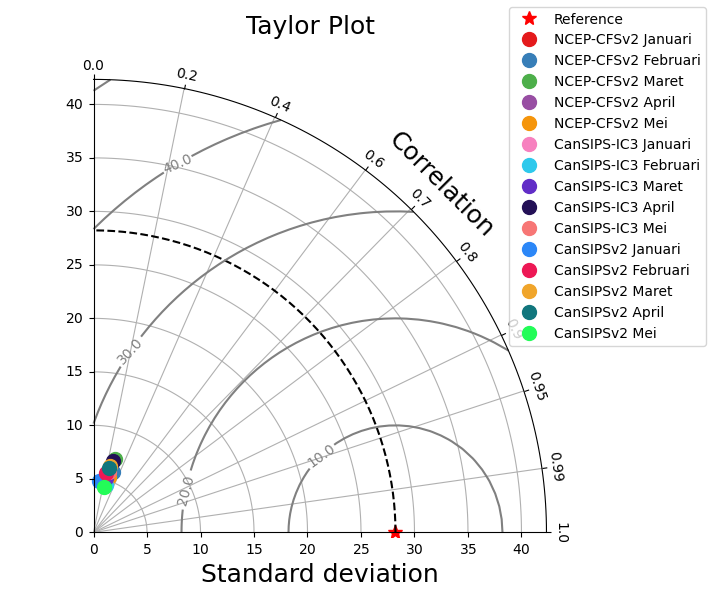

In [35]:
import numpy as np
import xarray as xr
from easy_mpl import taylor_plot

# Muat dataset observasi
data_observasi = xr.open_dataset('AMH_with_Median.nc')
obs_var = data_observasi['AMH'].values.flatten()

# Muat dataset prediksi dan flatten datanya
data_prediksi1 = xr.open_dataset('stdanol_predictedCFSJanuari.nc')['AMHp'].values.flatten()
data_prediksi2 = xr.open_dataset('stdanol_predictedCFSFebruari.nc')['AMHp'].values.flatten()
data_prediksi3 = xr.open_dataset('stdanol_predictedCFSMaret.nc')['AMHp'].values.flatten()
data_prediksi4 = xr.open_dataset('stdanol_predictedCFSApril.nc')['AMHp'].values.flatten()
data_prediksi5 = xr.open_dataset('stdanol_predictedCFSMei.nc')['AMHp'].values.flatten()
data_prediksi6 = xr.open_dataset('stdanol_predictedIC3Januari.nc')['AMHp'].values.flatten()
data_prediksi7 = xr.open_dataset('stdanol_predictedIC3Februari.nc')['AMHp'].values.flatten()
data_prediksi8 = xr.open_dataset('stdanol_predictedIC3Maret.nc')['AMHp'].values.flatten()
data_prediksi9 = xr.open_dataset('stdanol_predictedIC3April.nc')['AMHp'].values.flatten()
data_prediksi10 = xr.open_dataset('stdanol_predictedIC3Mei.nc')['AMHp'].values.flatten()
data_prediksi11 = xr.open_dataset('stdanol_predictedCansipv2Januari.nc')['AMHp'].values.flatten()
data_prediksi12 = xr.open_dataset('stdanol_predictedCansipv2Februari.nc')['AMHp'].values.flatten()
data_prediksi13 = xr.open_dataset('stdanol_predictedCansipv2Maret.nc')['AMHp'].values.flatten()
data_prediksi14 = xr.open_dataset('stdanol_predictedCansipv2April.nc')['AMHp'].values.flatten()
data_prediksi15 = xr.open_dataset('stdanol_predictedCansipv2Mei.nc')['AMHp'].values.flatten()

# Simpan data prediksi dalam dictionary
simulations = {
    "NCEP-CFSv2 Januari": data_prediksi1,
    "NCEP-CFSv2 Februari": data_prediksi2,
    "NCEP-CFSv2 Maret": data_prediksi3,
    "NCEP-CFSv2 April": data_prediksi4,
    "NCEP-CFSv2 Mei": data_prediksi5,
    "CanSIPS-IC3 Januari": data_prediksi6,
    "CanSIPS-IC3 Februari": data_prediksi7,
    "CanSIPS-IC3 Maret": data_prediksi8,
    "CanSIPS-IC3 April": data_prediksi9,
    "CanSIPS-IC3 Mei": data_prediksi10,
    "CanSIPSv2 Januari": data_prediksi11,
    "CanSIPSv2 Februari": data_prediksi12,
    "CanSIPSv2 Maret": data_prediksi13,
    "CanSIPSv2 April": data_prediksi14,
    "CanSIPSv2 Mei": data_prediksi15,
}

# Buat Taylor Plot
_ = taylor_plot(observations=obs_var,
                simulations=simulations,
                title="Taylor Plot")


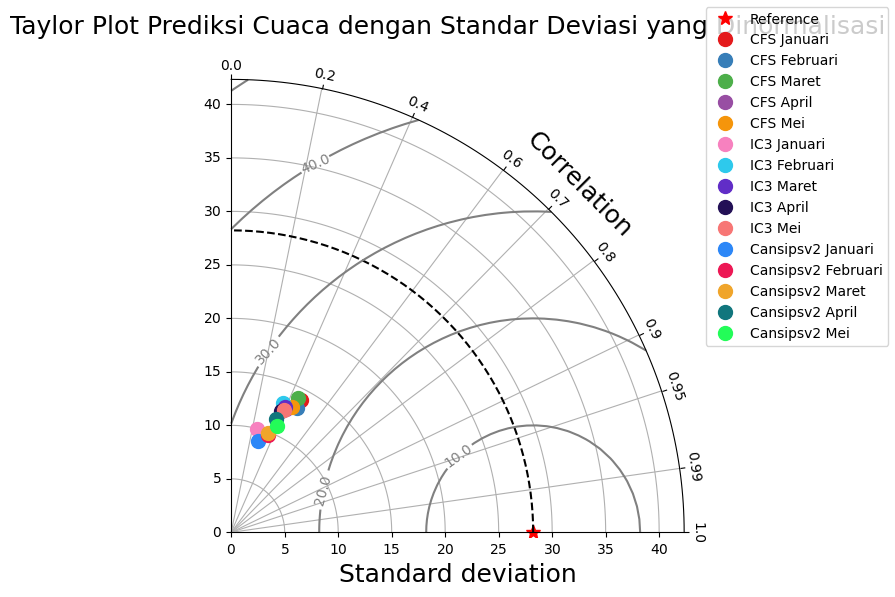

CFS Januari: Standar Deviasi Dinormalisasi = 0.49
CFS Februari: Standar Deviasi Dinormalisasi = 0.47
CFS Maret: Standar Deviasi Dinormalisasi = 0.50
CFS April: Standar Deviasi Dinormalisasi = 0.45
CFS Mei: Standar Deviasi Dinormalisasi = 0.46
IC3 Januari: Standar Deviasi Dinormalisasi = 0.35
IC3 Februari: Standar Deviasi Dinormalisasi = 0.46
IC3 Maret: Standar Deviasi Dinormalisasi = 0.45
IC3 April: Standar Deviasi Dinormalisasi = 0.43
IC3 Mei: Standar Deviasi Dinormalisasi = 0.44
Cansipsv2 Januari: Standar Deviasi Dinormalisasi = 0.32
Cansipsv2 Februari: Standar Deviasi Dinormalisasi = 0.34
Cansipsv2 Maret: Standar Deviasi Dinormalisasi = 0.35
Cansipsv2 April: Standar Deviasi Dinormalisasi = 0.40
Cansipsv2 Mei: Standar Deviasi Dinormalisasi = 0.38


In [17]:
import numpy as np
import xarray as xr
from easy_mpl import taylor_plot

# Muat dataset observasi
data_observasi = xr.open_dataset('AMH_with_Median.nc')
obs_var = data_observasi['AMH'].values.flatten()

# Muat dataset prediksi dan flatten datanya
datasets_prediksi = [
    'PreASO_CFSJanuari.nc', 'PreASO_CFSFebruari.nc', 'PreASO_CFSMaret.nc',
    'PreASO_CFSApril.nc', 'PreASO_CFSMei.nc', 'PreASO_IC3Januari.nc',
    'PreASO_IC3Februari.nc', 'PreASO_IC3Maret.nc', 'PreASO_IC3April.nc',
    'PreASO_IC3Mei.nc', 'PreASO_Cansipv2Januari.nc', 'PreASO_Cansipv2Februari.nc',
    'PreASO_Cansipv2Maret.nc', 'PreASO_Cansipv2April.nc', 'PreASO_Cansipv2Mei.nc'
]

labels = [
    "CFS Januari",
    "CFS Februari",
    "CFS Maret",
    "CFS April",
    "CFS Mei",
    "IC3 Januari",
    "IC3 Februari",
    "IC3 Maret",
    "IC3 April",
    "IC3 Mei",
    "Cansipsv2 Januari",
    "Cansipsv2 Februari",
    "Cansipsv2 Maret",
    "Cansipsv2 April",
    "Cansipsv2 Mei"
]

simulations = {}

for dataset, label in zip(datasets_prediksi, labels):
    data_prediksi = xr.open_dataset(dataset)['AMHp'].values.flatten()
    simulations[label] = data_prediksi

# Hitung standar deviasi dari observasi
std_obs = np.std(obs_var)

# Hitung standar deviasi dari prediksi dan normalisasi
stddev_normalized = {name: np.std(data) / std_obs for name, data in simulations.items()}

# Taylor plot with normalized standard deviations
_ = taylor_plot(
    observations=obs_var,
    simulations=simulations,
    title="Taylor Plot Prediksi Cuaca dengan Standar Deviasi yang Dinormalisasi",
    normalize_stddev=True
)

# Mencetak standar deviasi yang dinormalisasi untuk validasi
for name, std in stddev_normalized.items():
    print(f"{name}: Standar Deviasi Dinormalisasi = {std:.2f}")


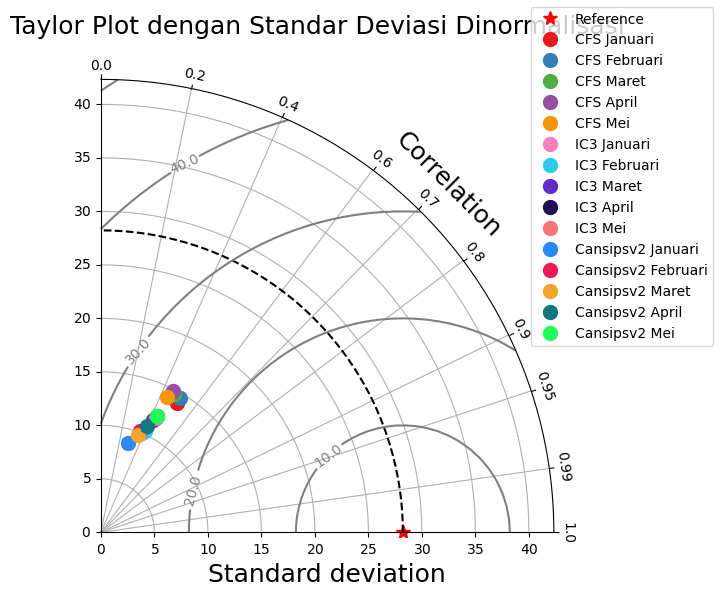

CFS Januari: Standar Deviasi = 0.50, Korelasi = 0.51, RMSE = 0.86
CFS Februari: Standar Deviasi = 0.52, Korelasi = 0.51, RMSE = 0.86
CFS Maret: Standar Deviasi = 0.52, Korelasi = 0.47, RMSE = 0.89
CFS April: Standar Deviasi = 0.53, Korelasi = 0.46, RMSE = 0.89
CFS Mei: Standar Deviasi = 0.50, Korelasi = 0.44, RMSE = 0.90
IC3 Januari: Standar Deviasi = 0.36, Korelasi = 0.38, RMSE = 0.93
IC3 Februari: Standar Deviasi = 0.36, Korelasi = 0.40, RMSE = 0.92
IC3 Maret: Standar Deviasi = 0.41, Korelasi = 0.42, RMSE = 0.91
IC3 April: Standar Deviasi = 0.43, Korelasi = 0.43, RMSE = 0.90
IC3 Mei: Standar Deviasi = 0.42, Korelasi = 0.44, RMSE = 0.90
Cansipsv2 Januari: Standar Deviasi = 0.31, Korelasi = 0.29, RMSE = 0.96
Cansipsv2 Februari: Standar Deviasi = 0.36, Korelasi = 0.36, RMSE = 0.93
Cansipsv2 Maret: Standar Deviasi = 0.34, Korelasi = 0.35, RMSE = 0.94
Cansipsv2 April: Standar Deviasi = 0.38, Korelasi = 0.40, RMSE = 0.92
Cansipsv2 Mei: Standar Deviasi = 0.43, Korelasi = 0.43, RMSE = 0.90


In [17]:
import numpy as np
import xarray as xr
from easy_mpl import taylor_plot

# Muat dataset observasi
data_observasi = xr.open_dataset('AMH_with_Median.nc')
obs_var = data_observasi['AMH'].values.flatten()

# Muat dataset prediksi dan flatten datanya
datasets_prediksi = [
    'predictedCFSJanuariFix.nc',
    'predictedCFSFebruari.nc',
    'predictedCFSMaret.nc',
    'predictedCFSApril.nc',
    'predictedCFSMei.nc',
    'predictedIC3Januari.nc',
    'predictedIC3Februari.nc',
    'predictedIC3Maret.nc',
    'predictedIC3April.nc',
    'predictedIC3Mei.nc',
    'predictedCansipsv2Januari.nc',
    'predictedCansipsv2Februari.nc',
    'predictedCansipsv2Maret.nc',
    'predictedCansipsv2April.nc',
    'predictedCansipsv2Mei.nc'
]

labels = [
    "CFS Januari",
    "CFS Februari",
    "CFS Maret",
    "CFS April",
    "CFS Mei",
    "IC3 Januari",
    "IC3 Februari",
    "IC3 Maret",
    "IC3 April",
    "IC3 Mei",
    "Cansipsv2 Januari",
    "Cansipsv2 Februari",
    "Cansipsv2 Maret",
    "Cansipsv2 April",
    "Cansipsv2 Mei"
]

simulations = {}

for dataset, label in zip(datasets_prediksi, labels):
    data_prediksi = xr.open_dataset(dataset)['AMHp'].values.flatten()
    simulations[label] = data_prediksi

# Hitung standar deviasi dari observasi
std_obs = np.std(obs_var)

# Normalisasi standar deviasi dari prediksi
simulations_normalized = {name: np.std(data) / std_obs for name, data in simulations.items()}

# Hitung RMSE dan korelasi
rmse = {name: np.sqrt(np.mean((data - obs_var) ** 2)) / std_obs for name, data in simulations.items()}
correlation = {name: np.corrcoef(obs_var, data)[0, 1] for name, data in simulations.items()}

# Buat list untuk Taylor Plot
simulations_data = [
    {
        "name": name,
        "stddev": simulations_normalized[name],
        "corr_coeff": correlation[name],
        "rmse": rmse[name]
    }
    for name in simulations_normalized
]

# Buat Taylor Plot dengan data yang dinormalisasi
_ = taylor_plot(
    observations=obs_var,
    simulations=simulations,
    stddev_normalize=True,
    title="Taylor Plot dengan Standar Deviasi Dinormalisasi",
    simulations_data=simulations_data
)

# Cetak hasil untuk validasi
for sim in simulations_data:
    print(f"{sim['name']}: Standar Deviasi = {sim['stddev']:.2f}, Korelasi = {sim['corr_coeff']:.2f}, RMSE = {sim['rmse']:.2f}")


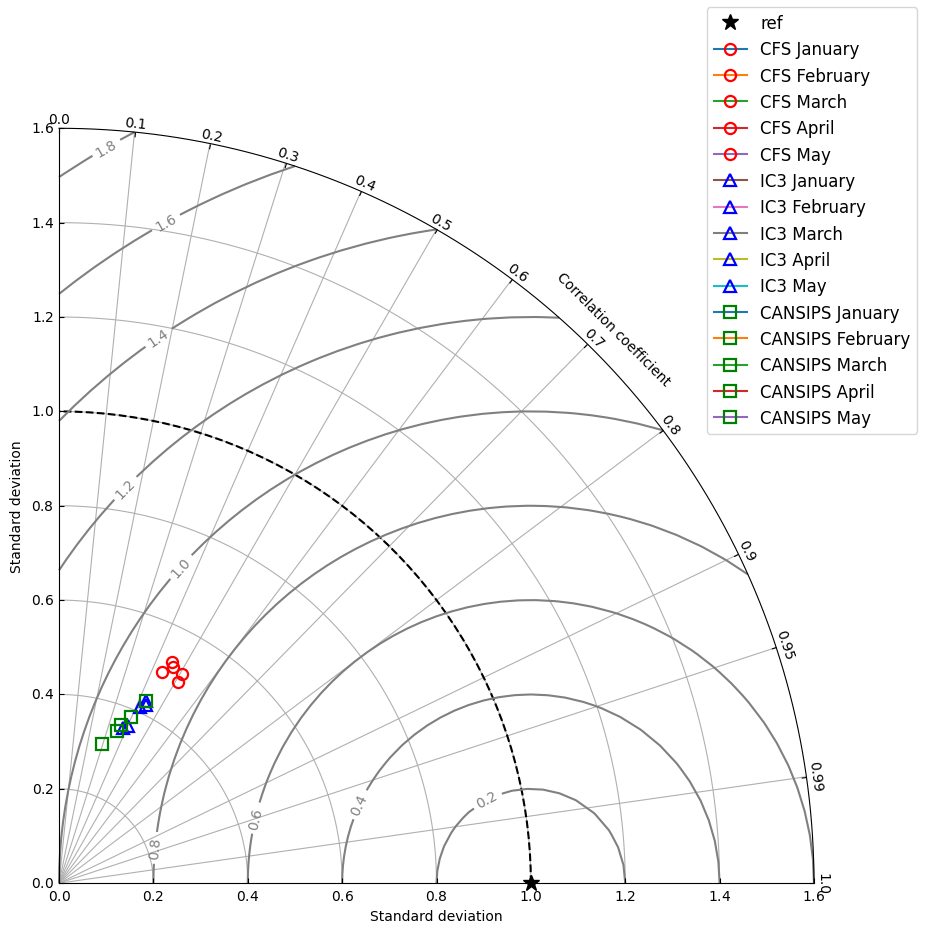

In [12]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.projections import PolarAxes
import mpl_toolkits.axisartist.grid_finder as gf
import mpl_toolkits.axisartist.floating_axes as fa
import xarray as xr

class TaylorDiagram(object):
    def __init__(self, STD, fig=None, rect=111, label='_'):
        self.STD = STD
        tr = PolarAxes.PolarTransform()
        # Correlation labels
        rlocs = np.concatenate(((np.arange(11.0) / 10.0), [0.95, 0.99]))
        tlocs = np.arccos(rlocs) # Conversion to polar angles
        gl1 = gf.FixedLocator(tlocs) # Positions
        tf1 = gf.DictFormatter(dict(zip(tlocs, map(str, rlocs))))
        # Standard deviation axis extent
        self.smin = 0
        self.smax = 1.6
        gh = fa.GridHelperCurveLinear(tr, extremes=(0, (np.pi/2), self.smin, self.smax), grid_locator1=gl1, tick_formatter1=tf1)
        if fig is None:
            fig = plt.figure()
        ax = fa.FloatingSubplot(fig, rect, grid_helper=gh)
        fig.add_subplot(ax)
        # Angle axis
        ax.axis['top'].set_axis_direction('bottom')
        ax.axis['top'].label.set_text("Correlation coefficient")
        ax.axis['top'].toggle(ticklabels=True, label=True)
        ax.axis['top'].major_ticklabels.set_axis_direction('top')
        ax.axis['top'].label.set_axis_direction('top')
        # X axis
        ax.axis['left'].set_axis_direction('bottom')
        ax.axis['left'].label.set_text("Standard deviation")
        ax.axis['left'].toggle(ticklabels=True, label=True)
        ax.axis['left'].major_ticklabels.set_axis_direction('bottom')
        ax.axis['left'].label.set_axis_direction('bottom')
        # Y axis
        ax.axis['right'].set_axis_direction('top')
        ax.axis['right'].label.set_text("Standard deviation")
        ax.axis['right'].toggle(ticklabels=True, label=True)
        ax.axis['right'].major_ticklabels.set_axis_direction('left')
        ax.axis['right'].label.set_axis_direction('top')
        # Useless
        ax.axis['bottom'].set_visible(False)
        # Contours along standard deviations
        ax.grid()
        self._ax = ax # Graphical axes
        self.ax = ax.get_aux_axes(tr) # Polar coordinates
        # Add reference point and STD contour
        l, = self.ax.plot([0], 1, 'k*', ls='', ms=12, label=label)
        t = np.linspace(0, (np.pi / 2.0))
        r = np.zeros_like(t) + 1
        self.ax.plot(t, r, 'k--', label='_')
        # Collect sample points for latter use (e.g. legend)
        self.samplePoints = [l]

    def add_sample(self, STD, r, *args, **kwargs):
        l, = self.ax.plot(np.arccos(r), STD, *args, **kwargs) # (theta, radius)
        self.samplePoints.append(l)
        return l

    def add_contours(self, levels=5, **kwargs):
        rs, ts = np.meshgrid(np.linspace(self.smin, self.smax), np.linspace(0, (np.pi / 2.0)))
        RMSE = np.sqrt(1 + np.power(rs, 2) - (2.0 * rs * np.cos(ts)))
        contours = self.ax.contour(ts, rs, RMSE, levels, **kwargs)
        return contours

def srl(obsSTD, s_cfs, s_ic3, s_cansips, r_cfs, r_ic3, r_cansips, l_cfs, l_ic3, l_cansips, fname):
    fig = plt.figure(figsize=(10, 10))
    dia = TaylorDiagram(obsSTD, fig=fig, rect=111, label='ref')
    plt.clabel(dia.add_contours(levels=np.arange(0.2, 2.0, 0.2), colors='#808080'), inline=1, fontsize=10)
    
    srlc_cfs = zip(s_cfs, r_cfs, l_cfs)
    srlc_ic3 = zip(s_ic3, r_ic3, l_ic3)
    srlc_cansips = zip(s_cansips, r_cansips, l_cansips)
    
    for i in srlc_cfs:
        dia.add_sample(i[0], i[1], label=f'CFS {i[2]}', marker='o', mec='red', mfc='none', mew=1.6, ms=8)
    for i in srlc_ic3:
        dia.add_sample(i[0], i[1], label=f'IC3 {i[2]}', marker='^', mec='blue', mfc='none', mew=1.6, ms=8)
    for i in srlc_cansips:
        dia.add_sample(i[0], i[1], label=f'CANSIPS {i[2]}', marker='s', mec='green', mfc='none', mew=1.6, ms=8)
    
    spl = [p.get_label() for p in dia.samplePoints]
    fig.legend(dia.samplePoints, spl, numpoints=1, prop=dict(size='large'), loc='upper right')
    plt.show()

# Load observation dataset
data_observasi = xr.open_dataset('AMH_with_Median.nc')
obs_var = data_observasi['AMH'].values.flatten()
obsSTD = np.std(obs_var)

# Load and flatten prediction datasets
datasets = [
    'predictedCFSJanuariFix.nc', 'predictedCFSFebruari.nc', 'predictedCFSMaret.nc',
    'predictedCFSApril.nc', 'predictedCFSMei.nc', 'predictedIC3Januari.nc',
    'predictedIC3Februari.nc', 'predictedIC3Maret.nc', 'predictedIC3April.nc',
    'predictedIC3Mei.nc', 'predictedCansipsv2Januari.nc', 'predictedCansipsv2Februari.nc',
    'predictedCansipsv2Maret.nc', 'predictedCansipsv2April.nc', 'predictedCansipsv2Mei.nc'
]

stds_cfs = []
corrs_cfs = []
stds_ic3 = []
corrs_ic3 = []
stds_cansips = []
corrs_cansips = []

# Function to calculate normalized standard deviation and correlation
def calc_std_corr(pred, obs):
    std_pred = np.std(pred)
    norm_std_pred = std_pred / np.std(obs)
    corr = np.corrcoef(pred, obs)[0, 1]
    return std_pred, norm_std_pred, corr

# Calculate normalized standard deviations and correlations for each dataset
for i, ds in enumerate(datasets):
    pred_data = xr.open_dataset(ds)['AMHp'].values.flatten()
    std_pred, norm_std_pred, corr = calc_std_corr(pred_data, obs_var)
    
    if i < 5:
        stds_cfs.append(norm_std_pred)
        corrs_cfs.append(corr)
    elif i < 10:
        stds_ic3.append(norm_std_pred)
        corrs_ic3.append(corr)
    else:
        stds_cansips.append(norm_std_pred)
        corrs_cansips.append(corr)

# Labels for datasets
labels_cfs = ['January', 'February', 'March', 'April', 'May']
labels_ic3 = ['January', 'February', 'March', 'April', 'May']
labels_cansips = ['January', 'February', 'March', 'April', 'May']

# Plot the Taylor Diagram
fname = 'TaylorDiagram.jpg'
srl(obsSTD, stds_cfs, stds_ic3, stds_cansips, corrs_cfs, corrs_ic3, corrs_cansips, labels_cfs, labels_ic3, labels_cansips, fname)


In [43]:
import numpy as np
import xarray as xr

# Fungsi untuk menghitung standar deviasi
def calculate_standard_deviation(data):
    return np.std(data, ddof=1, axis=0)

# Fungsi untuk menghitung korelasi
def calculate_correlation(observed, model):
    return np.corrcoef(observed.flatten(), model.flatten())[0, 1]

# Fungsi untuk menghitung rasio standar deviasi
def calculate_standard_deviation_ratio(observed, model):
    sigma_o = calculate_standard_deviation(observed)
    sigma_m = calculate_standard_deviation(model)
    return sigma_m / sigma_o

# Fungsi untuk menghitung nilai S
def calculate_skill_score(observed, model, R0):
    R = calculate_correlation(observed, model)
    sigma_r = calculate_standard_deviation_ratio(observed, model)
    S = (4 * (1 + R)) / ((sigma_r + 1/sigma_r)**2 * (1 + R0))
    return S

# Muat dataset observasi
data_observasi = xr.open_dataset('AMH_with_Median.nc')
obs_var = data_observasi['AMH'].values  # Tidak di-flatten

# Muat dataset prediksi untuk beberapa bulan
files = [
    'PreASO_CFSJanuari.nc', 'PreASO_CFSFebruari.nc', 'PreASO_CFSMaret.nc',
    'PreASO_CFSApril.nc', 'PreASO_CFSMei.nc', 'PreASO_IC3Januari.nc',
    'PreASO_IC3Februari.nc', 'PreASO_IC3Maret.nc', 'PreASO_IC3April.nc',
    'PreASO_IC3Mei.nc', 'PreASO_Cansipv2Januari.nc', 'PreASO_Cansipv2Februari.nc',
    'PreASO_Cansipv2Maret.nc', 'PreASO_Cansipv2April.nc', 'PreASO_Cansipv2Mei.nc'
]

# Nilai R0 (korelasi maksimum yang dapat dicapai)
R0 = 0.8649161982950635

# Hitung nilai S untuk setiap prediksi
for file in files:
    data_prediksi = xr.open_dataset(file)
    pred_var = data_prediksi['AMHp'].values  # Tidak di-flatten
    
    # Hitung S untuk setiap grid point
    S = calculate_skill_score(obs_var, pred_var, R0)
    
    print(f"Nilai S untuk prediksi {file} adalah: {S:.4f}")


C:\Users\ASUS\AppData\Local\Temp\ipykernel_14464\3626137203.py:16: RuntimeWarning: divide by zero encountered in divide
  return sigma_m / sigma_o


Nilai rata-rata S untuk prediksi PreASO_CFSJanuari.nc adalah: 0.1670
Nilai rata-rata S untuk prediksi PreASO_CFSFebruari.nc adalah: 0.1135
Nilai rata-rata S untuk prediksi PreASO_CFSMaret.nc adalah: 0.1030
Nilai rata-rata S untuk prediksi PreASO_CFSApril.nc adalah: 0.1035
Nilai rata-rata S untuk prediksi PreASO_CFSMei.nc adalah: 0.1417
Nilai rata-rata S untuk prediksi PreASO_IC3Januari.nc adalah: 0.0879
Nilai rata-rata S untuk prediksi PreASO_IC3Februari.nc adalah: 0.1826
Nilai rata-rata S untuk prediksi PreASO_IC3Maret.nc adalah: 0.1646
Nilai rata-rata S untuk prediksi PreASO_IC3April.nc adalah: 0.1605
Nilai rata-rata S untuk prediksi PreASO_IC3Mei.nc adalah: 0.1607
Nilai rata-rata S untuk prediksi PreASO_Cansipv2Januari.nc adalah: 0.0756
Nilai rata-rata S untuk prediksi PreASO_Cansipv2Februari.nc adalah: 0.0959
Nilai rata-rata S untuk prediksi PreASO_Cansipv2Maret.nc adalah: 0.0931
Nilai rata-rata S untuk prediksi PreASO_Cansipv2April.nc adalah: 0.0987
Nilai rata-rata S untuk prediks

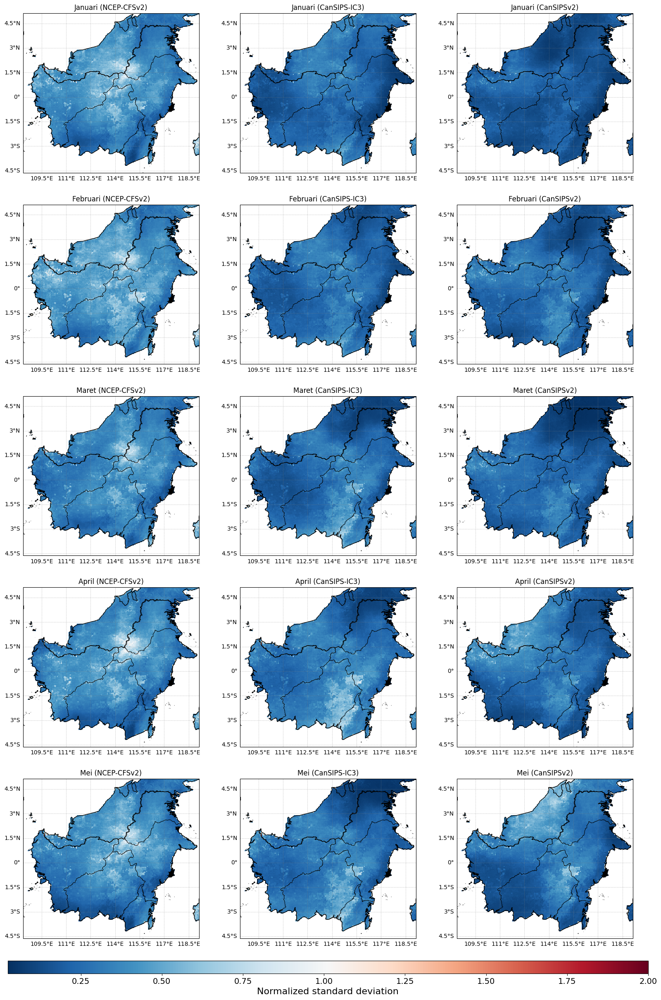

In [ ]:
import xarray as xr
import numpy as np
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import geopandas as gpd
import matplotlib.colors as mcolors


# Muat dataset hasil korelasi
correlation_dataset = xr.open_dataset('stdev_results.nc')

# Ekstrak data dari dataset
latitude = correlation_dataset.latitude.values
longitude = correlation_dataset.longitude.values
months = correlation_dataset.month.values
correlation_data = correlation_dataset.stdev.values

# Tentukan model untuk visualisasi
num_models = 3
num_months = 5
model_names = ["NCEP-CFSv2", "CanSIPS-IC3", "CanSIPSv2"]

# Buat figure dan axes untuk subplot
# fig, axes = plt.subplots(num_months, num_models, figsize=(30, 25), subplot_kw={'projection': ccrs.PlateCarree()})

# Buat figure dan axes untuk subplot dengan jarak antar subplot yang lebih kecil
fig, axes = plt.subplots(num_months, num_models, figsize=(20, 35), subplot_kw={'projection': ccrs.PlateCarree()}, 
                         gridspec_kw={'hspace': 0.2, 'wspace': 0.05})


# Load shapefile batas provinsi
shapefile_path = 'BATAS_PROVINSI_DESEMBER_2019_DUKCAPIL.shp'  # Ganti dengan path ke shapefile
gdf = gpd.read_file(shapefile_path)

# Filter shapefile sesuai dengan batas longitude dan latitude dari dataset korelasi
lon_min, lon_max = np.min(longitude), np.max(longitude)
lat_min, lat_max = np.min(latitude), np.max(latitude)
gdf = gdf.cx[lon_min:lon_max, lat_min:lat_max]

# Proyeksikan shapefile ke Plate Carree jika belum dalam format yang sesuai
gdf = gdf.to_crs(ccrs.PlateCarree().proj4_init)

# Atur warna dan batas warna
cmap = plt.cm.RdBu_r
# bounds = [0, 0.2, 0.4, 0.6, 0.8, 1, 1.2, 1.4]
# norm = mcolors.BoundaryNorm(bounds, cmap.N)
# Inisialisasi variabel untuk menyimpan nilai minimum dan maksimum RMSE
global_min_rmse = np.inf
global_max_rmse = -np.inf

# Iterasi melalui setiap bulan dan model
for i, month in enumerate(months):
    row = i % num_months
    col = i // num_months
    ax = axes[row, col]
    # Hitung nilai minimum dan maksimum RMSE untuk bulan ini
    local_min_rmse = np.nanmin(correlation_data)
    local_max_rmse = 2

    # Update nilai minimum dan maksimum global RMSE
    # global_min_rmse = min(global_min_rmse, local_min_rmse)
    # global_max_rmse = max(global_max_rmse, local_max_rmse)
    # Plot korelasi untuk setiap model dan bulan
    correlation = correlation_data[i, :, :]  # Mengambil data untuk bulan tertentu
    
    # Menambahkan data pada peta
    mesh = ax.pcolormesh(longitude, latitude, correlation, cmap=cmap, vmin=local_min_rmse, vmax=local_max_rmse, shading='auto', transform=ccrs.PlateCarree())
    
    # Menambahkan fitur geografis
    ax.add_feature(cfeature.COASTLINE)
    ax.add_feature(cfeature.BORDERS)
    ax.add_feature(cfeature.LAND, edgecolor='black')
    ax.add_feature(cfeature.OCEAN, facecolor='white')
    
    # Plot batas provinsi dari shapefile menggunakan GeoPandas
    gdf.plot(ax=ax, edgecolor='black', facecolor='none', linewidth=0.5, transform=ccrs.PlateCarree())
    # Menambahkan gridline dan label
    gl = ax.gridlines(draw_labels=True, linewidth=0.5, color='gray', alpha=0.5, linestyle='--')
    gl.top_labels = False
    gl.right_labels = False
    
    # Tambahkan label bulan dan model
    ax.set_title(f'{month} ({model_names[col]})', fontsize=12)
        
    # Set extent plot berdasarkan lon dan lat dari data korelasi
    ax.set_extent([lon_min, lon_max, lat_min, lat_max], crs=ccrs.PlateCarree())


# Sesuaikan layout subplot secara manual
plt.subplots_adjust(wspace=0.001, hspace=0.001)

# Tambahkan colorbar di bawah subplot
cbar = fig.colorbar(mesh, ax=axes.ravel().tolist(), orientation='horizontal', pad=0.02, aspect=50)
cbar.set_label('Normalized standard deviation', fontsize=16)
# Perbesar teks pada colorbar
cbar.ax.tick_params(labelsize=14)

# Sesuaikan layout dan simpan gambar
# plt.tight_layout()
# plt.savefig('correlation_maps_cartopy.png', dpi=300, bbox_inches='tight')
plt.show()

# print("Visualisasi korelasi telah disimpan ke 'correlation_maps_cartopy.png'")


In [45]:
import numpy as np
import xarray as xr

# Fungsi untuk menghitung standar deviasi
def calculate_standard_deviation(data):
    return np.std(data, ddof=1)

# Fungsi untuk menghitung korelasi
def calculate_correlation(observed, model):
    return np.corrcoef(observed, model)[0, 1]

# Fungsi untuk menghitung rasio standar deviasi
def calculate_standard_deviation_ratio(observed, model):
    sigma_o = calculate_standard_deviation(observed)
    sigma_m = calculate_standard_deviation(model)
    return sigma_m / sigma_o

# Fungsi untuk menghitung nilai S
def calculate_skill_score(observed, model, R0):
    R = calculate_correlation(observed, model)
    sigma_r = calculate_standard_deviation_ratio(observed, model)
    S = (4 * (1 + R)) / ((sigma_r + 1/sigma_r)**2 * (1 + R0))
    return S

# Muat dataset observasi
data_observasi = xr.open_dataset('AMH_with_Median.nc')
obs_var = data_observasi['AMH'].values.flatten()

# Muat dataset prediksi untuk beberapa bulan
files = [
    'PreASO_CFSJanuari.nc', 'PreASO_CFSFebruari.nc', 'PreASO_CFSMaret.nc',
    'PreASO_CFSApril.nc', 'PreASO_CFSMei.nc', 'PreASO_IC3Januari.nc',
    'PreASO_IC3Februari.nc', 'PreASO_IC3Maret.nc', 'PreASO_IC3April.nc',
    'PreASO_IC3Mei.nc', 'PreASO_Cansipv2Januari.nc', 'PreASO_Cansipv2Februari.nc',
    'PreASO_Cansipv2Maret.nc', 'PreASO_Cansipv2April.nc', 'PreASO_Cansipv2Mei.nc'
]

# Variabel yang akan digunakan dari dataset prediksi
pred_vars = []

# Baca semua dataset prediksi dan simpan variabel 'AMHp'
for file in files:
    data_prediksi = xr.open_dataset(file)
    pred_vars.append(data_prediksi['AMHp'].values.flatten())

# Nilai R0 (korelasi maksimum yang dapat dicapai)
R0 = 0.6

# Hitung nilai S untuk setiap prediksi
for i, pred_var in enumerate(pred_vars):
    S = calculate_skill_score(obs_var, pred_var, R0)
    print(f"Nilai S untuk prediksi {files[i]} adalah: {S:.4f}")


Nilai S untuk prediksi PreASO_CFSJanuari.nc adalah: 0.5791
Nilai S untuk prediksi PreASO_CFSFebruari.nc adalah: 0.5382
Nilai S untuk prediksi PreASO_CFSMaret.nc adalah: 0.5752
Nilai S untuk prediksi PreASO_CFSApril.nc adalah: 0.4900
Nilai S untuk prediksi PreASO_CFSMei.nc adalah: 0.5172
Nilai S untuk prediksi PreASO_IC3Januari.nc adalah: 0.3056
Nilai S untuk prediksi PreASO_IC3Februari.nc adalah: 0.4953
Nilai S untuk prediksi PreASO_IC3Maret.nc adalah: 0.4919
Nilai S untuk prediksi PreASO_IC3April.nc adalah: 0.4596
Nilai S untuk prediksi PreASO_IC3Mei.nc adalah: 0.4740
Nilai S untuk prediksi PreASO_Cansipv2Januari.nc adalah: 0.2642
Nilai S untuk prediksi PreASO_Cansipv2Februari.nc adalah: 0.3209
Nilai S untuk prediksi PreASO_Cansipv2Maret.nc adalah: 0.3298
Nilai S untuk prediksi PreASO_Cansipv2April.nc adalah: 0.4132
Nilai S untuk prediksi PreASO_Cansipv2Mei.nc adalah: 0.3896


In [102]:
import numpy as np
import xarray as xr

# Fungsi untuk menghitung standar deviasi
def calculate_standard_deviation(data):
    return np.std(data, ddof=1)

# Fungsi untuk menghitung korelasi
def calculate_correlation(observed, model):
    return np.corrcoef(observed, model)[0, 1]

# Fungsi untuk menghitung rasio standar deviasi
def calculate_standard_deviation_ratio(observed, model):
    sigma_o = calculate_standard_deviation(observed)
    sigma_m = calculate_standard_deviation(model)
    return sigma_m / sigma_o

# Fungsi untuk menghitung nilai S yang dimodifikasi
def calculate_skill_score_modified(observed, model, R0):
    R = calculate_correlation(observed, model)
    sigma_r = calculate_standard_deviation_ratio(observed, model)
    S = (4 * (1 + R)**4) / ((sigma_r + 1/sigma_r)**2 * (1 + R0)**4)
    return S

# Muat dataset observasi
data_observasi = xr.open_dataset('AMH_with_Median.nc')
obs_var = data_observasi['AMH']

# Muat dataset prediksi untuk beberapa bulan
files = [
    'predictedCFSJanuariFix.nc', 'predictedCFSFebruari.nc', 'predictedCFSMaret.nc',
    'predictedCFSApril.nc', 'predictedCFSMei.nc', 'predictedIC3Januari.nc',
    'predictedIC3Februari.nc', 'predictedIC3Maret.nc', 'predictedIC3April.nc',
    'predictedIC3Mei.nc', 'predictedCansipsv2Januari.nc', 'predictedCansipsv2Februari.nc',
    'predictedCansipsv2Maret.nc', 'predictedCansipsv2April.nc', 'predictedCansipsv2Mei.nc'
]

# Baca semua dataset prediksi
pred_vars = [xr.open_dataset(file)['AMHp'] for file in files]

# Nilai R0 (korelasi maksimum yang dapat dicapai)
R0 = 0.75

# Membuat array kosong untuk menyimpan nilai S
skill_scores_modified_all = []

# Looping untuk setiap grid point
for i, pred_var in enumerate(pred_vars):
    # Buat array kosong untuk menyimpan hasil per grid
    skill_scores_grid = np.full_like(obs_var[0], np.nan)  # Menggunakan dimensi grid dari obs_var

    # Looping untuk setiap grid point
    for lat in range(obs_var.shape[1]):
        for lon in range(obs_var.shape[2]):
            obs_grid = obs_var[:, lat, lon].values
            pred_grid = pred_var[:, lat, lon].values
            
            # Pastikan tidak ada NaN dalam grid sebelum perhitungan
            if not np.isnan(obs_grid).any() and not np.isnan(pred_grid).any():
                skill_scores_grid[lat, lon] = calculate_skill_score_modified(obs_grid, pred_grid, R0)
    
    # Simpan hasil untuk setiap prediksi ke dalam list
    skill_scores_modified_all.append((files[i], skill_scores_grid))

# skill_scores_modified_all akan berisi nilai S untuk setiap grid point dan file prediksi
skill_scores_modified_all


c:\Users\ASUS\AppData\Local\Programs\Python\Python312\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Users\ASUS\AppData\Local\Programs\Python\Python312\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\ASUS\AppData\Local\Temp\ipykernel_2648\3862994754.py:16: RuntimeWarning: divide by zero encountered in scalar divide
  return sigma_m / sigma_o


[('predictedCFSJanuariFix.nc',
  array([[       nan,        nan,        nan, ...,        nan,        nan,
                 nan],
         [       nan,        nan,        nan, ...,        nan,        nan,
                 nan],
         [       nan,        nan,        nan, ...,        nan,        nan,
                 nan],
         ...,
         [       nan,        nan,        nan, ...,        nan,        nan,
                 nan],
         [       nan,        nan,        nan, ..., 0.24566143, 0.34663537,
          0.37904028],
         [       nan,        nan,        nan, ..., 0.23692495, 0.20134434,
          0.36347868]])),
 ('predictedCFSFebruari.nc',
  array([[       nan,        nan,        nan, ...,        nan,        nan,
                 nan],
         [       nan,        nan,        nan, ...,        nan,        nan,
                 nan],
         [       nan,        nan,        nan, ...,        nan,        nan,
                 nan],
         ...,
         [       nan,      

In [106]:
global_max_rmse

0.996316534782739

S SCORE FIXXX

C:\Users\ASUS\AppData\Local\Temp\ipykernel_14464\948687574.py:48: RuntimeWarning: divide by zero encountered in divide
  sigma_r = np.where(sigma_o == 0, np.nan, sigma_m / sigma_o)
c:\Users\ASUS\AppData\Local\Programs\Python\Python312\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Users\ASUS\AppData\Local\Programs\Python\Python312\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


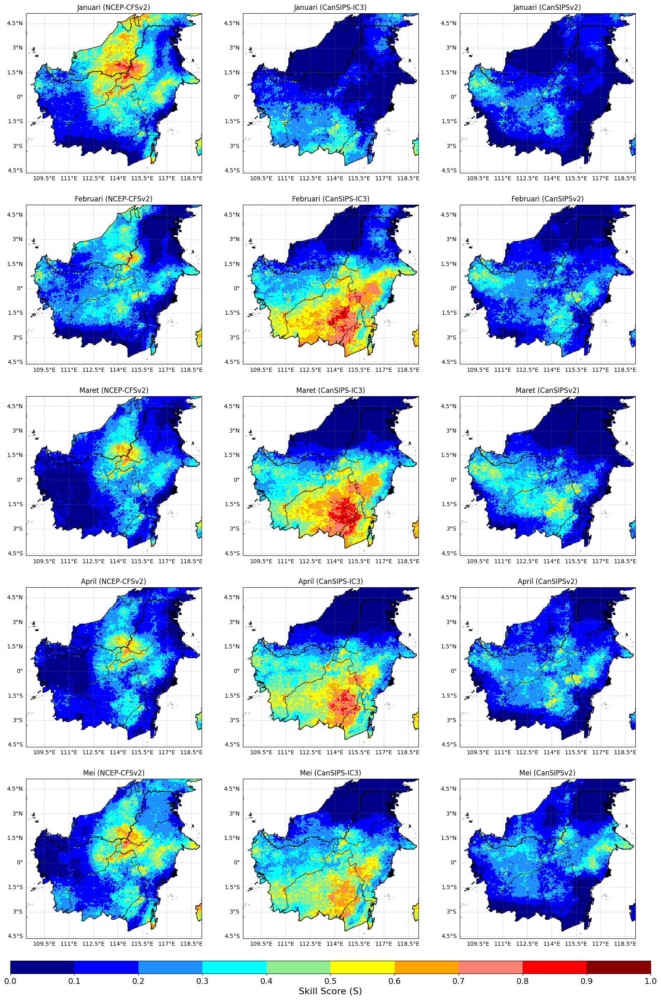

In [49]:
import xarray as xr
import numpy as np
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import geopandas as gpd

# Muat dataset observasi
data_observasi = xr.open_dataset('AMH_with_Median.nc')
obs_var = data_observasi['AMH'].values

# Muat dataset prediksi untuk beberapa bulan
data_prediksi_files = [
    'PreASO_CFSJanuari.nc', 'PreASO_CFSFebruari.nc', 'PreASO_CFSMaret.nc',
    'PreASO_CFSApril.nc', 'PreASO_CFSMei.nc', 'PreASO_IC3Januari.nc',
    'PreASO_IC3Februari.nc', 'PreASO_IC3Maret.nc', 'PreASO_IC3April.nc',
    'PreASO_IC3Mei.nc', 'PreASO_Cansipv2Januari.nc', 'PreASO_Cansipv2Februari.nc',
    'PreASO_Cansipv2Maret.nc', 'PreASO_Cansipv2April.nc', 'PreASO_Cansipv2Mei.nc'
]

# Muat variabel prediksi
pred_vars = [xr.open_dataset(f)['AMHp'].values for f in data_prediksi_files]

# Hitung nilai R_0 (korelasi maksimum)
def calculate_R0(obs, preds):
    corr_max = -np.inf
    for pred in preds:
        for i in range(obs.shape[1]):
            for j in range(obs.shape[2]):
                obs_data = obs[:, i, j]
                pred_data = pred[:, i, j]
                
                if np.all(np.isnan(obs_data)) or np.all(np.isnan(pred_data)):
                    continue
                
                corr = np.corrcoef(obs_data, pred_data)[0, 1]
                corr_max = max(corr_max, corr)
    
    return corr_max

R_0 = 0.7

# Hitung nilai S per grid point
def calculate_S_per_grid(obs, pred, R_0):
    # Hitung rasio standar deviasi per grid point
    sigma_o = np.nanstd(obs, axis=0)
    sigma_m = np.nanstd(pred, axis=0)
    sigma_r = np.where(sigma_o == 0, np.nan, sigma_m / sigma_o)

    # Hitung korelasi per grid point
    correlation_map = np.zeros((obs.shape[1], obs.shape[2]))
    for i in range(obs.shape[1]):
        for j in range(obs.shape[2]):
            obs_data = obs[:, i, j]
            pred_data = pred[:, i, j]
            
            if np.all(np.isnan(obs_data)) or np.all(np.isnan(pred_data)):
                correlation_map[i, j] = np.nan
            else:
                correlation_map[i, j] = np.corrcoef(obs_data, pred_data)[0, 1]

    # Hitung nilai S per grid point
    denominator = (sigma_r + 1 / np.where(sigma_r == 0, np.nan, sigma_r))**2 * (1 + R_0)
    S = 4 * (1 + correlation_map) / denominator
    S = np.where(S == 0, np.nan, S)

    return S

# Buat array kosong untuk menyimpan nilai S
S_maps = np.zeros((len(pred_vars), obs_var.shape[1], obs_var.shape[2]))

# Hitung nilai S untuk setiap bulan dan model
for i, pred_var in enumerate(pred_vars):
    S_maps[i] = calculate_S_per_grid(obs_var, pred_var, R_0)

# Definisikan koordinat
latitudes = data_observasi['latitude'].values
longitudes = data_observasi['longitude'].values
months = ['Januari', 'Februari', 'Maret', 'April', 'Mei'] * 3  # 5 bulan untuk 3 model

# Buat dataset xarray untuk nilai S
s_dataset = xr.Dataset(
    {
        's_value': (['month', 'latitude', 'longitude'], S_maps)
    },
    coords={
        'month': months,
        'latitude': latitudes,
        'longitude': longitudes
    }
)

# Simpan dataset ke file NetCDF
# s_dataset.to_netcdf('S_results.nc')

# Visualisasi hasilnya
# Tentukan model untuk visualisasi
num_models = 3
num_months = 5
model_names = ["NCEP-CFSv2", "CanSIPS-IC3", "CanSIPSv2"]

# Buat figure dan axes untuk subplot
fig, axes = plt.subplots(num_months, num_models, figsize=(20, 35), subplot_kw={'projection': ccrs.PlateCarree()}, 
                         gridspec_kw={'hspace': 0.2, 'wspace': 0.05})

# Atur warna dan batas warna
colors = ['darkblue', 'blue', 'dodgerblue', 'cyan', 'lightgreen', 'yellow', 'orange', 'salmon', 'red', 'darkred']
cmap = mcolors.ListedColormap(colors)
bounds = np.arange(0, 1.1, 0.1)  # Batas warna dari 0 hingga 1 dengan interval 0.1
norm = mcolors.BoundaryNorm(bounds, cmap.N)

# Load shapefile batas provinsi
shapefile_path = 'BATAS_PROVINSI_DESEMBER_2019_DUKCAPIL.shp'
gdf = gpd.read_file(shapefile_path)

# Filter shapefile sesuai dengan batas longitude dan latitude dari dataset
lon_min, lon_max = np.min(longitudes), np.max(longitudes)
lat_min, lat_max = np.min(latitudes), np.max(latitudes)
gdf = gdf.cx[lon_min:lon_max, lat_min:lat_max]
gdf = gdf.to_crs(ccrs.PlateCarree().proj4_init)

# Iterasi melalui setiap bulan dan model
for i, month in enumerate(months):
    row = i % num_months
    col = i // num_months
    ax = axes[row, col]

    # Plot nilai S untuk setiap model dan bulan
    s_value = S_maps[i, :, :]  # Mengambil data untuk bulan tertentu
    
    # Menambahkan data pada peta
    mesh = ax.pcolormesh(longitudes, latitudes, s_value, cmap=cmap, norm=norm, shading='auto', transform=ccrs.PlateCarree())
    
    # Menambahkan fitur geografis
    ax.add_feature(cfeature.COASTLINE)
    ax.add_feature(cfeature.BORDERS)
    ax.add_feature(cfeature.LAND, edgecolor='black')
    ax.add_feature(cfeature.OCEAN, facecolor='white')
    
    # Plot batas provinsi dari shapefile menggunakan GeoPandas
    gdf.plot(ax=ax, edgecolor='black', facecolor='none', linewidth=0.5, transform=ccrs.PlateCarree())
    
    # Menambahkan gridline dan label
    gl = ax.gridlines(draw_labels=True, linewidth=0.5, color='gray', alpha=0.5, linestyle='--')
    gl.top_labels = False
    gl.right_labels = False
    
    # Tambahkan label bulan dan model
    ax.set_title(f'{month} ({model_names[col]})', fontsize=12)
        
    # Set extent plot berdasarkan lon dan lat dari data S
    ax.set_extent([lon_min, lon_max, lat_min, lat_max], crs=ccrs.PlateCarree())

# Sesuaikan layout subplot secara manual
plt.subplots_adjust(wspace=0.001, hspace=0.001)

# Tambahkan colorbar di bawah subplot
cbar = fig.colorbar(mesh, ax=axes.ravel().tolist(), orientation='horizontal', pad=0.02, aspect=50, 
                    ticks=bounds)
cbar.set_label('Skill Score (S)', fontsize=16)
cbar.ax.tick_params(labelsize=14)

# Tampilkan plot
plt.show()

# print("Data S telah diproses dan divisualisasikan.")


In [47]:
global_max_s

0.9869014508526168

In [12]:
import xarray as xr
import numpy as np
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import geopandas as gpd

# Muat dataset observasi
data_observasi = xr.open_dataset('AMH_with_Median.nc')
obs_var = data_observasi['AMH'].values

# Muat dataset prediksi untuk beberapa bulan
data_prediksi_files = [
    'PreASO_CFSJanuari.nc', 'PreASO_CFSFebruari.nc', 'PreASO_CFSMaret.nc',
    'PreASO_CFSApril.nc', 'PreASO_CFSMei.nc', 'PreASO_IC3Januari.nc',
    'PreASO_IC3Februari.nc', 'PreASO_IC3Maret.nc', 'PreASO_IC3April.nc',
    'PreASO_IC3Mei.nc', 'PreASO_Cansipv2Januari.nc', 'PreASO_Cansipv2Februari.nc',
    'PreASO_Cansipv2Maret.nc', 'PreASO_Cansipv2April.nc', 'PreASO_Cansipv2Mei.nc'
]

# Muat variabel prediksi
pred_vars = [xr.open_dataset(f)['AMHp'].values for f in data_prediksi_files]

# Hitung nilai R_0 (korelasi maksimum)
def calculate_R0(obs, preds):
    corr_max = -np.inf
    for pred in preds:
        for i in range(obs.shape[1]):
            for j in range(obs.shape[2]):
                obs_data = obs[:, i, j]
                pred_data = pred[:, i, j]
                
                if np.all(np.isnan(obs_data)) or np.all(np.isnan(pred_data)):
                    continue
                
                corr = np.corrcoef(obs_data, pred_data)[0, 1]
                corr_max = max(corr_max, corr)
    
    return corr_max

R_0 = calculate_R0(obs_var, pred_vars)

# Hitung nilai S per grid point
def calculate_S_per_grid(obs, pred, R_0):
    # Hitung rasio standar deviasi per grid point
    sigma_o = np.nanstd(obs, axis=0)
    sigma_m = np.nanstd(pred, axis=0)
    sigma_r = np.where(sigma_o == 0, np.nan, sigma_m / sigma_o)

    # Hitung korelasi per grid point
    correlation_map = np.zeros((obs.shape[1], obs.shape[2]))
    for i in range(obs.shape[1]):
        for j in range(obs.shape[2]):
            obs_data = obs[:, i, j]
            pred_data = pred[:, i, j]
            
            if np.all(np.isnan(obs_data)) or np.all(np.isnan(pred_data)):
                correlation_map[i, j] = np.nan
            else:
                correlation_map[i, j] = np.corrcoef(obs_data, pred_data)[0, 1]

    # Hitung nilai S per grid point
    denominator = (sigma_r + 1 / np.where(sigma_r == 0, np.nan, sigma_r))**2 * (1 + R_0)
    S = 4 * (1 + correlation_map) / denominator
    S = np.where(S == 0, np.nan, S)

    return S

# Buat array kosong untuk menyimpan nilai S
S_maps = np.zeros((len(pred_vars), obs_var.shape[1], obs_var.shape[2]))

# Hitung nilai S untuk setiap bulan dan model
for i, pred_var in enumerate(pred_vars):
    S_maps[i] = calculate_S_per_grid(obs_var, pred_var, R_0)

# Definisikan koordinat
latitudes = data_observasi['latitude'].values
longitudes = data_observasi['longitude'].values
months = ['Januari', 'Februari', 'Maret', 'April', 'Mei'] * 3  # 5 bulan untuk 3 model

# Buat dataset xarray untuk nilai S
s_dataset = xr.Dataset(
    {
        's_value': (['month', 'latitude', 'longitude'], S_maps)
    },
    coords={
        'month': months,
        'latitude': latitudes,
        'longitude': longitudes
    }
)

# Simpan dataset ke file NetCDF
# s_dataset.to_netcdf('S_results.nc')

c:\Users\ASUS\AppData\Local\Programs\Python\Python312\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
c:\Users\ASUS\AppData\Local\Programs\Python\Python312\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\ASUS\AppData\Local\Temp\ipykernel_14464\4213835958.py:48: RuntimeWarning: divide by zero encountered in divide
  sigma_r = np.where(sigma_o == 0, np.nan, sigma_m / sigma_o)


In [13]:
R_0

0.8649161982950635

In [14]:
# Simpan dataset ke file NetCDF
s_dataset.to_netcdf('S_results_ASO.nc')

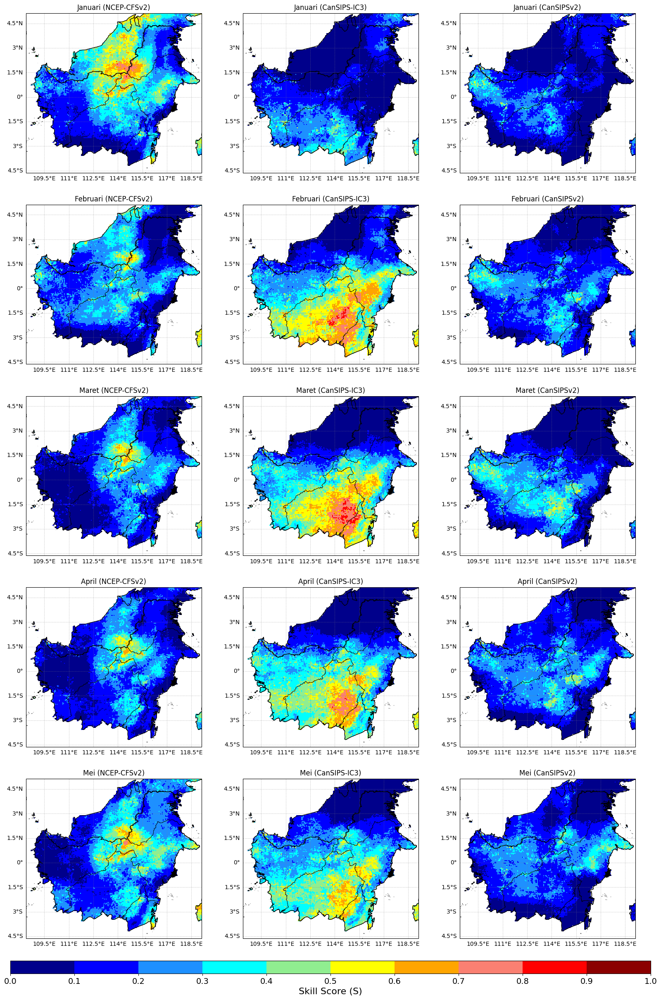

In [35]:
import matplotlib.colors as mcolors
import xarray as xr
import numpy as np
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import geopandas as gpd

correlation_dataset = xr.open_dataset('S_results_ASO.nc')

# Ekstrak data dari dataset
latitudes = correlation_dataset.latitude.values
longitudes = correlation_dataset.longitude.values
months = correlation_dataset.month.values
correlation_data = correlation_dataset.s_value.values


# Visualisasi hasilnya
# Tentukan model untuk visualisasi
num_models = 3
num_months = 5
model_names = ["NCEP-CFSv2", "CanSIPS-IC3", "CanSIPSv2"]

# Buat figure dan axes untuk subplot
fig, axes = plt.subplots(num_months, num_models, figsize=(20, 35), subplot_kw={'projection': ccrs.PlateCarree()}, 
                         gridspec_kw={'hspace': 0.2, 'wspace': 0.05})

# Atur batas warna per 0.1
colors = ['darkblue', 'blue', 'dodgerblue', 'cyan', 'lightgreen', 'yellow', 'orange', 'salmon', 'red', 'darkred']
cmap = mcolors.ListedColormap(colors)
bounds = np.arange(0, 1.1, 0.1)  # Batas warna dari 0 hingga 1 dengan interval 0.1
norm = mcolors.BoundaryNorm(bounds, cmap.N)

# Load shapefile batas provinsi
shapefile_path = 'BATAS_PROVINSI_DESEMBER_2019_DUKCAPIL.shp'
gdf = gpd.read_file(shapefile_path)

# Filter shapefile sesuai dengan batas longitude dan latitude dari dataset
lon_min, lon_max = np.min(longitudes), np.max(longitudes)
lat_min, lat_max = np.min(latitudes), np.max(latitudes)
gdf = gdf.cx[lon_min:lon_max, lat_min:lat_max]
gdf = gdf.to_crs(ccrs.PlateCarree().proj4_init)

# Iterasi melalui setiap bulan dan model
for i, month in enumerate(months):
    row = i % num_months
    col = i // num_months
    ax = axes[row, col]

    # Plot nilai S untuk setiap model dan bulana
    s_value = correlation_data[i, :, :]  # Mengambil data untuk bulan tertentu
    
    # Menambahkan data pada peta
    mesh = ax.pcolormesh(longitudes, latitudes, s_value, cmap=cmap, norm=norm, shading='auto', transform=ccrs.PlateCarree())
    
    # Menambahkan fitur geografis
    ax.add_feature(cfeature.COASTLINE)
    ax.add_feature(cfeature.BORDERS)
    ax.add_feature(cfeature.LAND, edgecolor='black')
    ax.add_feature(cfeature.OCEAN, facecolor='white')
    
    # Plot batas provinsi dari shapefile menggunakan GeoPandas
    gdf.plot(ax=ax, edgecolor='black', facecolor='none', linewidth=0.5, transform=ccrs.PlateCarree())
    
    # Menambahkan gridline dan label
    gl = ax.gridlines(draw_labels=True, linewidth=0.5, color='gray', alpha=0.5, linestyle='--')
    gl.top_labels = False
    gl.right_labels = False
    
    # Tambahkan label bulan dan model
    ax.set_title(f'{month} ({model_names[col]})', fontsize=12)
        
    # Set extent plot berdasarkan lon dan lat dari data S
    ax.set_extent([lon_min, lon_max, lat_min, lat_max], crs=ccrs.PlateCarree())

# Sesuaikan layout subplot secara manual
plt.subplots_adjust(wspace=0.001, hspace=0.001)

# Tambahkan colorbar di bawah subplot dengan batasan per 0.1
cbar = fig.colorbar(mesh, ax=axes.ravel().tolist(), orientation='horizontal', pad=0.02, aspect=50, 
                    ticks=bounds)
cbar.set_label('Skill Score (S)', fontsize=16)
cbar.ax.tick_params(labelsize=14)

# Tampilkan plot
plt.show()


In [38]:
# Inisialisasi array untuk menyimpan rata-rata skill score untuk setiap model dan bulan
mean_s_values_per_model_month = np.zeros((num_models, num_months))

# Iterasi melalui setiap model dan bulan untuk menghitung rata-rata skill score
for col in range(num_models):
    for row in range(num_months):
        # Ambil data S untuk model tertentu dan bulan tertentu
        s_value = correlation_data[col*num_months + row, :, :]
        
        # Cek apakah seluruh nilai di bulan dan model ini adalah NaN
        if np.isnan(s_value).all():
            print(f"Semua nilai NaN untuk model {model_names[col]} bulan {months[row]}")
            mean_s_values_per_model_month[col, row] = np.nan  # Atur sebagai NaN jika semua nilai NaN
        else:
            # Hitung rata-rata skill score untuk kombinasi model dan bulan ini, mengabaikan NaN
            mean_s_values_per_model_month[col, row] = np.nanmean(s_value)

# Tampilkan hasil rata-rata skill score untuk setiap model dan setiap bulan
for col in range(num_models):
    print(f"\nRata-rata Skill Score untuk {model_names[col]}:")
    for row in range(num_months):
        if np.isnan(mean_s_values_per_model_month[col, row]):
            print(f"  Bulan {months[row]}: NaN (tidak ada data valid)")
        else:
            print(f"  Bulan {months[row]}: {mean_s_values_per_model_month[col, row]:.3f}")



Rata-rata Skill Score untuk NCEP-CFSv2:
  Bulan Januari: 0.287
  Bulan Februari: 0.206
  Bulan Maret: 0.180
  Bulan April: 0.176
  Bulan Mei: 0.244

Rata-rata Skill Score untuk CanSIPS-IC3:
  Bulan Januari: 0.140
  Bulan Februari: 0.330
  Bulan Maret: 0.304
  Bulan April: 0.290
  Bulan Mei: 0.281

Rata-rata Skill Score untuk CanSIPSv2:
  Bulan Januari: 0.124
  Bulan Februari: 0.169
  Bulan Maret: 0.168
  Bulan April: 0.174
  Bulan Mei: 0.163
